# Convex Hull Plotting on 5 cascades data

Function Definitions

In [17]:
def get_3d_coords(dict_name, only_vacancies):
    coords_3d = []
    for cascade in dict_name['data']:
        if(only_vacancies == 1):
            a = [[c[0],c[1],c[2]] for c in cascade['coords'] if (c[3]==0 and c[5]==1)]
        else:
            a = [[c[0],c[1],c[2]] for c in cascade['coords']]
        coords_3d.append(a)
    return coords_3d



def get_2d_coords(dict_name, only_vacancies):
    coords_2d = []
    for cascade in dict_name['data']:
        if(only_vacancies == 1):
            a = [[c[0],c[1]] for c in cascade['coords'] if (c[3]==0 and c[5]==1)]
        else:
            a = [[c[0],c[1]] for c in cascade['coords']]
        coords_2d.append(a)
    return coords_2d



def show_warning(message): ## Used in add_hull_and_extra_features_to_dict function
    import tkinter as tk
    root = tk.Tk()
    root.title("WARNING")
    root.geometry("700x100+370+100")
    w = tk.Label(root, text=message)
    w. place(relx=0.0, rely=1.0, anchor='sw')
    w.pack()
    root.mainloop()
    
    
    
def dclust_coords_exists_or_not(filename): ## Used in add_hull_and_extra_features_to_dict function
    import json
    with open(filename, 'r') as f:
        dict_name = json.loads(f.read())
    for key in dict_name['data'][0].keys():
        if(key == 'dclust_coords'):
            return 1
    return 0


area_array=[]
volume_array=[]
density_array=[]
no_of_indices_array=[]
subcascades_count_array=[]
energies=[]
elements=[]
def add_hull_and_extra_features_to_dict(filename): ## Used in get_data function ## ALWAYS EXECUTE THIS FUNCTION (IMP. PREREQUISITE) 
    import json
    import numpy as np
    from scipy.spatial import ConvexHull
    
    with open(filename, 'r') as f:
        dict_name = json.loads(f.read()) #data becomes a dictionary

    ## Checks whether file data contains 'dclust_coords' as key or not for subcascades_count key generation
    subcascade=dclust_coords_exists_or_not(filename)
    
    ## To get 3d coordinates of vacancies from dictionary
    coords_3d = get_3d_coords(dict_name,1)
    for i,cascade in enumerate(dict_name['data']):
        ## Points type-casting
        pts = np.array(coords_3d[i], np.float)
        if (len(pts) < 4):
            ## Shows warning if points in a cascade are < 4
            show_warning("Number of points in cascade "+str(i)+" is less than 4.\nSo, kindly don't run plotting function calls for this cascade as it will rise an error.")
            cascade['hull_vertices'] = 0
            cascade['hull_simplices'] = [ch.simplices.tolist()]
            cascade['hull_nvertices'] = 0
            cascade['hull_nsimplices'] = 0
            cascade['hull_neighbors'] = [ch.neighbors.tolist()]
            #cascade['hull_max_bound'] = ch.max_bound.tolist()
            #cascade['hull_min_bound'] = ch.min_bound.tolist()
            cascade['hull_area'] = 0.0
            cascade['hull_volume'] = 0.0
            cascade['hull_density'] = 0.0
            cascade['hull_no_of_indices']=0
            ## Checks whether file data contains 'dclust_coords' as key or not for subcascades_count key generation
            if(subcascade==1):
                cascade['subcascades_count']=len(dict_name['data'][i]['dclust_coords'].keys())
        else:
            ## Convex hull generation
            ch = ConvexHull(pts)
            cascade['hull_vertices'] = ch.vertices.tolist()
            cascade['hull_simplices'] = ch.simplices.tolist()
            cascade['hull_nvertices'] = len(ch.vertices)
            cascade['hull_nsimplices'] = ch.nsimplex
            cascade['hull_neighbors'] = ch.neighbors.tolist()
            #cascade['hull_max_bound'] = ch.max_bound.tolist()
            #cascade['hull_min_bound'] = ch.min_bound.tolist()
            cascade['hull_area'] =ch.area
            cascade['hull_volume'] = ch.volume
            cascade['hull_density'] = dict_name['data'][i]['n_defects']/ch.volume
            cascade['hull_no_of_indices']=len(ch.vertices)
            ## Checks whether file data contains 'dclust_coords' as key or not for subcascades_count key generation
            if(subcascade==1):
                cascade['subcascades_count']=len(dict_name['data'][i]['dclust_coords'].keys())
                
    ## To make changes to original file
    with open(filename, 'w') as f:
        f.write(json.dumps(dict_name, indent=4, separators=(',', ': ')))
    
    
    ## To create arrays which are helpful in plotting
    for i,cascade in enumerate(dict_name['data']):
        ## Area array generation
        area_array.append(cascade['hull_area'])

        ## Volume array generation
        volume_array.append(cascade['hull_volume'])

        ## Density array generation
        density_array.append(cascade['hull_density'])

        ## Hull indices generation
        no_of_indices_array.append(cascade['hull_no_of_indices'])
        
        ## Subcascades count array generation
        ## Checks whether file data contains 'dclust_coords' as key or not for subcascades_count key generation
        if(subcascade==1):
            subcascades_count_array.append(cascade['subcascades_count'])
                
        ## Energy array generation
        energies.append(cascade['energy'])
        
        ## Element array generation
        elements.append(cascade['substrate'])
        
            
    ## Areas of all cascades
    #print("Areas")
    #print(area_array)
    #print(len(area_array))
    #print()

    ## Volumes of all cascades
    #print("Volumes")
    #print(volume_array)
    #print(len(volume_array))
    #print()

    ## Densities of all cascades
    #print("Densities")
    #print(density_array)
    #print(len(density_array))
    #print()

    ## No. of indices of all cascades 
    #print("No. of indices")
    #print(len(no_of_indices_array))
    #print(no_of_indices_array)
    #print()
    
    ## Subcascades of all cascades ## To print subcascades remove comments for below 8 lines
    #count=0
    #for val in subcascades_count_array:
        #if(val==0):
            #count=count+1
    #if(count!=len(subcascades_count_array)):
        #print("Subcascades")
        #print(len(subcascades_count_array))
        #print(subcascades_count_array)
        #print()
        
    ## Energies of all cascades
    #print("Energies")
    #print(energies)
    #print(len(energies))
    #print()
    
    ## Elements of all cascades
    #print("Elements")
    #print(elements)
    #print(len(elements))
    #print()



def get_data(filename): 
    ## Adds extra features to file for more flexibility in coding
    ## Input/s = data file
    add_hull_and_extra_features_to_dict(filename)
    
    import json
    from pathlib import Path
    
    fname = filename
    out_fname = Path(fname).stem + ".js"
    f = open(fname, "r+")
    cascades = json.load(f)
    f.close()
    return cascades



def plot_2d_convex_hull(dict_name, cascade_no, with_2d_or_3d_points):
    from scipy.spatial import ConvexHull, convex_hull_plot_2d
    import numpy as np
    %matplotlib notebook
    #%matplotlib qt5
    import matplotlib.pyplot as plt
    if(with_2d_or_3d_points == 2):
        ## To get 2d coordinates of vacancies from dictionary 
        coords = get_2d_coords(dict_name,1)
    if(with_2d_or_3d_points == 3):
        ## To get 3d coordinates of vacancies from dictionary
        coords = get_3d_coords(dict_name,1)
    else:
       ## To get 2d coordinates of vacancies from dictionary as default
        coords = get_2d_coords(dict_name,1) 
    points = np.array(coords[cascade_no], np.float)
    hull = ConvexHull(points)

    plt.plot(points[:,0], points[:,1], 'o')
    for simplex in hull.simplices:
        plt.plot(points[simplex, 0], points[simplex, 1], 'k-')
        
        

def plot_scatter_3d_convex_hull(dict_name, cascade_no):
    import plotly
    import numpy as np
    from scipy.spatial import ConvexHull
    %matplotlib notebook
    #%matplotlib qt5
    import matplotlib.pyplot as plt
    from mpl_toolkits.mplot3d import Axes3D
    
    ## To get 3d coordinates of vacancies from dictionary
    coords_3d = get_3d_coords(dict_name,1)
    ## Points type-casting
    pts = np.array(coords_3d[cascade_no], np.float)

    ## Convex hull generation
    ch = ConvexHull(pts)
    
    #print("hull area")
    #print(ch.area)
    #print("hull volume")
    #print(ch.volume)
    #print("hull density")
    #print(dict_name['data'][cascade_no]['n_defects']/ch.volume)
    #print("hull vertices")
    #print(ch.vertices)
    #print("hull simplices")
    #print(ch.simplices)
    #print("hull nvertices")
    #print(len(ch.vertices))
    #print("hull nsimplices")
    #print(ch.nsimplex)
    #print("hull neighbors")
    #print(ch.neighbors)

    # hull_indices = ch.vertices   ## This will work in the scipy 0.13
    hull_indices = np.unique(ch.simplices.flat)
    hull_pts = pts[hull_indices, :]
    #print("hull indices")
    #print(hull_indices)
    #print("hull pts")
    #print(hull_pts)

    ## Import dependencies for plotting
    import plotly
    import plotly.graph_objs as go

    ## Configure Plotly to be rendered inline in the notebook.
    plotly.offline.init_notebook_mode()
    data1=[]

    ## Hull points plotting
    X = [x[0] for x in hull_pts]
    Y = [x[1] for x in hull_pts]
    Z = [x[2] for x in hull_pts]
    data1.append(dict(
        name = 'Hull Points',
        showlegend = True,
        type='scatter3d',
        mode='markers',
        x=X,
        y=Y,
        z=Z,
        marker=dict(
        color='#1f77b4', #muted blue
        size=10,
        symbol='circle', #no diff
        line=dict(
            color='rgb(204, 204, 204)', #circle surrounding grey line, overlapping more clear
            width=1
        ),
        opacity=0.8
    )
    ))

    ## Non hull points plotting
    ar= [i for i in range(0, len(pts))]   
    res = list(set(ar)^set(hull_indices))
    X = [pts[x][0] for x in res]
    Y = [pts[x][1] for x in res]
    Z = [pts[x][2] for x in res]
    data1.append(dict(
        name = 'Non-Hull Points',
        showlegend = True,
        type='scatter3d',
        mode='markers',
        x=X,
        y=Y,
        z=Z,
        marker=dict(
        color='#ff7f0e',  # safety orange
        size=5,
        line=dict(
            color='rgb(204, 204, 204)', #circle surrounding grey line, overlapping more clear
            width=1
        ),
        opacity=0.8
    )
    ))

    ## Plotting of lines between convex hull points
    for simplex in ch.simplices:
        data1.append(dict(
            name = 'Lines',
            showlegend = False,
            type='scatter3d',
            mode='lines',
            x=pts[simplex, 0],
            y=pts[simplex, 1],
            z=pts[simplex, 2],
            line=dict(
                color='rgb(127, 127, 127)', #grey colors lines
                #color='rgba(217, 217, 217, 0.14)', #white color lines
                #color='black', #black color lines
                width=3
            ),
            opacity=0.8
        )
        )

    layout = go.Layout(
        margin=dict(
            l=0,
            r=0,
            b=0,
            t=0
        )
    )

    fig = dict(data=data1, layout=layout)
    plotly.offline.iplot(fig)

    

def plot_mesh_3d_convex_hull(dict_name, cascade_no):    
    import numpy as np
    from scipy.spatial import ConvexHull
    %matplotlib notebook
    #%matplotlib qt5
    import matplotlib.pyplot as plt
    from mpl_toolkits.mplot3d import Axes3D

    ## To get 3d coordinates of vacancies from dictionary
    coords_3d = get_3d_coords(dict_name,1)
    ## Points type-casting
    pts = np.array(coords_3d[cascade_no], np.float)

    ## Convex hull generation
    ch = ConvexHull(pts)
    
    #print("hull area")
    #print(ch.area)
    #print("hull volume")
    #print(ch.volume)
    #print("hull density")
    #print(dict_name['data'][cascade_no]['n_defects']/ch.volume)
    #print("hull vertices")
    #print(ch.vertices)
    #print("hull simplices")
    #print(ch.simplices)
    #print("hull nvertices")
    #print(len(ch.vertices))
    #print("hull nsimplices")
    #print(ch.nsimplex)
    #print("hull neighbors")
    #print(ch.neighbors)

    # hull_indices = ch.vertices   # This will work in the scipy 0.13
    hull_indices = np.unique(ch.simplices.flat)
    hull_pts = pts[hull_indices, :]
    #print("hull indices")
    #print(hull_indices)
    #print("hull pts")
    #print(hull_pts)

    X = [x[0] for x in pts]
    Y = [x[1] for x in pts]
    Z = [x[2] for x in pts]
    I = [x[0] for x in ch.simplices]
    J = [x[1] for x in ch.simplices]
    K = [x[2] for x in ch.simplices]
   
    ## Import dependencies for plotting
    import plotly
    import plotly.graph_objs as go

    # Configure Plotly to be rendered inline in the notebook.
    plotly.offline.init_notebook_mode()

    # Configure the trace.
    trace = go.Mesh3d(
        x=X,  
        y=Y,  
        z=Z,
        i = I,
        j = J,
        k = K,
        opacity=0.5,
        color='#00FFFF'
    )

    # Configure the layout.
    layout = go.Layout(
        margin={'l': 0, 'r': 0, 'b': 0, 't': 0}
    )

    data = [trace]

    plot_figure = go.Figure(data=data, layout=layout)

    # Render the plot.
    plotly.offline.iplot(plot_figure)
    

Function Calls / User Code

### _Basic & Convex Hull Visualization_

#_To read file and get data_

In [ ]:
## Must execute this function call as it is necessary for other calls (indirect interdependency) - COMPULSORY EXECUTION
## To get data from json file and store as dictionary  'cascadesf'
## Input/s = data file
cascades = get_data("cascades-data.json")



#_To get Coordinates_

In [6]:
## To get only the 3D coordinates from dictionary previously created and store it as array list
## Input/s = dictionary name, to get vacancies or not (1/0 - gives both vacancies and interstials) [PREFERABLY 1]
coords_3d = get_3d_coords(cascades,1)
#print(len(coords_3d[0]))
#print(coords_3d)

## To get only the 2D coordinates from dictionary previously created and store it as array list
## Input/s = dictionary name, to get vacancies or not (1/0 - gives both vacancies and interstials) [PREFERABLY 1]
coords_2d = get_2d_coords(cascades,1)
#print(len(coords_2d[0]))
#print(coords_2d)

#_2D Plotting_

<IPython.core.display.Javascript object>


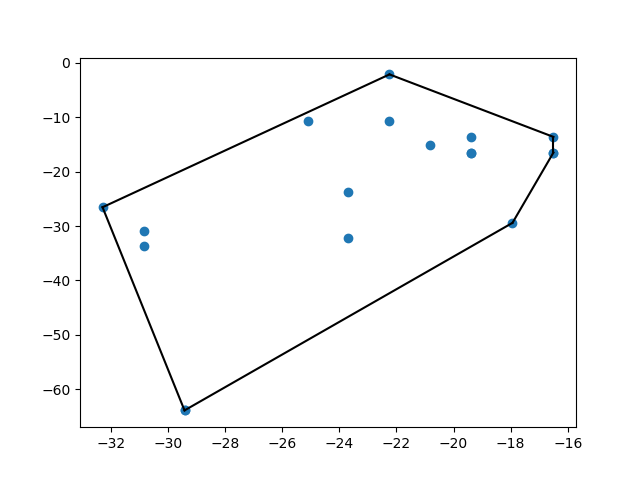

In [7]:
## To plot 2D convex hull
## Input/s = dictionary name, cascade number, coordinates dimension (2/3) [PREFERABLY 2]
plot_2d_convex_hull(cascades, 0, 2)
## Must press QUIT (TO STOP INTERACTION) button after analysis else effects other plots especially the next one


#_3D Plotting_

In [10]:
## Plots scatter 3d convex hull
## Input/s = dictionary name, cascade number
plot_scatter_3d_convex_hull(cascades,0)

In [20]:
## Plots mesh 3d convex hull 
## Input/s = dictionary name, cascade number
plot_mesh_3d_convex_hull(cascades,0)

# Convex Hull on 76 cascades data (full)

### _Basic & Convex Hull Visualization_

Function Definitions

In [1]:
def get_3d_coords(dict_name, only_vacancies):
    coords_3d = []
    for cascade in dict_name['data']:
        if(only_vacancies == 1):
            a = [[c[0],c[1],c[2]] for c in cascade['coords'] if (c[3]==0 and c[5]==1)]
        else:
            a = [[c[0],c[1],c[2]] for c in cascade['coords']]
        coords_3d.append(a)
    return coords_3d



def get_2d_coords(dict_name, only_vacancies):
    coords_2d = []
    for cascade in dict_name['data']:
        if(only_vacancies == 1):
            a = [[c[0],c[1]] for c in cascade['coords'] if (c[3]==0 and c[5]==1)]
        else:
            a = [[c[0],c[1]] for c in cascade['coords']]
        coords_2d.append(a)
    return coords_2d



def show_warning(message): ## Used in add_hull_and_extra_features_to_dict function
    import tkinter as tk
    root = tk.Tk()
    root.title("WARNING")
    root.geometry("700x100+370+100")
    w = tk.Label(root, text=message)
    w. place(relx=0.0, rely=1.0, anchor='sw')
    w.pack()
    root.mainloop()
    
    
    
def dclust_coords_exists_or_not(filename): ## Used in add_hull_and_extra_features_to_dict function
    import json
    with open(filename, 'r') as f:
        dict_name = json.loads(f.read())
    for key in dict_name['data'][0].keys():
        if(key == 'dclust_coords'):
            return 1
    return 0


area_array=[]
volume_array=[]
density_array=[]
no_of_indices_array=[]
subcascades_count_array=[]
energies=[]
elements=[]
def add_hull_and_extra_features_to_dict(filename): ## Used in get_data function ## ALWAYS EXECUTE THIS FUNCTION (IMP. PREREQUISITE) 
    import json
    import numpy as np
    from scipy.spatial import ConvexHull
    
    with open(filename, 'r') as f:
        dict_name = json.loads(f.read()) #data becomes a dictionary

    ## Checks whether file data contains 'dclust_coords' as key or not for subcascades_count key generation
    subcascade=dclust_coords_exists_or_not(filename)
    
    ## To get 3d coordinates of vacancies from dictionary
    coords_3d = get_3d_coords(dict_name,1)
    for i,cascade in enumerate(dict_name['data']):
        ## Points type-casting
        pts = np.array(coords_3d[i], np.float)
        if (len(pts) < 4):
            ## Shows warning if points in a cascade are < 4
            show_warning("Number of points in cascade "+str(i)+" is less than 4.\nSo, kindly don't run plotting function calls for this cascade as it will rise an error.")
            cascade['hull_vertices'] = 0
            cascade['hull_simplices'] = [ch.simplices.tolist()]
            cascade['hull_nvertices'] = 0
            cascade['hull_nsimplices'] = 0
            cascade['hull_neighbors'] = [ch.neighbors.tolist()]
            #cascade['hull_max_bound'] = ch.max_bound.tolist()
            #cascade['hull_min_bound'] = ch.min_bound.tolist()
            cascade['hull_area'] = 0.0
            cascade['hull_volume'] = 0.0
            cascade['hull_density'] = 0.0
            cascade['hull_no_of_indices']=0
            ## Checks whether file data contains 'dclust_coords' as key or not for subcascades_count key generation
            if(subcascade==1):
                cascade['subcascades_count']=len(dict_name['data'][i]['dclust_coords'].keys())
        else:
            ## Convex hull generation
            ch = ConvexHull(pts)
            cascade['hull_vertices'] = ch.vertices.tolist()
            cascade['hull_simplices'] = ch.simplices.tolist()
            cascade['hull_nvertices'] = len(ch.vertices)
            cascade['hull_nsimplices'] = ch.nsimplex
            cascade['hull_neighbors'] = ch.neighbors.tolist()
            #cascade['hull_max_bound'] = ch.max_bound.tolist()
            #cascade['hull_min_bound'] = ch.min_bound.tolist()
            cascade['hull_area'] =ch.area
            cascade['hull_volume'] = ch.volume
            cascade['hull_density'] = dict_name['data'][i]['n_defects']/ch.volume
            cascade['hull_no_of_indices']=len(ch.vertices)
            ## Checks whether file data contains 'dclust_coords' as key or not for subcascades_count key generation
            if(subcascade==1):
                cascade['subcascades_count']=len(dict_name['data'][i]['dclust_coords'].keys())
                
    ## To make changes to original file
    with open(filename, 'w') as f:
        f.write(json.dumps(dict_name, indent=4, separators=(',', ': ')))
    
    
    ## To create arrays which are helpful in plotting
    for i,cascade in enumerate(dict_name['data']):
        ## Area array generation
        area_array.append(cascade['hull_area'])

        ## Volume array generation
        volume_array.append(cascade['hull_volume'])

        ## Density array generation
        density_array.append(cascade['hull_density'])

        ## Hull indices generation
        no_of_indices_array.append(cascade['hull_no_of_indices'])
        
        ## Subcascades count array generation
        ## Checks whether file data contains 'dclust_coords' as key or not for subcascades_count key generation
        if(subcascade==1):
            subcascades_count_array.append(cascade['subcascades_count'])
                
        ## Energy array generation
        energies.append(cascade['energy'])
        
        ## Element array generation
        elements.append(cascade['substrate'])
        
            
    ## Areas of all cascades
    #print("Areas")
    #print(area_array)
    #print(len(area_array))
    #print()

    ## Volumes of all cascades
    #print("Volumes")
    #print(volume_array)
    #print(len(volume_array))
    #print()

    ## Densities of all cascades
    #print("Densities")
    #print(density_array)
    #print(len(density_array))
    #print()

    ## No. of indices of all cascades 
    #print("No. of indices")
    #print(len(no_of_indices_array))
    #print(no_of_indices_array)
    #print()
    
    ## Subcascades of all cascades ## To print subcascades remove comments for below 8 lines
    #count=0
    #for val in subcascades_count_array:
        #if(val==0):
            #count=count+1
    #if(count!=len(subcascades_count_array)):
        #print("Subcascades")
        #print(len(subcascades_count_array))
        #print(subcascades_count_array)
        #print()
        
    ## Energies of all cascades
    #print("Energies")
    #print(energies)
    #print(len(energies))
    #print()
    
    ## Elements of all cascades
    #print("Elements")
    #print(elements)
    #print(len(elements))
    #print()



def get_data(filename): 
    ## Adds extra features to file for more flexibility in coding
    ## Input/s = data file
    add_hull_and_extra_features_to_dict(filename)
    
    import json
    from pathlib import Path
    
    fname = filename
    out_fname = Path(fname).stem + ".js"
    f = open(fname, "r+")
    cascades = json.load(f)
    f.close()
    return cascades



def plot_2d_convex_hull(dict_name, cascade_no, with_2d_or_3d_points):
    from scipy.spatial import ConvexHull, convex_hull_plot_2d
    import numpy as np
    %matplotlib notebook
    #%matplotlib qt5
    import matplotlib.pyplot as plt
    if(with_2d_or_3d_points == 2):
        ## To get 2d coordinates of vacancies from dictionary 
        coords = get_2d_coords(dict_name,1)
    if(with_2d_or_3d_points == 3):
        ## To get 3d coordinates of vacancies from dictionary
        coords = get_3d_coords(dict_name,1)
    else:
       ## To get 2d coordinates of vacancies from dictionary as default
        coords = get_2d_coords(dict_name,1) 
    points = np.array(coords[cascade_no], np.float)
    hull = ConvexHull(points)

    plt.plot(points[:,0], points[:,1], 'o')
    for simplex in hull.simplices:
        plt.plot(points[simplex, 0], points[simplex, 1], 'k-')
        
        

def plot_scatter_3d_convex_hull(dict_name, cascade_no):
    import plotly
    import numpy as np
    from scipy.spatial import ConvexHull
    %matplotlib notebook
    #%matplotlib qt5
    import matplotlib.pyplot as plt
    from mpl_toolkits.mplot3d import Axes3D
    
    ## To get 3d coordinates of vacancies from dictionary
    coords_3d = get_3d_coords(dict_name,1)
    ## Points type-casting
    pts = np.array(coords_3d[cascade_no], np.float)

    ## Convex hull generation
    ch = ConvexHull(pts)
    
    #print("hull area")
    #print(ch.area)
    #print("hull volume")
    #print(ch.volume)
    #print("hull density")
    #print(dict_name['data'][cascade_no]['n_defects']/ch.volume)
    #print("hull vertices")
    #print(ch.vertices)
    #print("hull simplices")
    #print(ch.simplices)
    #print("hull nvertices")
    #print(len(ch.vertices))
    #print("hull nsimplices")
    #print(ch.nsimplex)
    #print("hull neighbors")
    #print(ch.neighbors)

    # hull_indices = ch.vertices   ## This will work in the scipy 0.13
    hull_indices = np.unique(ch.simplices.flat)
    hull_pts = pts[hull_indices, :]
    #print("hull indices")
    #print(hull_indices)
    #print("hull pts")
    #print(hull_pts)

    ## Import dependencies for plotting
    import plotly
    import plotly.graph_objs as go

    ## Configure Plotly to be rendered inline in the notebook.
    plotly.offline.init_notebook_mode()
    data1=[]

    ## Hull points plotting
    X = [x[0] for x in hull_pts]
    Y = [x[1] for x in hull_pts]
    Z = [x[2] for x in hull_pts]
    data1.append(dict(
        name = 'Hull Points',
        showlegend = True,
        type='scatter3d',
        mode='markers',
        x=X,
        y=Y,
        z=Z,
        marker=dict(
        color='#1f77b4', #muted blue
        size=10,
        symbol='circle', #no diff
        line=dict(
            color='rgb(204, 204, 204)', #circle surrounding grey line, overlapping more clear
            width=1
        ),
        opacity=0.8
    )
    ))

    ## Non hull points plotting
    ar= [i for i in range(0, len(pts))]   
    res = list(set(ar)^set(hull_indices))
    X = [pts[x][0] for x in res]
    Y = [pts[x][1] for x in res]
    Z = [pts[x][2] for x in res]
    data1.append(dict(
        name = 'Non-Hull Points',
        showlegend = True,
        type='scatter3d',
        mode='markers',
        x=X,
        y=Y,
        z=Z,
        marker=dict(
        color='#ff7f0e',  # safety orange
        size=5,
        line=dict(
            color='rgb(204, 204, 204)', #circle surrounding grey line, overlapping more clear
            width=1
        ),
        opacity=0.8
    )
    ))

    ## Plotting of lines between convex hull points
    for simplex in ch.simplices:
        data1.append(dict(
            name = 'Lines',
            showlegend = False,
            type='scatter3d',
            mode='lines',
            x=pts[simplex, 0],
            y=pts[simplex, 1],
            z=pts[simplex, 2],
            line=dict(
                color='rgb(127, 127, 127)', #grey colors lines
                #color='rgba(217, 217, 217, 0.14)', #white color lines
                #color='black', #black color lines
                width=3
            ),
            opacity=0.8
        )
        )

    layout = go.Layout(
        margin=dict(
            l=0,
            r=0,
            b=0,
            t=0
        )
    )

    fig = dict(data=data1, layout=layout)
    plotly.offline.iplot(fig)

    

def plot_mesh_3d_convex_hull(dict_name, cascade_no):    
    import numpy as np
    from scipy.spatial import ConvexHull
    %matplotlib notebook
    #%matplotlib qt5
    import matplotlib.pyplot as plt
    from mpl_toolkits.mplot3d import Axes3D

    ## To get 3d coordinates of vacancies from dictionary
    coords_3d = get_3d_coords(dict_name,1)
    ## Points type-casting
    pts = np.array(coords_3d[cascade_no], np.float)

    ## Convex hull generation
    ch = ConvexHull(pts)
    
    #print("hull area")
    #print(ch.area)
    #print("hull volume")
    #print(ch.volume)
    #print("hull density")
    #print(dict_name['data'][cascade_no]['n_defects']/ch.volume)
    #print("hull vertices")
    #print(ch.vertices)
    #print("hull simplices")
    #print(ch.simplices)
    #print("hull nvertices")
    #print(len(ch.vertices))
    #print("hull nsimplices")
    #print(ch.nsimplex)
    #print("hull neighbors")
    #print(ch.neighbors)

    # hull_indices = ch.vertices   # This will work in the scipy 0.13
    hull_indices = np.unique(ch.simplices.flat)
    hull_pts = pts[hull_indices, :]
    #print("hull indices")
    #print(hull_indices)
    #print("hull pts")
    #print(hull_pts)

    X = [x[0] for x in pts]
    Y = [x[1] for x in pts]
    Z = [x[2] for x in pts]
    I = [x[0] for x in ch.simplices]
    J = [x[1] for x in ch.simplices]
    K = [x[2] for x in ch.simplices]
   
    ## Import dependencies for plotting
    import plotly
    import plotly.graph_objs as go

    # Configure Plotly to be rendered inline in the notebook.
    plotly.offline.init_notebook_mode()

    # Configure the trace.
    trace = go.Mesh3d(
        x=X,  
        y=Y,  
        z=Z,
        i = I,
        j = J,
        k = K,
        opacity=0.5,
        color='#00FFFF'
    )

    # Configure the layout.
    layout = go.Layout(
        margin={'l': 0, 'r': 0, 'b': 0, 't': 0}
    )

    data = [trace]

    plot_figure = go.Figure(data=data, layout=layout)

    # Render the plot.
    plotly.offline.iplot(plot_figure)
    

Function Calls / User Code

#_To read file and get data_

In [2]:
## Must execute this function call as it is necessary for other calls (indirect interdependency) - COMPULSORY EXECUTION
## To get data from json file and store as dictionary  'cascadesf'
## Input/s = data file
cascadesf = get_data("cascades-data-full.json")


#_To get Coordinates_

In [4]:
## To get only the 3D coordinates from dictionary previously created and store it as array list
## Input/s = dictionary name, to get vacancies or not (1/0 - gives both vacancies and interstials) [PREFERABLY 1]
coords_3d = get_3d_coords(cascadesf,1)
#print(len(coords_3d[0]))
#print(coords_3d)

## To get only the 2D coordinates from dictionary previously created and store it as array list
## Input/s = dictionary name, to get vacancies or not (1/0 - gives both vacancies and interstials) [PREFERABLY 1]
coords_2d = get_2d_coords(cascadesf,1)
#print(len(coords_2d[0]))
#print(coords_2d)

20863.554260430796


#_2D Plotting_

<IPython.core.display.Javascript object>


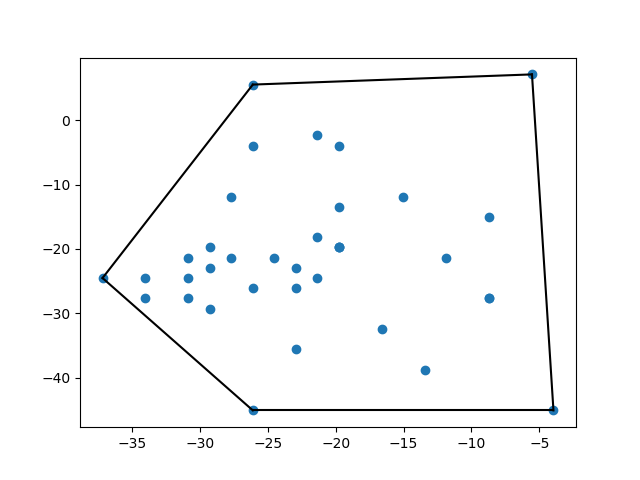

In [3]:
## To plot 2D convex hull
## Input/s = dictionary name, cascade number, coordinates dimension (2/3) [PREFERABLY 2]
plot_2d_convex_hull(cascadesf, 0, 2)
## Must press QUIT (TO STOP INTERACTION) button after analysis else effects other plots especially the next one


#_3D Plotting_

In [5]:
## Plots scatter 3d convex hull
## Input/s = dictionary name, cascade number
plot_scatter_3d_convex_hull(cascadesf,0)

In [3]:
## Plots mesh 3d convex hull 
## Input/s = dictionary name, cascade number
plot_mesh_3d_convex_hull(cascadesf,0)

### _Analysis with various types of geometrical plots_

Function Definitions

In [32]:
def get_3d_coords(dict_name, only_vacancies):
    coords_3d = []
    for cascade in dict_name['data']:
        if(only_vacancies == 1):
            a = [[c[0],c[1],c[2]] for c in cascade['coords'] if (c[3]==0 and c[5]==1)]
        else:
            a = [[c[0],c[1],c[2]] for c in cascade['coords']]
        coords_3d.append(a)
    return coords_3d



def show_warning(message): ## Used in add_hull_and_extra_features_to_dict function
    import tkinter as tk
    root = tk.Tk()
    root.title("WARNING")
    root.geometry("700x100+370+100")
    w = tk.Label(root, text=message)
    w. place(relx=0.0, rely=1.0, anchor='sw')
    w.pack()
    root.mainloop()
    
    
    
def dclust_coords_exists_or_not(filename): ## Used in add_hull_and_extra_features_to_dict function
    import json
    with open(filename, 'r') as f:
        dict_name = json.loads(f.read())
    for key in dict_name['data'][0].keys():
        if(key == 'dclust_coords'):
            return 1
    return 0


area_array=[]
volume_array=[]
density_array=[]
no_of_indices_array=[]
subcascades_count_array=[]
energies=[]
elements=[]
def add_hull_and_extra_features_to_dict(filename): ## Used in get_data function ## ALWAYS EXECUTE THIS FUNCTION (IMP. PREREQUISITE) 
    import json
    import numpy as np
    from scipy.spatial import ConvexHull
    
    with open(filename, 'r') as f:
        dict_name = json.loads(f.read()) #data becomes a dictionary

    ## Checks whether file data contains 'dclust_coords' as key or not for subcascades_count key generation
    subcascade=dclust_coords_exists_or_not(filename)
    
    ## To get 3d coordinates of vacancies from dictionary
    coords_3d = get_3d_coords(dict_name,1)
    for i,cascade in enumerate(dict_name['data']):
        ## Points type-casting
        pts = np.array(coords_3d[i], np.float)
        if (len(pts) < 4):
            ## Shows warning if points in a cascade are < 4
            show_warning("Number of points in cascade "+str(i)+" is less than 4.\nSo, kindly don't run plotting function calls for this cascade as it will rise an error.")
            cascade['hull_vertices'] = 0
            cascade['hull_simplices'] = [ch.simplices.tolist()]
            cascade['hull_nvertices'] = 0
            cascade['hull_nsimplices'] = 0
            cascade['hull_neighbors'] = [ch.neighbors.tolist()]
            #cascade['hull_max_bound'] = ch.max_bound.tolist()
            #cascade['hull_min_bound'] = ch.min_bound.tolist()
            cascade['hull_area'] = 0.0
            cascade['hull_volume'] = 0.0
            cascade['hull_density'] = 0.0
            cascade['hull_no_of_indices']=0
            ## Checks whether file data contains 'dclust_coords' as key or not for subcascades_count key generation
            if(subcascade==1):
                cascade['subcascades_count']=len(dict_name['data'][i]['dclust_coords'].keys())
        else:
            ## Convex hull generation
            ch = ConvexHull(pts)
            cascade['hull_vertices'] = ch.vertices.tolist()
            cascade['hull_simplices'] = ch.simplices.tolist()
            cascade['hull_nvertices'] = len(ch.vertices)
            cascade['hull_nsimplices'] = ch.nsimplex
            cascade['hull_neighbors'] = ch.neighbors.tolist()
            #cascade['hull_max_bound'] = ch.max_bound.tolist()
            #cascade['hull_min_bound'] = ch.min_bound.tolist()
            cascade['hull_area'] =ch.area
            cascade['hull_volume'] = ch.volume
            cascade['hull_density'] = dict_name['data'][i]['n_defects']/ch.volume
            cascade['hull_no_of_indices']=len(ch.vertices)
            ## Checks whether file data contains 'dclust_coords' as key or not for subcascades_count key generation
            if(subcascade==1):
                cascade['subcascades_count']=len(dict_name['data'][i]['dclust_coords'].keys())
                
    ## To make changes to original file
    with open(filename, 'w') as f:
        f.write(json.dumps(dict_name, indent=4, separators=(',', ': ')))
    
    
    ## To create arrays which are helpful in plotting
    for i,cascade in enumerate(dict_name['data']):
        ## Area array generation
        area_array.append(cascade['hull_area'])

        ## Volume array generation
        volume_array.append(cascade['hull_volume'])

        ## Density array generation
        density_array.append(cascade['hull_density'])

        ## Hull indices generation
        no_of_indices_array.append(cascade['hull_no_of_indices'])
        
        ## Subcascades count array generation
        ## Checks whether file data contains 'dclust_coords' as key or not for subcascades_count key generation
        if(subcascade==1):
            subcascades_count_array.append(cascade['subcascades_count'])
                
        ## Energy array generation
        energies.append(cascade['energy'])
        
        ## Element array generation
        elements.append(cascade['substrate'])
        
            
    ## Areas of all cascades
    #print("Areas")
    #print(area_array)
    #print(len(area_array))
    #print()

    ## Volumes of all cascades
    #print("Volumes")
    #print(volume_array)
    #print(len(volume_array))
    #print()

    ## Densities of all cascades
    #print("Densities")
    #print(density_array)
    #print(len(density_array))
    #print()

    ## No. of indices of all cascades 
    #print("No. of indices")
    #print(len(no_of_indices_array))
    #print(no_of_indices_array)
    #print()
    
    ## Subcascades of all cascades ## To print subcascades remove comments for below 8 lines
    #count=0
    #for val in subcascades_count_array:
        #if(val==0):
            #count=count+1
    #if(count!=len(subcascades_count_array)):
        #print("Subcascades")
        #print(len(subcascades_count_array))
        #print(subcascades_count_array)
        #print()
        
    ## Energies of all cascades
    #print("Energies")
    #print(energies)
    #print(len(energies))
    #print()
    
    ## Elements of all cascades
    #print("Elements")
    #print(elements)
    #print(len(elements))
    #print()



def get_data(filename): 
    ## Adds extra features to file for more flexibility in coding
    ## Input/s = data file
    add_hull_and_extra_features_to_dict(filename)
    
    import json
    from pathlib import Path
    
    fname = filename
    out_fname = Path(fname).stem + ".js"
    f = open(fname, "r+")
    cascades = json.load(f)
    f.close()
    return cascades


    
def hist_plot_hull_features_separately():
    import random
    import numpy
    %matplotlib inline
    from matplotlib import pyplot
    import matplotlib.pyplot as plt
    fig = plt.figure()

    string = "PLOTS FOR IMP. HULL FEATURES SEPARATELY"
    print(string.center(115,"*"))
    
    plt.style.use('seaborn-darkgrid')

    plt.subplot(2, 2, 1)
    plt.xlabel("Areas (" + r'$\AA^2$' +")")
    plt.ylabel("Frequency")
    plt.title("Area Analysis")
    plt.hist(area_array, rwidth=0.95)
    pyplot.subplots_adjust(left=None, bottom=None, right=3.5, top=2.5, wspace=None, hspace=None)
    ## To remove scientific notation and offset for this subplot, uncomment the below line
    #plt.ticklabel_format(useOffset=False, style='plain')

    plt.subplot(2, 2, 2)
    plt.xlabel("Volumes (" + r'$\AA^3$' +")")
    plt.ylabel("Frequency")
    plt.title("Volume Analysis")
    plt.hist(volume_array, rwidth=0.95)
    #plt.ticklabel_format(useOffset=False, style='plain')

    plt.subplot(2, 2, 3)
    plt.xlabel("Densities (" + r'$\AA^{-3}$' +")")
    plt.ylabel("Frequency")
    plt.title("Density Analysis")
    plt.hist(density_array, rwidth=0.95)
    #plt.ticklabel_format(useOffset=False, style='plain')

    plt.subplot(2, 2, 4)
    plt.xlabel("No. of Indices range")
    plt.ylabel("Frequency")
    plt.title("No. of Iindices Analysis")
    plt.hist(no_of_indices_array, rwidth=0.95)
    #plt.ticklabel_format(useOffset=False, style='plain')

    pyplot.show()
    
    
    
def hist_plot_hull_features_mixed():
    import random
    import numpy as np
    %matplotlib inline
    from matplotlib import pyplot
    import matplotlib.pyplot as plt
    
    string = "PLOT FOR IMP. HULL FEATURES TOGETHER"
    print(string.center(115,"*"))
    
    plt.style.use('seaborn-darkgrid')
    fig = plt.figure()
    fig.set_size_inches(18.5, 10.5, forward=True) ## To increase size of figure
    plt.xlabel("Areas (" + r'$\AA^2$' +"), Volumes (" + r'$\AA^3$' +"), Density ("+ r'$\AA^{-3}$' +") & No. of Indices")
    plt.ylabel("Frequency")
    plt.title("Area, Volume, Density & No. of Indices analysis")
    plt.hist([area_array, volume_array, density_array, no_of_indices_array], rwidth=0.95, label=['area', 'volume', 'density', 'No. of indices'])
    
    ## Change the x-axis range and if necessary bin vlaue accordingly for better visualization of the plot
    ## range=(min_value, max_value)   ##bins=no_of_bins_you_want
    #plt.hist([area_array, volume_array, density_array, no_of_indices_array], range=(0, 2500), bins=4, rwidth=0.95, label=['area', 'volume', 'density', 'No. of indices'])
    
    ## To change the x-axis scale to logarithmic scale
    #plt.xscale('log')

    pyplot.legend(loc='upper right')
    ## To remove scientific notation and offset for this subplot, uncomment the below line
    #plt.ticklabel_format(useOffset=False, style='plain')

    pyplot.show()
    
    

def hist_plot_hull_features_acc_to_energies(): 
    ## Creates a list of unique energies from global variable energies
    unique_energy_list = list(dict.fromkeys(energies))
    unique_energy_list.sort() ## To sort the list in ASC order
    #print(unique_energy_list)

    ## Creates a dict to store feature vals acc. to diff energies - Try printting for better understanding 
    ## The lists in feature (ex: areas) key is acc. to unique_energy_list
    ## Abv. mentioned list contains again a list of val acc. to feature and energy respectively
    list_feature_energy={}
    list_feature_energy['areas']=[]
    list_feature_energy['vols']=[]
    list_feature_energy['densities']=[]
    list_feature_energy['no_of_indices']=[]
    ## Feature key contains a list of energies
    for feature in list_feature_energy:
        for energy in unique_energy_list:
            list_feature_energy[feature].append(energy)
    ## Feature key contains an n no. of empty lists which again contains a list - n is no. of diff. energies 
    for feature in list_feature_energy:
        for i, energy in enumerate(list_feature_energy[feature]):
            list_feature_energy[feature][i]=[]
    #print(list_feature_energy)

    ## Adds vals. to list_feature_energy acc. to feature and energy respectively
    for i, energy in enumerate(unique_energy_list):
        for j in range(0, len(energies)):
            if(energies[j]==energy):
                list_feature_energy['areas'][i].append(area_array[j])
                list_feature_energy['vols'][i].append(volume_array[j])
                list_feature_energy['densities'][i].append(density_array[j])
                list_feature_energy['no_of_indices'][i].append(no_of_indices_array[j])
    #print(list_feature_energy)


    ## Plotting
    import random
    import numpy
    %matplotlib inline
    from matplotlib import pyplot
    import matplotlib.pyplot as plt
    fig = plt.figure()

    string = "PLOTS FOR THE WHOLE DATA ACCORDING TO ENERGIES (KeV)"
    print(string.center(115,"*"))
    print()

    string = "AREA, VOLUME & NO_OF_INDICES PLOTS ACCORDING TO ENERGIES  (KeV) : "+str(unique_energy_list)
    print(string.center(115))
    print()

    plt.style.use('seaborn-darkgrid')

    nrow=len(unique_energy_list)+len(unique_energy_list)-1
    plot_no=1
    for i,energy in enumerate(unique_energy_list):
        array_val=[]
        for val in list_feature_energy['areas'][i]:
            array_val.append(val)
        plt.subplot(nrow, 4, plot_no)
        plt.xlabel("Area (" + r'$\AA^2$' +")")
        plt.ylabel("Frequency")
        plt.title("Area Analysis for Energy = "+str(energy)+" KeV")
        plt.hist(array_val, rwidth=0.95)
        pyplot.subplots_adjust(left=None, bottom=None, right=4.5, top=15.0, wspace=None, hspace=None)
        ## To remove scientific notation and offset for this subplot, uncomment the below line
        #plt.ticklabel_format(useOffset=False, style='plain') 
        plot_no=plot_no+1

        array_val=[]
        for val in list_feature_energy['vols'][i]:
            array_val.append(val)
        plt.subplot(nrow, 4, plot_no)
        plt.xlabel("Volume (" + r'$\AA^3$' +")")
        plt.ylabel("Frequency")
        plt.title("Volume Analysis for Energy = "+str(energy)+" KeV")
        plt.hist(array_val, rwidth=0.95)
        pyplot.subplots_adjust(left=None, bottom=None, right=4.5, top=15.0, wspace=None, hspace=None)
        #plt.ticklabel_format(useOffset=False, style='plain') 
        plot_no=plot_no+1

        array_val=[]
        for val in list_feature_energy['densities'][i]:
            array_val.append(val)
        plt.subplot(nrow, 4, plot_no)
        plt.xlabel("Density (" + r'$\AA^{-3}$' +")")
        plt.ylabel("Frequency")
        plt.title("Density Analysis for Energy = "+str(energy)+" KeV")
        plt.hist(array_val, rwidth=0.95)
        pyplot.subplots_adjust(left=None, bottom=None, right=4.5, top=15.0, wspace=None, hspace=None)
        #plt.ticklabel_format(useOffset=False, style='plain')
        plot_no=plot_no+1

        array_val=[]
        for val in list_feature_energy['no_of_indices'][i]:
            array_val.append(val)
        plt.subplot(nrow, 4, plot_no)
        plt.xlabel("No. of Indices")
        plt.ylabel("Frequency")
        plt.title("No. of Indices Analysis for Energy = "+str(energy)+" KeV")
        plt.hist(array_val, rwidth=0.95)
        pyplot.subplots_adjust(left=None, bottom=None, right=4.5, top=15.0, wspace=None, hspace=None)
        #plt.ticklabel_format(useOffset=False, style='plain') 
        plot_no=plot_no+1

        plot_no=plot_no+4 ## For 1 row gap after each energy

    pyplot.show()


    
def hist_plot_hull_features_acc_to_elements(): 
    ## Creates a list of unique elements from global variable elements
    unique_element_list = list(dict.fromkeys(elements))
    unique_element_list.sort() ## To sort the list in ASC order
    #print(unique_element_list)

    ## Creates a dict to store feature vals acc. to diff elements - Try printting for better understanding 
    ## The lists in feature (ex: areas) key is acc. to unique_element_list
    ## Abv. mentioned list contains again a list of val acc. to feature and element respectively
    list_feature_element={}
    list_feature_element['areas']=[]
    list_feature_element['vols']=[]
    list_feature_element['densities']=[]
    list_feature_element['no_of_indices']=[]
    ## Feature key contains a list of elements
    for feature in list_feature_element:
        for element in unique_element_list:
            list_feature_element[feature].append(element)
    ## Feature key contains an n no. of empty lists which again contains a list - n is no. of diff. elements 
    for feature in list_feature_element:
        for i, element in enumerate(list_feature_element[feature]):
            list_feature_element[feature][i]=[]
    #print(list_feature_element)

    ## Adds vals. to list_feature_energy acc. to feature and element respectively
    for i, element in enumerate(unique_element_list):
        for j in range(0, len(elements)):
            if(elements[j]==element):
                list_feature_element['areas'][i].append(area_array[j])
                list_feature_element['vols'][i].append(volume_array[j])
                list_feature_element['densities'][i].append(density_array[j])
                list_feature_element['no_of_indices'][i].append(no_of_indices_array[j])
    #print(list_feature_element)


    ## Plotting
    import random
    import numpy
    %matplotlib inline
    from matplotlib import pyplot
    import matplotlib.pyplot as plt
    fig = plt.figure()
    
    string = "PLOTS FOR THE WHOLE DATA ACCORDING TO ELEMENTS"
    print(string.center(105,"*"))
    print()

    for elmt in unique_element_list:
        string = elmt+" PLOTS"
        print(string.center(105))
        print()

    plt.style.use('seaborn-darkgrid')

    nrow=len(unique_element_list)+len(unique_element_list)-1
    plot_no=1
    for i,element in enumerate(unique_element_list):
        array_val=[]
        for val in list_feature_element['areas'][i]:
            array_val.append(val)
        plt.subplot(nrow, 4, plot_no)
        plt.xlabel("Area (" + r'$\AA^2$' +")")
        plt.ylabel("Frequency")
        plt.title("Area Analysis for Element '"+str(element)+"'")
        plt.hist(array_val, rwidth=0.95)
        pyplot.subplots_adjust(left=None, bottom=None, right=4.5, top=6.0, wspace=None, hspace=None)
        ## To remove scientific notation and offset for this subplot, uncomment the below line
        #plt.ticklabel_format(useOffset=False, style='plain') 
        plot_no=plot_no+1

        array_val=[]
        for val in list_feature_element['vols'][i]:
            array_val.append(val)
        plt.subplot(nrow, 4, plot_no)
        plt.xlabel("Volume (" + r'$\AA^3$' +")")
        plt.ylabel("Frequency")
        plt.title("Volume Analysis for Element '"+str(element)+"'")
        plt.hist(array_val, rwidth=0.95)
        pyplot.subplots_adjust(left=None, bottom=None, right=4.5, top=6.0, wspace=None, hspace=None)
        #plt.ticklabel_format(useOffset=False, style='plain') 
        plot_no=plot_no+1

        array_val=[]
        for val in list_feature_element['densities'][i]:
            array_val.append(val)
        plt.subplot(nrow, 4, plot_no)
        plt.xlabel("Density (" + r'$\AA^{-3}$' +")")
        plt.ylabel("Frequency")
        plt.title("Density Analysis for Element '"+str(element)+"'")
        plt.hist(array_val, rwidth=0.95)
        pyplot.subplots_adjust(left=None, bottom=None, right=4.5, top=6.0, wspace=None, hspace=None)
        #plt.ticklabel_format(useOffset=False, style='plain') 
        plot_no=plot_no+1

        array_val=[]
        for val in list_feature_element['no_of_indices'][i]:
            array_val.append(val)
        plt.subplot(nrow, 4, plot_no)
        plt.xlabel("No. of Indices")
        plt.ylabel("Frequency")
        plt.title("No. of Indices Analysis for Element '"+str(element)+"'")
        plt.hist(array_val, rwidth=0.95)
        pyplot.subplots_adjust(left=None, bottom=None, right=4.5, top=6.0, wspace=None, hspace=None)
        #plt.ticklabel_format(useOffset=False, style='plain') 
        plot_no=plot_no+1

        plot_no=plot_no+4 ## For 1 row gap after each element

    pyplot.show()



def hist_plot_hull_features_acc_to_elements_energies():
    ## Creates a list of unique elements from global variable elements
    unique_element_list = list(dict.fromkeys(elements))
    unique_element_list.sort() ## To sort the list in ASC order
    #print(unique_element_list)

    ## Creates an array list of energies acc. to unique_element_list
    sorted_energies_acc_to_sorted_elements=[]
    for ele in unique_element_list:
        enr_list=[]
        for i,elem in enumerate(elements):
            if(elem==ele):
                enr_list.append(energies[i])
        enr_list = list(dict.fromkeys(enr_list))
        enr_list.sort()  ## To sort the list in ASC order
        sorted_energies_acc_to_sorted_elements.append(enr_list)    
    #print(sorted_energies_acc_to_sorted_elements)

    ## Creates a dict to store feature vals acc. to diff elements - Try printting for better understanding 
    ## The lists in feature (ex: areas) key is acc. to unique_element_list
    ## Abv. mentioned list contains again a list of energies acc. to feature and element respectively
    list_feature_element_energy={}
    list_feature_element_energy['areas']=[]
    list_feature_element_energy['vols']=[]
    list_feature_element_energy['densities']=[]
    list_feature_element_energy['no_of_indices']=[]
    ## Feature key contains a list of elements which is inturn a list of energies acc. to elements' index in unique_element_list respectively
    for feature in list_feature_element_energy:
        for i,element in enumerate(unique_element_list):
            list_feature_element_energy[feature].append(sorted_energies_acc_to_sorted_elements[i])
    #print(list_feature_element_energy)

    ## Create an array list which contains features which contain elements which inturn contains energies acc. to elements' index in unique_element_list respectively
    feature_element_energy_array=[]
    for feature in list_feature_element_energy:
        f=[]
        for i,element in enumerate(unique_element_list):
            el=[]
            for j,energy_val in enumerate(sorted_energies_acc_to_sorted_elements[i]):
                en=[]
                for k in range(0, len(energies)):
                    if(energies[k]==energy_val):
                        if(elements[k]==element):
                            if(feature=='areas'):
                                en.append(area_array[k])
                            if(feature=='vols'):
                                en.append(volume_array[k])
                            if(feature=='densities'):
                                en.append(density_array[k])
                            if(feature=='no_of_indices'):
                                en.append(no_of_indices_array[k])
                el.append(en)
            f.append(el)
        feature_element_energy_array.append(f)
    #print(feature_element_energy_array)

    ## Plotting
    import random
    import numpy
    %matplotlib inline
    from matplotlib import pyplot
    import matplotlib.pyplot as plt
    fig = plt.figure()

    string = "PLOTS FOR THE WHOLE DATA ACCORDING TO ELEMENTS -> ENERGIES (KeV)"
    print(string.center(115,"*"))
    print()

    string = "AREA, VOLUME, DENSITY & NO_OF_INDICES PLOTS ACCORDING TO ELEMENTS -> ENERGIES (KeV)"
    print(string.center(115))
    print()
    string=str(unique_element_list)+" -> "+str(sorted_energies_acc_to_sorted_elements)
    print(string.center(115))
    print()

    plt.style.use('seaborn-darkgrid')

    sorted_energies_acc_to_sorted_elements
    nrow=0
    for i, ele in enumerate(sorted_energies_acc_to_sorted_elements):
        for j,enr in enumerate(sorted_energies_acc_to_sorted_elements[i]):
            nrow=nrow+1
    nrow=(2*nrow)+1

    plot_no=1

    for i,ele in enumerate(unique_element_list):
        for j,enr in enumerate(sorted_energies_acc_to_sorted_elements[i]):

            array_val=[]
            for val in feature_element_energy_array[0][i][j]:
                array_val.append(val)
            plt.subplot(nrow, 4, plot_no)
            plt.xlabel("Area (" + r'$\AA^2$' +")")
            plt.ylabel("Frequency")
            plt.title("Area Analysis for Element '"+str(ele)+"' of Energy = "+str(enr)+" KeV")
            plt.hist(array_val, rwidth=0.95)
            pyplot.subplots_adjust(left=None, bottom=None, right=4.5, top=20.0, wspace=None, hspace=None)
            ## To remove scientific notation and offset for this subplot, uncomment the below line
            #plt.ticklabel_format(useOffset=False, style='plain') 
            plot_no=plot_no+1

            array_val=[]
            for val in feature_element_energy_array[1][i][j]:
                array_val.append(val)
            plt.subplot(nrow, 4, plot_no)
            plt.xlabel("Volume (" + r'$\AA^3$' +")")
            plt.ylabel("Frequency")
            plt.title("Volume Analysis for Element '"+str(ele)+"' of Energy = "+str(enr)+" KeV")
            plt.hist(array_val, rwidth=0.95)
            pyplot.subplots_adjust(left=None, bottom=None, right=4.5, top=20.0, wspace=None, hspace=None)
            #plt.ticklabel_format(useOffset=False, style='plain') 
            plot_no=plot_no+1

            array_val=[]
            for val in feature_element_energy_array[2][i][j]:
                array_val.append(val)
            plt.subplot(nrow, 4, plot_no)
            plt.xlabel("Density (" + r'$\AA^{-3}$' +")")
            plt.ylabel("Frequency")
            plt.title("Density Analysis for Element '"+str(ele)+"' of Energy = "+str(enr)+" KeV")
            plt.hist(array_val, rwidth=0.95)
            pyplot.subplots_adjust(left=None, bottom=None, right=4.5, top=20.0, wspace=None, hspace=None)
            #plt.ticklabel_format(useOffset=False, style='plain') 
            plot_no=plot_no+1

            array_val=[]
            for val in feature_element_energy_array[3][i][j]:
                array_val.append(val)
            plt.subplot(nrow, 4, plot_no)
            plt.xlabel("No. of Indices")
            plt.ylabel("Frequency")
            plt.title("No. of Indices Analysis for Element '"+str(ele)+"' of Energy = "+str(enr)+" KeV")
            plt.hist(array_val, rwidth=0.95)
            pyplot.subplots_adjust(left=None, bottom=None, right=4.5, top=20.0, wspace=None, hspace=None)
            #plt.ticklabel_format(useOffset=False, style='plain') 
            plot_no=plot_no+1

            plot_no=plot_no+4 ## For 1 row gap after each energy

        plot_no=plot_no+4 ## For 2 rows gap after each element

    pyplot.show()



def hist_plot_hull_features_acc_to_elements_and_energies_with_diff_colors():    
    ## Creates a list of unique elements from global variable elements
    unique_element_list = list(dict.fromkeys(elements))
    unique_element_list.sort() ## To sort the list in ASC order
    #print(unique_element_list)

    ## Creates an array list of energies acc. to unique_element_list
    sorted_energies_acc_to_sorted_elements=[]
    for ele in unique_element_list:
        enr_list=[]
        for i,elem in enumerate(elements):
            if(elem==ele):
                enr_list.append(energies[i])
        enr_list = list(dict.fromkeys(enr_list))
        enr_list.sort()  ## To sort the list in ASC order
        sorted_energies_acc_to_sorted_elements.append(enr_list)    
    #print(sorted_energies_acc_to_sorted_elements)

    ## Creates a dict to store feature vals acc. to diff elements - Try printting for better understanding 
    ## The lists in feature (ex: areas) key is acc. to unique_element_list
    ## Abv. mentioned list contains again a list of energies acc. to feature and element respectively
    list_feature_element_energy={}
    list_feature_element_energy['areas']=[]
    list_feature_element_energy['vols']=[]
    list_feature_element_energy['densities']=[]
    list_feature_element_energy['no_of_indices']=[]
    ## Feature key contains a list of elements which is inturn a list of energies acc. to elements' index in unique_element_list respectively
    for feature in list_feature_element_energy:
        for i,element in enumerate(unique_element_list):
            list_feature_element_energy[feature].append(sorted_energies_acc_to_sorted_elements[i])
    #print(list_feature_element_energy)

    ## Create an array list which contains features which contain elements which inturn contains energies acc. to elements' index in unique_element_list respectively
    feature_element_energy_array=[]
    for feature in list_feature_element_energy:
        f=[]
        for i,element in enumerate(unique_element_list):
            el=[]
            for j,energy_val in enumerate(sorted_energies_acc_to_sorted_elements[i]):
                en=[]
                for k in range(0, len(energies)):
                    if(energies[k]==energy_val):
                        if(elements[k]==element):
                            if(feature=='areas'):
                                en.append(area_array[k])
                            if(feature=='vols'):
                                en.append(volume_array[k])
                            if(feature=='densities'):
                                en.append(density_array[k])
                            if(feature=='no_of_indices'):
                                en.append(no_of_indices_array[k])
                el.append(en)
            f.append(el)
        feature_element_energy_array.append(f)
    #print(feature_element_energy_array)

    ## Plotting
    import random
    import numpy
    %matplotlib inline
    from matplotlib import pyplot
    import matplotlib.pyplot as plt
    fig = plt.figure()

    string = "PLOTS FOR THE WHOLE DATA ACCORDING TO ELEMENTS -> ENERGIES (KeV) {EACH IN DIFFERENT COLOR}"
    print(string.center(115,"*"))
    print()

    string = "AREA, VOLUME, DENSITY & NO_OF_INDICES PLOTS ACCORDING TO ELEMENTS -> ENERGIES (KeV) {EACH IN DIFFERENT COLOR}"
    print(string.center(115))
    print()
    string=str(unique_element_list)+" -> "+str(sorted_energies_acc_to_sorted_elements)
    print(string.center(115))
    print()

    plt.style.use('seaborn-darkgrid')

    nrow=len(unique_element_list)+len(unique_element_list)-1
    plot_no=1

    for i,ele in enumerate(unique_element_list):
        labels=[]
        arr=[]
        for j,enr in enumerate(sorted_energies_acc_to_sorted_elements[i]):
            labels.append('energy '+str(enr)+' KeV')

            array_val=[]
            for val in feature_element_energy_array[0][i][j]:
                array_val.append(val)
            arr.append(array_val)

        plt.subplot(nrow, 4, plot_no)
        plt.xlabel("Area (" + r'$\AA^2$' +")")
        plt.ylabel("Frequency")
        plt.title("Area Analysis for Element '"+str(ele)+"'")
        plt.hist(arr, rwidth=0.95, label=labels)
        pyplot.subplots_adjust(left=None, bottom=None, right=4.5, top=5.0, wspace=None, hspace=None)
        pyplot.legend(loc='upper right')
        ## To remove scientific notation and offset for this subplot, uncomment the below line
        #plt.ticklabel_format(useOffset=False, style='plain') 
        plot_no=plot_no+1

        labels=[]
        arr=[]
        for j,enr in enumerate(sorted_energies_acc_to_sorted_elements[i]):
            labels.append('energy '+str(enr)+' KeV')

            array_val=[]
            for val in feature_element_energy_array[1][i][j]:
                array_val.append(val)
            arr.append(array_val)
        plt.subplot(nrow, 4, plot_no)
        plt.xlabel("Volume (" + r'$\AA^3$' +")")
        plt.ylabel("Frequency")
        plt.title("Volume Analysis for Element '"+str(ele)+"'")
        plt.hist(arr, rwidth=0.95, label=labels)
        pyplot.subplots_adjust(left=None, bottom=None, right=4.5, top=5.0, wspace=None, hspace=None)
        pyplot.legend(loc='upper right')
        #plt.ticklabel_format(useOffset=False, style='plain') 
        plot_no=plot_no+1

        labels=[]
        arr=[]
        for j,enr in enumerate(sorted_energies_acc_to_sorted_elements[i]):
            labels.append('energy '+str(enr)+' KeV')

            array_val=[]
            for val in feature_element_energy_array[2][i][j]:
                array_val.append(val)
            arr.append(array_val)
        plt.subplot(nrow, 4, plot_no)
        plt.xlabel("Density (" + r'$\AA^{-3}$' +")")
        plt.ylabel("Frequency")
        plt.title("Density Analysis for Element '"+str(ele)+"'")
        plt.hist(arr, rwidth=0.95, label=labels)
        pyplot.subplots_adjust(left=None, bottom=None, right=4.5, top=5.0, wspace=None, hspace=None)
        pyplot.legend(loc='upper right')
        #plt.ticklabel_format(useOffset=False, style='plain') 
        plot_no=plot_no+1

        labels=[]
        arr=[]
        for j,enr in enumerate(sorted_energies_acc_to_sorted_elements[i]):
            labels.append('energy '+str(enr)+' KeV')

            array_val=[]
            for val in feature_element_energy_array[3][i][j]:
                array_val.append(val)
            arr.append(array_val)
        plt.subplot(nrow, 4, plot_no)
        plt.xlabel("No. of Indices")
        plt.ylabel("Frequency")
        plt.title("No. of Indices Analysis for Element '"+str(ele)+"'")
        plt.hist(arr, rwidth=0.95, label=labels)
        pyplot.subplots_adjust(left=None, bottom=None, right=4.5, top=5.0, wspace=None, hspace=None)
        pyplot.legend(loc='upper right')
        #plt.ticklabel_format(useOffset=False, style='plain') 
        plot_no=plot_no+1

        plot_no=plot_no+4 ## For 1 row gap after each energy

    pyplot.show()



def box_plot_hull_features_acc_to_elements_energies():
    ## Creates a list of unique elements from global variable elements
    unique_element_list = list(dict.fromkeys(elements))
    unique_element_list.sort() ## To sort the list in ASC order
    #print(unique_element_list)
    
    ## Creates a list of unique energies from global variable energies ##Used in warning
    unique_energy_list = list(dict.fromkeys(energies))
    unique_energy_list.sort() ## To sort the list in ASC order
    #print(unique_energy_list)

    ## Creates an array list of energies acc. to unique_element_list
    sorted_energies_acc_to_sorted_elements=[]
    for ele in unique_element_list:
        enr_list=[]
        for i,elem in enumerate(elements):
            if(elem==ele):
                enr_list.append(energies[i])
        enr_list = list(dict.fromkeys(enr_list))
        enr_list.sort()  ## To sort the list in ASC order
        sorted_energies_acc_to_sorted_elements.append(enr_list)    
    #print(sorted_energies_acc_to_sorted_elements)

    ## Creates a dict to store feature vals acc. to diff elements - Try printting for better understanding 
    ## The lists in feature (ex: areas) key is acc. to unique_element_list
    ## Abv. mentioned list contains again a list of energies acc. to feature and element respectively
    list_feature_element_energy={}
    list_feature_element_energy['areas']=[]
    list_feature_element_energy['vols']=[]
    list_feature_element_energy['densities']=[]
    list_feature_element_energy['no_of_indices']=[]
    ## Feature key contains a list of elements which is inturn a list of energies acc. to elements' index in unique_element_list respectively
    for feature in list_feature_element_energy:
        for i,element in enumerate(unique_element_list):
            list_feature_element_energy[feature].append(sorted_energies_acc_to_sorted_elements[i])
    #print(list_feature_element_energy)

    ## Create an array list which contains features which contain elements which inturn contains energies acc. to elements' index in unique_element_list respectively
    feature_element_energy_array=[]
    for feature in list_feature_element_energy:
        f=[]
        for i,element in enumerate(unique_element_list):
            el=[]
            for j,energy_val in enumerate(sorted_energies_acc_to_sorted_elements[i]):
                en=[]
                for k in range(0, len(energies)):
                    if(energies[k]==energy_val):
                        if(elements[k]==element):
                            if(feature=='areas'):
                                en.append(area_array[k])
                            if(feature=='vols'):
                                en.append(volume_array[k])
                            if(feature=='densities'):
                                en.append(density_array[k])
                            if(feature=='no_of_indices'):
                                en.append(no_of_indices_array[k])
                el.append(en)
            f.append(el)
        feature_element_energy_array.append(f)
    #print(feature_element_energy_array)

    ## Plotting
    ## Import dependencies for plotting
    import plotly
    import plotly.graph_objs as go

    ## Configure Plotly to be rendered inline in the notebook.
    plotly.offline.init_notebook_mode()
    
    string = "BOX PLOTS FOR THE WHOLE DATA ACCORDING TO ELEMENTS -> ENERGIES (KeV) {EACH IN DIFFERENT COLOR}"
    print(string.center(115,"*"))
    print()

    string = "AREA, VOLUME, DENSITY & NO_OF_INDICES PLOTS ACCORDING TO ELEMENTS -> ENERGIES (KeV) {EACH IN DIFFERENT COLOR}"
    print(string.center(115))
    print()
    string=str(unique_element_list)+" -> "+str(sorted_energies_acc_to_sorted_elements)
    print(string.center(115))
    print()
    
    ## Shows warning if no. of unique energies are > 10
    if(len(unique_energy_list)>10):
        show_warning("Number of unique energies for all elements together is > 10. Therefore, kindly add more colors to the colors list in the function you called (colors variable is present in plotting section) for correct results as we have only 10 colors in the list.")
    
    colors=['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf']
    m_title=['AREA ANALYSIS', 'VOLUME ANALYSIS', 'DENSITY ANALYSIS', 'NO. OF INDICES ANALYSIS']
    y_title=[r'$\text{Area }('u'\u212B^2)$', r'$\text{Volume } ('u'\u212B^3)$', r'$\text{Density } ('u'\u212B^{-3})$', r'$\text{No. of Indices}$']

    for f, feature in enumerate(list_feature_element_energy):
        data=[]
        for i,ele in enumerate(unique_element_list):
            labels=[]
            arr=[]
            for j,enr in enumerate(sorted_energies_acc_to_sorted_elements[i]):
                labels.append(str(ele)+'_'+str(enr)+'(KeV)')

                for k, eng in enumerate(unique_energy_list):
                    if(enr == eng):
                        c=k

                array_val=[]
                for val in feature_element_energy_array[f][i][j]:
                    array_val.append(val)
                arr.append(array_val)


                trace = go.Box(
                        y=array_val,
                        name=labels[j],
                        boxpoints='all',
                        boxmean=True,
                        marker = dict(
                            color = colors[c]),
                        line = dict(
                            color = colors[c]),
                        jitter=0.3,
                        pointpos=-1.8)

                data.append(trace)

        layout = go.Layout(
            title=m_title[f],
            xaxis=dict(
                title=r'$\text{Elements According to Energies}$'
            ),
            yaxis=dict(
                title=y_title[f],
                exponentformat="E"
            ),
            #boxgap=0.5
        )
        fig = go.Figure(data=data, layout=layout)
        plotly.offline.iplot(fig)


Function Calls / User Code

#_To read file and get data_

In [33]:
## Must execute this function call as it is necessary for other calls (indirect interdependency) - COMPULSORY EXECUTION
## To get data from json file and store as dictionary  'cascadesf'
## Input/s = data file
cascadesf = get_data("cascades-data-full.json")


#_Histogram Plots for imp. Hull Features (Area, Volume, Density & No. of Indices)_

**************************************PLOTS FOR IMP. HULL FEATURES SEPARATELY**************************************


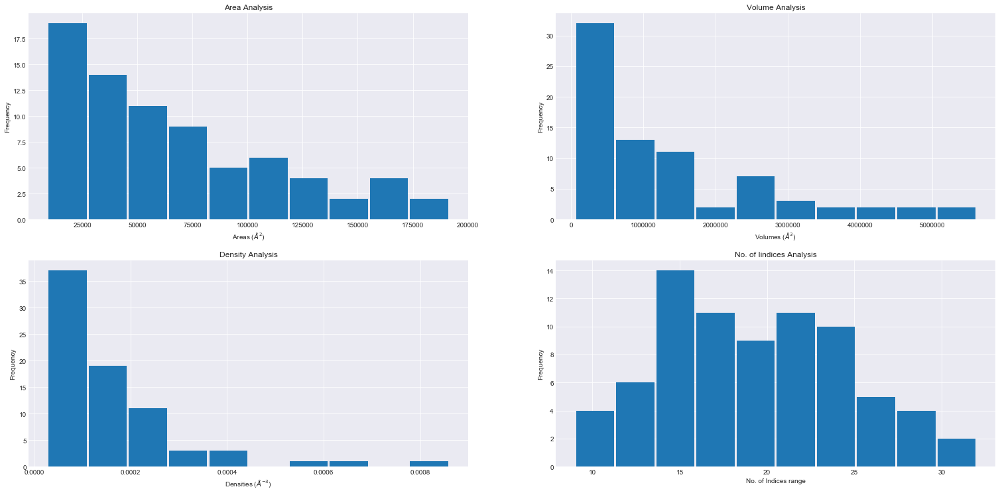

In [27]:
## Plots histograms for important geometric properties of hull (Area, Volume, Density, No. of Indices) separately
## To remove scientific notation and offset for any subplot, uncomment the ticklabel_format line for that subplot
hist_plot_hull_features_separately()


****************************************PLOT FOR IMP. HULL FEATURES TOGETHER***************************************


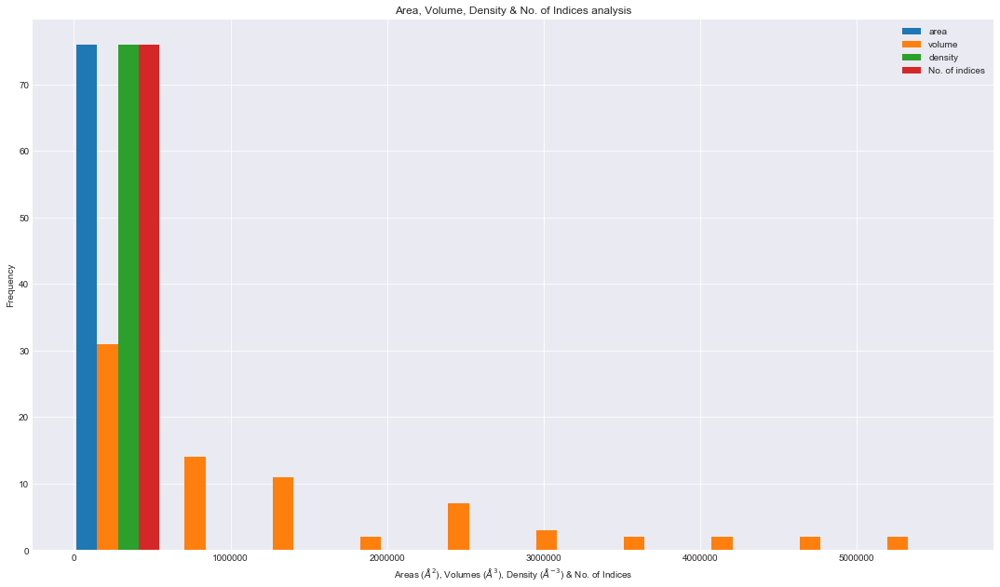

In [34]:
## Plots histograms for important geometric properties of hull (Area, Volume, Density, No. of Indices) mixed (all in 1 plot)
## For better visualization of the plot go to the function definition and change range vlaue and bin size accordingly
## To remove scientific notation and offset for any subplot, uncomment the ticklabel_format line for that subplot
hist_plot_hull_features_mixed()

********************************PLOTS FOR THE WHOLE DATA ACCORDING TO ENERGIES (KeV)*******************************

           AREA, VOLUME & NO_OF_INDICES PLOTS ACCORDING TO ENERGIES  (KeV) : [10, 20, 50, 100, 150, 200]           



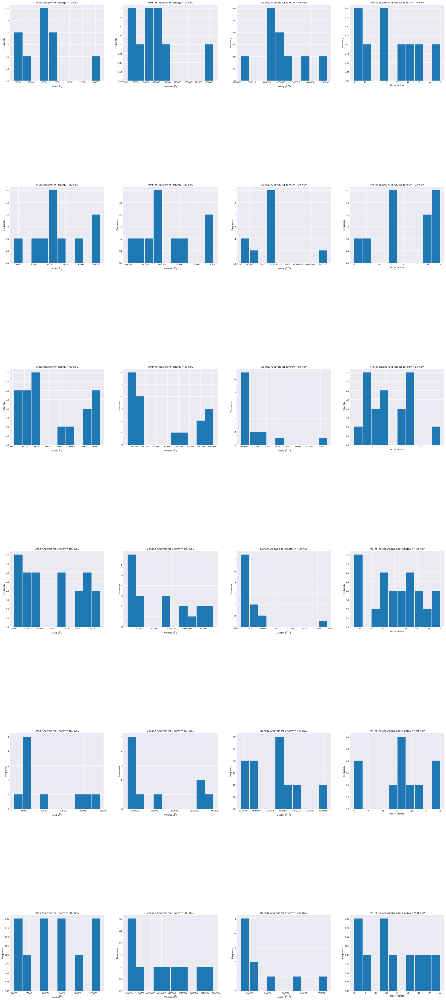

In [35]:
## Plots histograms for important geometric properties of hull (Area, Volume, Density, No. of Indices) acc. to Energies
hist_plot_hull_features_acc_to_energies()

******************************PLOTS FOR THE WHOLE DATA ACCORDING TO ELEMENTS*****************************

                                                 Fe PLOTS                                                

                                                 W PLOTS                                                 



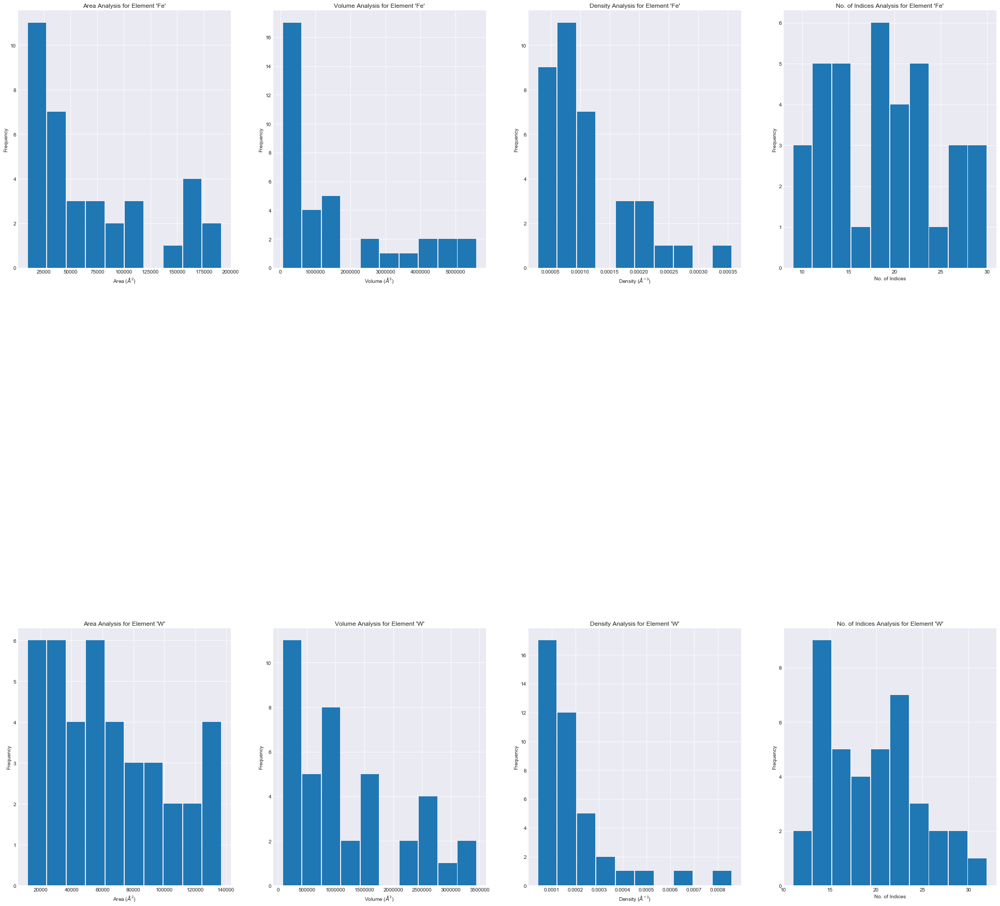

In [36]:
## Plots histograms for important geometric properties of hull (Area, Volume, Density, No. of Indices) acc. to Elements
hist_plot_hull_features_acc_to_elements()

**************************PLOTS FOR THE WHOLE DATA ACCORDING TO ELEMENTS -> ENERGIES (KeV)*************************

                AREA, VOLUME, DENSITY & NO_OF_INDICES PLOTS ACCORDING TO ELEMENTS -> ENERGIES (KeV)                

                              ['Fe', 'W'] -> [[10, 20, 50, 100], [50, 100, 150, 200]]                              



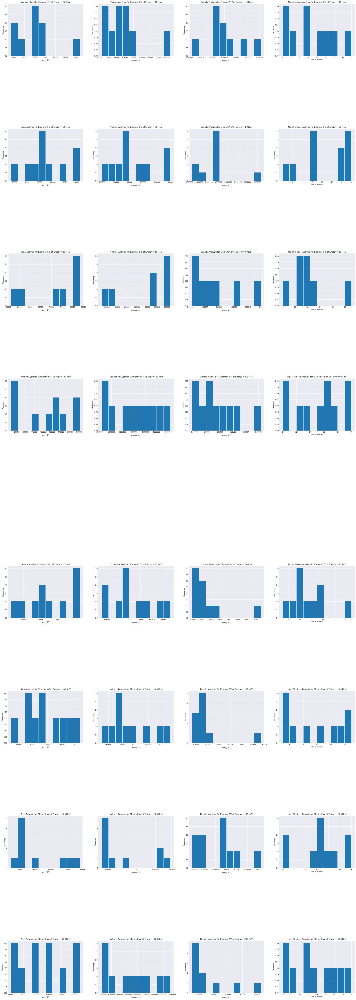

In [37]:
## Plots histograms for important geometric properties of hull (Area, Volume, Density, No. of Indices) acc. to Elements which are inturn acc. to Energies respectively
hist_plot_hull_features_acc_to_elements_energies()

*************PLOTS FOR THE WHOLE DATA ACCORDING TO ELEMENTS -> ENERGIES (KeV) {EACH IN DIFFERENT COLOR}************

   AREA, VOLUME, DENSITY & NO_OF_INDICES PLOTS ACCORDING TO ELEMENTS -> ENERGIES (KeV) {EACH IN DIFFERENT COLOR}   

                              ['Fe', 'W'] -> [[10, 20, 50, 100], [50, 100, 150, 200]]                              



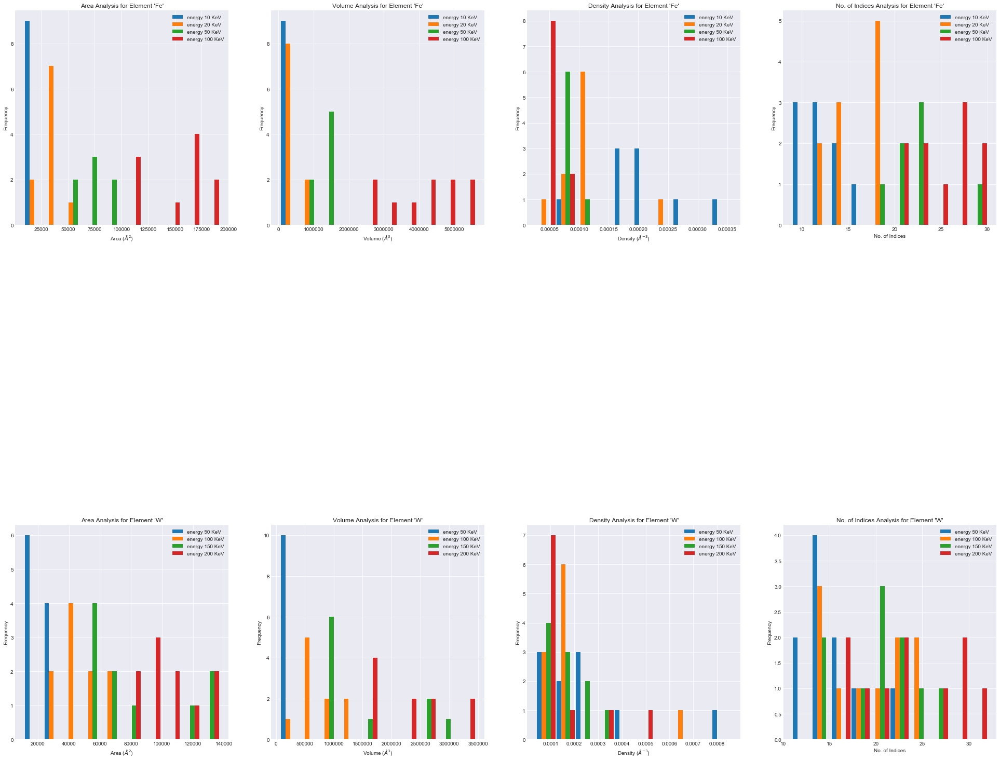

In [38]:
## Plots histograms for important geometric properties of hull (Area, Volume, Density, No. of Indices) acc. to Elements which are inturn acc. to Energies (each in different color) respectively
hist_plot_hull_features_acc_to_elements_and_energies_with_diff_colors()

#_Box Plots for imp. Hull Features (Area, Volume, Density & No. of Indices)_

In [39]:
## Plots box plots for important geometric properties of hull (Area, Volume, Density, No. of Indices) acc. to Elements which are inturn acc. to Energies (each in different color) respectively
box_plot_hull_features_acc_to_elements_energies()

***********BOX PLOTS FOR THE WHOLE DATA ACCORDING TO ELEMENTS -> ENERGIES (KeV) {EACH IN DIFFERENT COLOR}**********

   AREA, VOLUME, DENSITY & NO_OF_INDICES PLOTS ACCORDING TO ELEMENTS -> ENERGIES (KeV) {EACH IN DIFFERENT COLOR}   

                              ['Fe', 'W'] -> [[10, 20, 50, 100], [50, 100, 150, 200]]                              



### _Correlations_

Function Definitions

In [9]:
def get_3d_coords(dict_name, only_vacancies):
    coords_3d = []
    for cascade in dict_name['data']:
        if(only_vacancies == 1):
            a = [[c[0],c[1],c[2]] for c in cascade['coords'] if (c[3]==0 and c[5]==1)]
        else:
            a = [[c[0],c[1],c[2]] for c in cascade['coords']]
        coords_3d.append(a)
    return coords_3d



def show_warning(message): ## Used in add_hull_and_extra_features_to_dict function
    import tkinter as tk
    root = tk.Tk()
    root.title("WARNING")
    root.geometry("700x100+370+100")
    w = tk.Label(root, text=message)
    w. place(relx=0.0, rely=1.0, anchor='sw')
    w.pack()
    root.mainloop()
    
    
    
def dclust_coords_exists_or_not(filename): ## Used in add_hull_and_extra_features_to_dict function
    import json
    with open(filename, 'r') as f:
        dict_name = json.loads(f.read())
    for key in dict_name['data'][0].keys():
        if(key == 'dclust_coords'):
            return 1
    return 0


area_array=[]
volume_array=[]
density_array=[]
no_of_indices_array=[]
subcascades_count_array=[]
energies=[]
elements=[]
def add_hull_and_extra_features_to_dict(filename): ## Used in get_data function ## ALWAYS EXECUTE THIS FUNCTION (IMP. PREREQUISITE) 
    import json
    import numpy as np
    from scipy.spatial import ConvexHull
    
    with open(filename, 'r') as f:
        dict_name = json.loads(f.read()) #data becomes a dictionary

    ## Checks whether file data contains 'dclust_coords' as key or not for subcascades_count key generation
    subcascade=dclust_coords_exists_or_not(filename)
    
    ## To get 3d coordinates of vacancies from dictionary
    coords_3d = get_3d_coords(dict_name,1)
    for i,cascade in enumerate(dict_name['data']):
        ## Points type-casting
        pts = np.array(coords_3d[i], np.float)
        if (len(pts) < 4):
            ## Shows warning if points in a cascade are < 4
            show_warning("Number of points in cascade "+str(i)+" is less than 4.\nSo, kindly don't run plotting function calls for this cascade as it will rise an error.")
            cascade['hull_vertices'] = 0
            cascade['hull_simplices'] = [ch.simplices.tolist()]
            cascade['hull_nvertices'] = 0
            cascade['hull_nsimplices'] = 0
            cascade['hull_neighbors'] = [ch.neighbors.tolist()]
            #cascade['hull_max_bound'] = ch.max_bound.tolist()
            #cascade['hull_min_bound'] = ch.min_bound.tolist()
            cascade['hull_area'] = 0.0
            cascade['hull_volume'] = 0.0
            cascade['hull_density'] = 0.0
            cascade['hull_no_of_indices']=0
            ## Checks whether file data contains 'dclust_coords' as key or not for subcascades_count key generation
            if(subcascade==1):
                cascade['subcascades_count']=len(dict_name['data'][i]['dclust_coords'].keys())
        else:
            ## Convex hull generation
            ch = ConvexHull(pts)
            cascade['hull_vertices'] = ch.vertices.tolist()
            cascade['hull_simplices'] = ch.simplices.tolist()
            cascade['hull_nvertices'] = len(ch.vertices)
            cascade['hull_nsimplices'] = ch.nsimplex
            cascade['hull_neighbors'] = ch.neighbors.tolist()
            #cascade['hull_max_bound'] = ch.max_bound.tolist()
            #cascade['hull_min_bound'] = ch.min_bound.tolist()
            cascade['hull_area'] =ch.area
            cascade['hull_volume'] = ch.volume
            cascade['hull_density'] = dict_name['data'][i]['n_defects']/ch.volume
            cascade['hull_no_of_indices']=len(ch.vertices)
            ## Checks whether file data contains 'dclust_coords' as key or not for subcascades_count key generation
            if(subcascade==1):
                cascade['subcascades_count']=len(dict_name['data'][i]['dclust_coords'].keys())
                
    ## To make changes to original file
    with open(filename, 'w') as f:
        f.write(json.dumps(dict_name, indent=4, separators=(',', ': ')))
    
    
    ## To create arrays which are helpful in plotting
    for i,cascade in enumerate(dict_name['data']):
        ## Area array generation
        area_array.append(cascade['hull_area'])

        ## Volume array generation
        volume_array.append(cascade['hull_volume'])

        ## Density array generation
        density_array.append(cascade['hull_density'])

        ## Hull indices generation
        no_of_indices_array.append(cascade['hull_no_of_indices'])
        
        ## Subcascades count array generation
        ## Checks whether file data contains 'dclust_coords' as key or not for subcascades_count key generation
        if(subcascade==1):
            subcascades_count_array.append(cascade['subcascades_count'])
                
        ## Energy array generation
        energies.append(cascade['energy'])
        
        ## Element array generation
        elements.append(cascade['substrate'])
        
            
    ## Areas of all cascades
    #print("Areas")
    #print(area_array)
    #print(len(area_array))
    #print()

    ## Volumes of all cascades
    #print("Volumes")
    #print(volume_array)
    #print(len(volume_array))
    #print()

    ## Densities of all cascades
    #print("Densities")
    #print(density_array)
    #print(len(density_array))
    #print()

    ## No. of indices of all cascades 
    #print("No. of indices")
    #print(len(no_of_indices_array))
    #print(no_of_indices_array)
    #print()
    
    ## Subcascades of all cascades ## To print subcascades remove comments for below 8 lines
    #count=0
    #for val in subcascades_count_array:
        #if(val==0):
            #count=count+1
    #if(count!=len(subcascades_count_array)):
        #print("Subcascades")
        #print(len(subcascades_count_array))
        #print(subcascades_count_array)
        #print()
        
    ## Energies of all cascades
    #print("Energies")
    #print(energies)
    #print(len(energies))
    #print()
    
    ## Elements of all cascades
    #print("Elements")
    #print(elements)
    #print(len(elements))
    #print()



def get_data(filename): 
    ## Adds extra features to file for more flexibility in coding
    ## Input/s = data file
    add_hull_and_extra_features_to_dict(filename)
    
    import json
    from pathlib import Path
    
    fname = filename
    out_fname = Path(fname).stem + ".js"
    f = open(fname, "r+")
    cascades = json.load(f)
    f.close()
    return cascades


    
def csv_file_generation_from_the_given_data_file(file_name): ## Used by find_correlation function & correlation_scatter_matrix_plot function
    ## To get data from json file and store as dictionary  'cascadesf'
    dict_name = get_data(file_name)
    
    ## Creates a list of all imp. features from file, which is to be placed as attributes/columns in the csv file 
    list=[]
    headings=["area","volume","density","no_of_indices","energy","subcascades_count","n_defects"]
    list.append(headings)
    for i in range(0,len(dict_name["data"])):
        row=[dict_name["data"][i]["hull_area"],dict_name["data"][i]["hull_volume"],dict_name["data"][i]["hull_density"],dict_name["data"][i]["hull_no_of_indices"],dict_name["data"][i]["energy"],dict_name["data"][i]["subcascades_count"],dict_name["data"][i]["n_defects"]]
        list.append(row)
    #print(len(list))

    ## Creation of csv file
    import csv
    from pathlib import Path
    
    csv_file = Path(file_name).stem + ".csv"
    with open(csv_file, 'w') as csvFile:
        writer = csv.writer(csvFile)
        for i in range(0, len(list)):
            writer.writerow(list[i])

    csvFile.close()
    return csv_file
    
    
    
def find_correlation(file_name): 
    import numpy as np
    import pandas as pd
    %matplotlib inline
    import matplotlib.pyplot as plt

    ## Generates a csv file from given data file (json)
    ## Input/s = data file
    csv_file_name = csv_file_generation_from_the_given_data_file(file_name)

    data = pd.read_csv(csv_file_name)
    ## For plotting correlation matrix graph
    #print(data.head()) ## To print first 5 rows
    corr = data.corr()
    fig = plt.figure()
    ax = fig.add_subplot(111)
    cax = ax.matshow(corr,cmap='coolwarm', vmin=-1, vmax=1)
    fig.colorbar(cax)
    ticks = np.arange(0,len(data.columns),1)
    ax.set_xticks(ticks)
    plt.xticks(rotation=90)
    ax.set_yticks(ticks)
    ax.set_xticklabels(data.columns)
    ax.set_yticklabels(data.columns)
    plt.show()

    return data



def correlation_scatter_matrix_plot(file_name):
    from pandas.plotting import scatter_matrix
    import pandas as pd
    %matplotlib inline
    import matplotlib.pyplot as plt
    
    ## Generates a csv file from given data file (json)
    ## Input/s = data file
    csv_file_name = csv_file_generation_from_the_given_data_file(file_name)

    data = pd.read_csv(csv_file_name)
    
    ## Plotting scatter matrix plot
    pd.plotting.scatter_matrix(data, alpha=0.3, figsize=(20, 20),diagonal='kde')
    plt.tight_layout()
    
    
    
def scatter_matrix_plot_acc_to_energies():   
    ## Creates a list of unique energies from global variable energies ##Used in warning
    unique_energy_list = list(dict.fromkeys(energies))
    unique_energy_list.sort() ## To sort the list in ASC order
    #print(unique_energy_list)

    ## Shows warning if no. of unique energies are > 10
    if(len(unique_energy_list)>10):
        show_warning("Number of unique energies for all elements together is > 10. Therefore, kindly add more colors to the colors list in the function you called (colors variable is present just above plotting section) for correct results, as we have only 10 colors in the list.")

    colors=['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf']

    colors_arr_acc_to_energies_arr=[]
    for energy in energies:
        for i,unique_energy in enumerate(unique_energy_list):
            if(energy == unique_energy):
                colors_arr_acc_to_energies_arr.append(colors[i])
    #print(len(colors_arr_acc_to_energies_arr))
    #print(colors_arr_acc_to_energies_arr)

    ## n_defects_array_generation
    n_defects_arr=[]
    for i in range(0, len(cascadesf["data"])):
        n_defects_arr.append(cascadesf["data"][i]["n_defects"])
    #print(len(n_defects_arr))
    #print(n_defects_arr)

    ## Plotting

    ## Import dependencies for plotting
    from plotly import tools
    import plotly
    import plotly.graph_objs as go

    ## Configure Plotly to be rendered inline in the notebook.
    plotly.offline.init_notebook_mode()

    string = "SCATTER MATRIX PLOT OF THE DATA ACCORDING ENERGIES (KeV) {EACH IN DIFFERENT COLOR}"
    print(string.center(115,"*"))
    print()
    string=str(unique_energy_list)
    print(string.center(115))
    print()

    data=[]
    for i,unique_energy in enumerate(unique_energy_list):
        trace = go.Scatter(x=[None], y=[None], mode='markers', marker=dict(size=50, color=colors[i]), showlegend=True, name='energy '+str(unique_energy)+' KeV')
        data.append(trace)

    layout = go.Layout(
        xaxis=dict(
            showgrid=False,
            showline=False,
            showticklabels=False,
            zeroline=False
        ),
        yaxis=dict(
            showgrid=False,
            showline=False,
            showticklabels=False,
            zeroline=False
        ),
    )
    fig0 = go.Figure(data=data, layout=layout)
    plotly.offline.iplot(fig0)



    trace1 = go.Scatter(
        x = volume_array,
        y = area_array,
        legendgroup = 'a',
        mode='markers',
        marker=dict(
            size=16,
            color = colors_arr_acc_to_energies_arr, 
        )
    )

    trace2 = go.Scatter(
        x = density_array,
        y = area_array,
        mode='markers',
        marker=dict(
            size=16,
            color = colors_arr_acc_to_energies_arr, 
        )
    )

    trace3 = go.Scatter(
        x = no_of_indices_array,
        y = area_array,
        mode='markers',
        marker=dict(
            size=16,
            color = colors_arr_acc_to_energies_arr, 
        )
    )

    trace4 = go.Scatter(
        x = energies,
        y = area_array,
        mode='markers',
        marker=dict(
            size=16,
            color = colors_arr_acc_to_energies_arr, 
        )
    )

    trace5 = go.Scatter(
        x = subcascades_count_array,
        y = area_array,
        mode='markers',
        marker=dict(
            size=16,
            color = colors_arr_acc_to_energies_arr, 
        )
    )
    trace6 = go.Scatter(
        x = n_defects_arr,
        y = area_array,
        mode='markers',
        marker=dict(
            size=16,
            color = colors_arr_acc_to_energies_arr, 
        )
    )


    trace7 = go.Scatter(
        x = density_array,
        y = volume_array,
        mode='markers',
        marker=dict(
            size=16,
            color = colors_arr_acc_to_energies_arr, 
        )
    )

    trace8 = go.Scatter(
        x = no_of_indices_array,
        y = volume_array,
        mode='markers',
        marker=dict(
            size=16,
            color = colors_arr_acc_to_energies_arr, 
        )
    )

    trace9 = go.Scatter(
        x = energies,
        y = volume_array,
        mode='markers',
        marker=dict(
            size=16,
            color = colors_arr_acc_to_energies_arr, 
        )
    )

    trace10 = go.Scatter(
        x = subcascades_count_array,
        y = volume_array,
        mode='markers',
        marker=dict(
            size=16,
            color = colors_arr_acc_to_energies_arr, 
        )
    )
    trace11 = go.Scatter(
        x = n_defects_arr,
        y = volume_array,
        mode='markers',
        marker=dict(
            size=16,
            color = colors_arr_acc_to_energies_arr, 
        )
    )


    trace12 = go.Scatter(
        x = no_of_indices_array,
        y = density_array,
        mode='markers',
        marker=dict(
            size=16,
            color = colors_arr_acc_to_energies_arr, 
        )
    )

    trace13 = go.Scatter(
        x = energies,
        y = density_array,
        mode='markers',
        marker=dict(
            size=16,
            color = colors_arr_acc_to_energies_arr, 
        )
    )

    trace14 = go.Scatter(
        x = subcascades_count_array,
        y = density_array,
        mode='markers',
        marker=dict(
            size=16,
            color = colors_arr_acc_to_energies_arr, 
        )
    )
    trace15 = go.Scatter(
        x = n_defects_arr,
        y = density_array,
        mode='markers',
        marker=dict(
            size=16,
            color = colors_arr_acc_to_energies_arr, 
        )
    )


    trace16 = go.Scatter(
        x = energies,
        y = no_of_indices_array,
        mode='markers',
        marker=dict(
            size=16,
            color = colors_arr_acc_to_energies_arr, 
        )
    )

    trace17 = go.Scatter(
        x = subcascades_count_array,
        y = no_of_indices_array,
        mode='markers',
        marker=dict(
            size=16,
            color = colors_arr_acc_to_energies_arr, 
        )
    )
    trace18 = go.Scatter(
        x = n_defects_arr,
        y = no_of_indices_array,
        mode='markers',
        marker=dict(
            size=16,
            color = colors_arr_acc_to_energies_arr, 
        )
    )


    trace19 = go.Scatter(
        x = subcascades_count_array,
        y = energies,
        mode='markers',
        marker=dict(
            size=16,
            color = colors_arr_acc_to_energies_arr, 
        )
    )
    trace20 = go.Scatter(
        x = n_defects_arr,
        y = energies,
        mode='markers',
        marker=dict(
            size=16,
            color = colors_arr_acc_to_energies_arr, 
        )
    )

    
    trace21 = go.Scatter(
        x = n_defects_arr,
        y = subcascades_count_array,
        mode='markers',
        marker=dict(
            size=16,
            color = colors_arr_acc_to_energies_arr, 
        )
    )

    fig1 = tools.make_subplots(rows=1, cols=6, print_grid=False, shared_yaxes=True)

    fig1.append_trace(trace1, 1, 1)
    fig1.append_trace(trace2, 1, 2)
    fig1.append_trace(trace3, 1, 3)
    fig1.append_trace(trace4, 1, 4)
    fig1.append_trace(trace5, 1, 5)
    fig1.append_trace(trace6, 1, 6)

    fig1['layout']['xaxis1'].update(title=r'$\text{Volume } ('u'\u212B^3)$', exponentformat="E")
    fig1['layout']['xaxis2'].update(title=r'$\text{Density } ('u'\u212B^{-3})$', exponentformat="E")
    fig1['layout']['xaxis3'].update(title=r'$\text{No. of Indices}$', exponentformat="E")
    fig1['layout']['xaxis4'].update(title=r'$\text{Energy (KeV)}$', exponentformat="E")
    fig1['layout']['xaxis5'].update(title=r'$\text{No. of Subcascades}$', exponentformat="E")
    fig1['layout']['xaxis6'].update(title=r'$\text{No. of Defects}$', exponentformat="E") 

    fig1['layout']['yaxis1'].update(title=r'$\text{Area } ('u'\u212B^2)$', exponentformat="E")

    fig1['layout'].update(title='Scatter Matrix according to Energies')
    fig1['layout']['title'].y=0.98
    fig1['layout'].showlegend=False

    plotly.offline.iplot(fig1)


    fig2 = tools.make_subplots(rows=1, cols=5, print_grid=False, shared_yaxes=True)

    fig2.append_trace(trace7, 1, 1)
    fig2.append_trace(trace8, 1, 2)
    fig2.append_trace(trace9, 1, 3)
    fig2.append_trace(trace10, 1, 4)
    fig2.append_trace(trace11, 1, 5)

    fig2['layout']['xaxis1'].update(title=r'$\text{Density } ('u'\u212B^{-3})$', exponentformat="E")
    fig2['layout']['xaxis2'].update(title=r'$\text{No. of Indices}$', exponentformat="E")
    fig2['layout']['xaxis3'].update(title=r'$\text{Energy (KeV)}$', exponentformat="E")
    fig2['layout']['xaxis4'].update(title=r'$\text{No. of Subcascades}$', exponentformat="E")
    fig2['layout']['xaxis5'].update(title=r'$\text{No. of Defects}$', exponentformat="E") 

    fig2['layout']['yaxis1'].update(title=r'$\text{Volume } ('u'\u212B^3)$', exponentformat="E")

    fig2['layout'].showlegend=False

    plotly.offline.iplot(fig2)


    fig3 = tools.make_subplots(rows=1, cols=4, print_grid=False, shared_yaxes=True)

    fig3.append_trace(trace12, 1, 1)
    fig3.append_trace(trace13, 1, 2)
    fig3.append_trace(trace14, 1, 3)
    fig3.append_trace(trace15, 1, 4)

    fig3['layout']['xaxis1'].update(title=r'$\text{No. of Indices}$', exponentformat="E")
    fig3['layout']['xaxis2'].update(title=r'$\text{Energy (KeV)}$', exponentformat="E")
    fig3['layout']['xaxis3'].update(title=r'$\text{No. of Subcascades}$', exponentformat="E")
    fig3['layout']['xaxis4'].update(title=r'$\text{No. of Defects}$', exponentformat="E") 

    fig3['layout']['yaxis1'].update(title=r'$\text{Density } ('u'\u212B^{-3})$', exponentformat="E")

    fig3['layout'].showlegend=False

    plotly.offline.iplot(fig3)
    

    fig4 = tools.make_subplots(rows=1, cols=3, print_grid=False, shared_yaxes=True)

    fig4.append_trace(trace16, 1, 1)
    fig4.append_trace(trace17, 1, 2)
    fig4.append_trace(trace18, 1, 3)

    fig4['layout']['xaxis1'].update(title=r'$\text{Energy (KeV)}$', exponentformat="E")
    fig4['layout']['xaxis2'].update(title=r'$\text{No. of Subcascades}$', exponentformat="E")
    fig4['layout']['xaxis3'].update(title=r'$\text{No. of Defects}$', exponentformat="E") 

    fig4['layout']['yaxis1'].update(title=r'$\text{No. of Indices}$', exponentformat="E")

    fig4['layout'].showlegend=False

    plotly.offline.iplot(fig4)


    fig5 = tools.make_subplots(rows=1, cols=2, print_grid=False, shared_yaxes=True)

    fig5.append_trace(trace19, 1, 1)
    fig5.append_trace(trace20, 1, 2)

    fig5['layout']['xaxis1'].update(title=r'$\text{No. of Subcascades}$', exponentformat="E")
    fig5['layout']['xaxis2'].update(title=r'$\text{No. of Defects}$', exponentformat="E") 

    fig5['layout']['yaxis1'].update(title=r'$\text{Energy (KeV)}$', exponentformat="E")

    fig5['layout'].showlegend=False

    plotly.offline.iplot(fig5)


    fig6 = tools.make_subplots(rows=1, cols=1, print_grid=False, shared_yaxes=True)

    fig6.append_trace(trace21, 1, 1)

    fig6['layout']['xaxis1'].update(title=r'$\text{No. of Defects}$', exponentformat="E") 

    fig6['layout']['yaxis1'].update(title=r'$\text{No. of Subcascades}$', exponentformat="E")

    fig6['layout'].showlegend=False

    plotly.offline.iplot(fig6)

    
    
def scatter_matrix_plot_acc_to_elements_energies():
    ## Creates a list of unique elements from global variable elements
    unique_element_list = list(dict.fromkeys(elements))
    unique_element_list.sort() ## To sort the list in ASC order
    #print(unique_element_list)

    ## Creates a list of unique energies from global variable energies ##Used in warning
    unique_energy_list = list(dict.fromkeys(energies))
    unique_energy_list.sort() ## To sort the list in ASC order
    #print(unique_energy_list)

    ## Creates an array list of energies acc. to unique_element_list
    sorted_energies_acc_to_sorted_elements=[]
    for ele in unique_element_list:
        enr_list=[]
        for i,elem in enumerate(elements):
            if(elem==ele):
                enr_list.append(energies[i])
        enr_list = list(dict.fromkeys(enr_list))
        enr_list.sort()  ## To sort the list in ASC order
        sorted_energies_acc_to_sorted_elements.append(enr_list)    
    #print(sorted_energies_acc_to_sorted_elements)

    ## Creates a dict to store feature vals acc. to diff elements - Try printting for better understanding 
    ## The lists in feature (ex: areas) key is acc. to unique_element_list
    ## Abv. mentioned list contains again a list of energies acc. to feature and element respectively
    list_feature_element={}
    list_feature_element['areas']=[]
    list_feature_element['vols']=[]
    list_feature_element['densities']=[]
    list_feature_element['no_of_indices']=[]
    list_feature_element['energies']=[]
    list_feature_element['no_of_subcascades']=[]
    list_feature_element['no_of_defects']=[]
    ## Feature key contains a list of elements which is inturn a list of energies acc. to elements' index in unique_element_list respectively
    for feature in list_feature_element:
        for i,element in enumerate(unique_element_list):
            list_feature_element[feature].append(unique_element_list[i])
    #print(list_feature_element)

    ## n_defects_generation
    n_defects_arr=[]
    for i in range(0, len(cascadesf["data"])):
        n_defects_arr.append(cascadesf["data"][i]["n_defects"])
    #print(len(n_defects_arr))
    #print(n_defects_arr)


    ## Shows warning if no. of unique energies are > 10
    if(len(unique_energy_list)>10):
        show_warning("Number of unique energies for all elements together is > 10. Therefore, kindly add more colors to the colors list in the function you called (colors variable is present just above plotting section) for correct results, as we have only 10 colors in the list.")

    colors=['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf']


    ## Plotting

    ## Import dependencies for plotting
    from plotly import tools
    import plotly
    import plotly.graph_objs as go

    ## Configure Plotly to be rendered inline in the notebook.
    plotly.offline.init_notebook_mode()

    string = "SCATTER MATRIX PLOT OF THE DATA ACCORDING ELEMENTS --> ENERGIES (KeV) {EACH IN DIFFERENT COLOR}"
    print(string.center(115,"*"))
    print()

    string=str(unique_element_list)+' --> '+str(sorted_energies_acc_to_sorted_elements)
    print(string.center(115))
    print()


    for i,ele in enumerate(unique_element_list):
        data=[]
        for unique_energy_acc_element in sorted_energies_acc_to_sorted_elements[i]:
            for j,unique_energy in enumerate(unique_energy_list):
                if(unique_energy == unique_energy_acc_element):
                    trace = go.Scatter(x=[None], y=[None], mode='markers', marker=dict(size=50, color=colors[j]), showlegend=True, name=str(ele)+'_'+str(unique_energy_acc_element)+'(KeV)')
                    data.append(trace)

        layout = go.Layout(
            xaxis=dict(
                showgrid=False,
                showline=False,
                showticklabels=False,
                zeroline=False
            ),
            yaxis=dict(
                showgrid=False,
                showline=False,
                showticklabels=False,
                zeroline=False
            ),
        )
        fig0 = go.Figure(data=data, layout=layout)
        plotly.offline.iplot(fig0)

        area_vals_for_ele=[]
        vol_vals_for_ele=[]
        density_vals_for_ele=[]
        no_of_indices_vals_for_ele=[]
        energies_vals_for_ele=[]
        subcascades_vals_for_ele=[]
        n_defects_vals_for_ele=[]

        for feature in list_feature_element:
            for k in range(0, len(elements)):
                if(elements[k]==ele):
                    if(feature=='areas'):
                        area_vals_for_ele.append(area_array[k])
                    if(feature=='vols'):
                        vol_vals_for_ele.append(volume_array[k])
                    if(feature=='densities'):
                        density_vals_for_ele.append(density_array[k])
                    if(feature=='no_of_indices'):
                        no_of_indices_vals_for_ele.append(no_of_indices_array[k])
                    if(feature=='energies'):
                        energies_vals_for_ele.append(energies[k])
                    if(feature=='no_of_subcascades'):
                        subcascades_vals_for_ele.append(subcascades_count_array[k])
                    if(feature=='no_of_defects'):
                        n_defects_vals_for_ele.append(n_defects_arr[k])

        #print(area_vals_for_ele)
        #print(vol_vals_for_ele)
        #print(density_vals_for_ele)
        #print(no_of_indices_vals_for_ele)
        #print(energies_vals_for_ele)
        #print(subcascades_vals_for_ele)
        #print(n_defects_vals_for_ele)

        colors_arr_acc_to_element_energies_arr=[]
        for energy in energies_vals_for_ele:
            for j,unique_energy in enumerate(unique_energy_list):
                if(unique_energy == energy):
                    colors_arr_acc_to_element_energies_arr.append(colors[j])
        #print(len(colors_arr_acc_to_element_energies_arr))
        #print(colors_arr_acc_to_element_energies_arr)

        trace1 = go.Scatter(
            x = vol_vals_for_ele,
            y = area_vals_for_ele,
            legendgroup = 'a',
            mode='markers',
            marker=dict(
                size=16,
                color = colors_arr_acc_to_element_energies_arr, 
            )
        )

        trace2 = go.Scatter(
            x = density_vals_for_ele,
            y = area_vals_for_ele,
            mode='markers',
            marker=dict(
                size=16,
                color = colors_arr_acc_to_element_energies_arr, 
            )
        )

        trace3 = go.Scatter(
            x = no_of_indices_vals_for_ele,
            y = area_vals_for_ele,
            mode='markers',
            marker=dict(
                size=16,
                color = colors_arr_acc_to_element_energies_arr, 
            )
        )

        trace4 = go.Scatter(
            x = energies_vals_for_ele,
            y = area_vals_for_ele,
            mode='markers',
            marker=dict(
                size=16,
                color = colors_arr_acc_to_element_energies_arr, 
            )
        )

        trace5 = go.Scatter(
            x = subcascades_vals_for_ele,
            y = area_vals_for_ele,
            mode='markers',
            marker=dict(
                size=16,
                color = colors_arr_acc_to_element_energies_arr, 
            )
        )
        trace6 = go.Scatter(
            x = n_defects_vals_for_ele,
            y = area_vals_for_ele,
            mode='markers',
            marker=dict(
                size=16,
                color = colors_arr_acc_to_element_energies_arr, 
            )
        )


        trace7 = go.Scatter(
            x = density_vals_for_ele,
            y = vol_vals_for_ele,
            mode='markers',
            marker=dict(
                size=16,
                color = colors_arr_acc_to_element_energies_arr, 
            )
        )

        trace8 = go.Scatter(
            x = no_of_indices_vals_for_ele,
            y = vol_vals_for_ele,
            mode='markers',
            marker=dict(
                size=16,
                color = colors_arr_acc_to_element_energies_arr, 
            )
        )

        trace9 = go.Scatter(
            x = energies_vals_for_ele,
            y = vol_vals_for_ele,
            mode='markers',
            marker=dict(
                size=16,
                color = colors_arr_acc_to_element_energies_arr, 
            )
        )

        trace10 = go.Scatter(
            x = subcascades_vals_for_ele,
            y = vol_vals_for_ele,
            mode='markers',
            marker=dict(
                size=16,
                color = colors_arr_acc_to_element_energies_arr, 
            )
        )
        trace11 = go.Scatter(
            x = n_defects_vals_for_ele,
            y = vol_vals_for_ele,
            mode='markers',
            marker=dict(
                size=16,
                color = colors_arr_acc_to_element_energies_arr, 
            )
        )


        trace12 = go.Scatter(
            x = no_of_indices_vals_for_ele,
            y = density_vals_for_ele,
            mode='markers',
            marker=dict(
                size=16,
                color = colors_arr_acc_to_element_energies_arr, 
            )
        )

        trace13 = go.Scatter(
            x = energies_vals_for_ele,
            y = density_vals_for_ele,
            mode='markers',
            marker=dict(
                size=16,
                color = colors_arr_acc_to_element_energies_arr, 
            )
        )

        trace14 = go.Scatter(
            x = subcascades_vals_for_ele,
            y = density_vals_for_ele,
            mode='markers',
            marker=dict(
                size=16,
                color = colors_arr_acc_to_element_energies_arr, 
            )
        )
        trace15 = go.Scatter(
            x = n_defects_vals_for_ele,
            y = density_vals_for_ele,
            mode='markers',
            marker=dict(
                size=16,
                color = colors_arr_acc_to_element_energies_arr, 
            )
        )


        trace16 = go.Scatter(
            x = energies_vals_for_ele,
            y = no_of_indices_vals_for_ele,
            mode='markers',
            marker=dict(
                size=16,
                color = colors_arr_acc_to_element_energies_arr, 
            )
        )

        trace17 = go.Scatter(
            x = subcascades_vals_for_ele,
            y = no_of_indices_vals_for_ele,
            mode='markers',
            marker=dict(
                size=16,
                color = colors_arr_acc_to_element_energies_arr, 
            )
        )
        trace18 = go.Scatter(
            x = n_defects_vals_for_ele,
            y = no_of_indices_vals_for_ele,
            mode='markers',
            marker=dict(
                size=16,
                color = colors_arr_acc_to_element_energies_arr, 
            )
        )


        trace19 = go.Scatter(
            x = subcascades_vals_for_ele,
            y = energies_vals_for_ele,
            mode='markers',
            marker=dict(
                size=16,
                color = colors_arr_acc_to_element_energies_arr, 
            )
        )
        trace20 = go.Scatter(
            x = n_defects_vals_for_ele,
            y = energies_vals_for_ele,
            mode='markers',
            marker=dict(
                size=16,
                color = colors_arr_acc_to_element_energies_arr, 
            )
        )


        trace21 = go.Scatter(
            x = n_defects_vals_for_ele,
            y = subcascades_vals_for_ele,
            mode='markers',
            marker=dict(
                size=16,
                color = colors_arr_acc_to_element_energies_arr, 
            )
        )

        fig1 = tools.make_subplots(rows=1, cols=6, print_grid=False, shared_yaxes=True)

        fig1.append_trace(trace1, 1, 1)
        fig1.append_trace(trace2, 1, 2)
        fig1.append_trace(trace3, 1, 3)
        fig1.append_trace(trace4, 1, 4)
        fig1.append_trace(trace5, 1, 5)
        fig1.append_trace(trace6, 1, 6)

        fig1['layout']['xaxis1'].update(title=r'$\text{Volume } ('u'\u212B^3)$', exponentformat="E")
        fig1['layout']['xaxis2'].update(title=r'$\text{Density } ('u'\u212B^{-3})$', exponentformat="E")
        fig1['layout']['xaxis3'].update(title=r'$\text{No. of Indices}$', exponentformat="E")
        fig1['layout']['xaxis4'].update(title=r'$\text{Energy (KeV)}$', exponentformat="E")
        fig1['layout']['xaxis5'].update(title=r'$\text{No. of Subcascades}$', exponentformat="E")
        fig1['layout']['xaxis6'].update(title=r'$\text{No. of Defects}$', exponentformat="E") 

        fig1['layout']['yaxis1'].update(title=r'$\text{Area } ('u'\u212B^2)$', exponentformat="E")

        fig1['layout'].update(title="Scatter Matrix of to Element '"+str(ele)+"' according to Energies")
        fig1['layout']['title'].y=0.98
        fig1['layout'].showlegend=False

        plotly.offline.iplot(fig1)


        fig2 = tools.make_subplots(rows=1, cols=5, print_grid=False, shared_yaxes=True)

        fig2.append_trace(trace7, 1, 1)
        fig2.append_trace(trace8, 1, 2)
        fig2.append_trace(trace9, 1, 3)
        fig2.append_trace(trace10, 1, 4)
        fig2.append_trace(trace11, 1, 5)

        fig2['layout']['xaxis1'].update(title=r'$\text{Density } ('u'\u212B^{-3})$', exponentformat="E")
        fig2['layout']['xaxis2'].update(title=r'$\text{No. of Indices}$', exponentformat="E")
        fig2['layout']['xaxis3'].update(title=r'$\text{Energy (KeV)}$', exponentformat="E")
        fig2['layout']['xaxis4'].update(title=r'$\text{No. of Subcascades}$', exponentformat="E")
        fig2['layout']['xaxis5'].update(title=r'$\text{No. of Defects}$', exponentformat="E") 

        fig2['layout']['yaxis1'].update(title=r'$\text{Volume } ('u'\u212B^3)$', exponentformat="E")

        fig2['layout'].showlegend=False

        plotly.offline.iplot(fig2)


        fig3 = tools.make_subplots(rows=1, cols=4, print_grid=False, shared_yaxes=True)

        fig3.append_trace(trace12, 1, 1)
        fig3.append_trace(trace13, 1, 2)
        fig3.append_trace(trace14, 1, 3)
        fig3.append_trace(trace15, 1, 4)

        fig3['layout']['xaxis1'].update(title=r'$\text{No. of Indices}$', exponentformat="E")
        fig3['layout']['xaxis2'].update(title=r'$\text{Energy (KeV)}$', exponentformat="E")
        fig3['layout']['xaxis3'].update(title=r'$\text{No. of Subcascades}$', exponentformat="E")
        fig3['layout']['xaxis4'].update(title=r'$\text{No. of Defects}$', exponentformat="E") 

        fig3['layout']['yaxis1'].update(title=r'$\text{Density } ('u'\u212B^{-3})$',exponentformat="E")

        fig3['layout'].showlegend=False

        plotly.offline.iplot(fig3)


        fig4 = tools.make_subplots(rows=1, cols=3, print_grid=False, shared_yaxes=True)

        fig4.append_trace(trace16, 1, 1)
        fig4.append_trace(trace17, 1, 2)
        fig4.append_trace(trace18, 1, 3)

        fig4['layout']['xaxis1'].update(title=r'$\text{Energy (KeV)}$', exponentformat="E")
        fig4['layout']['xaxis2'].update(title=r'$\text{No. of Subcascades}$', exponentformat="E")
        fig4['layout']['xaxis3'].update(title=r'$\text{No. of Defects}$', exponentformat="E") 

        fig4['layout']['yaxis1'].update(title=r'$\text{No. of Indices}$', exponentformat="E")

        fig4['layout'].showlegend=False

        plotly.offline.iplot(fig4)


        fig5 = tools.make_subplots(rows=1, cols=2, print_grid=False, shared_yaxes=True)

        fig5.append_trace(trace19, 1, 1)
        fig5.append_trace(trace20, 1, 2)

        fig5['layout']['xaxis1'].update(title=r'$\text{No. of Subcascades}$', exponentformat="E")
        fig5['layout']['xaxis2'].update(title=r'$\text{No. of Defects}$', exponentformat="E") 

        fig5['layout']['yaxis1'].update(title=r'$\text{Energy (KeV)}$', exponentformat="E")

        fig5['layout'].showlegend=False

        plotly.offline.iplot(fig5)


        fig6 = tools.make_subplots(rows=1, cols=1, print_grid=False, shared_yaxes=True)

        fig6.append_trace(trace21, 1, 1)

        fig6['layout']['xaxis1'].update(title=r'$\text{No. of Defects}$', exponentformat="E") 

        fig6['layout']['yaxis1'].update(title=r'$\text{No. of Subcascades}$', exponentformat="E")

        fig6['layout'].showlegend=False

        plotly.offline.iplot(fig6)


    

Function Calls / User Code

#_To read file and get data_

In [10]:
## Must execute this function call as it is necessary for other calls (indirect interdependency) - COMPULSORY EXECUTION
## To get data from json file and store as dictionary  'cascadesf'
## Input/s = data file
cascadesf = get_data("cascades-data-full.json")


#_Correlation graph & table_

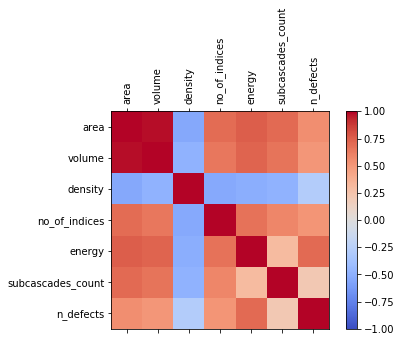

,area,volume,density,no_of_indices,energy,subcascades_count,n_defects
area,1.000000,0.977643,-0.546015,0.703123,0.752263,0.704934,0.547059
volume,0.977643,1.000000,-0.477247,0.656050,0.726845,0.670735,0.508359
density,-0.546015,-0.477247,1.000000,-0.535701,-0.507754,-0.482769,-0.274268
no_of_indices,0.703123,0.656050,-0.535701,1.000000,0.679026,0.593027,0.522234
energy,0.752263,0.726845,-0.507754,0.679026,1.000000,0.305458,0.706108
subcascades_count,0.704934,0.670735,-0.482769,0.593027,0.305458,1.000000,0.215770
n_defects,0.547059,0.508359,-0.274268,0.522234,0.706108,0.215770,1.000000


In [12]:
## Generates a correlation graph and table
## Input/s = data file
data = find_correlation("cascades-data-full.json")
## For correlation table
data.corr()

#_Correlation Scatter Matrix Graph in various ways_

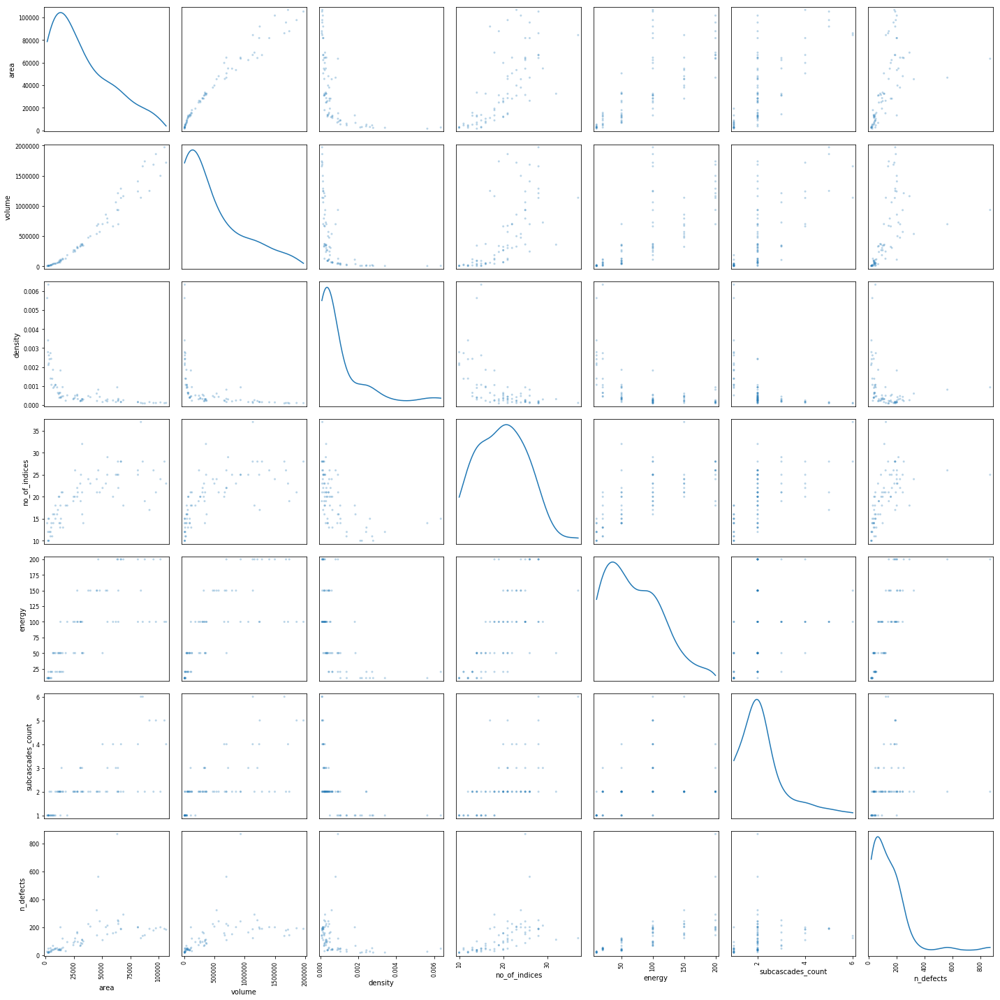

In [5]:
## Displays correlation scatter matrix plot
## Input/s = data file
data = correlation_scatter_matrix_plot("cascades-data-full.json")


In [12]:
## Plots scatter matrix plot of the data acc. to Energies (each in different color) respectively
scatter_matrix_plot_acc_to_energies()   

*****************SCATTER MATRIX PLOT OF THE DATA ACCORDING ENERGIES (KeV) {EACH IN DIFFERENT COLOR}****************

                                            [10, 20, 50, 100, 150, 200]                                            



In [24]:
## Plots scatter matrix plot of the data acc. to Elements which are inturn acc. to Energies (each in different color) respectively
scatter_matrix_plot_acc_to_elements_energies()

**********SCATTER MATRIX PLOT OF THE DATA ACCORDING ELEMENTS --> ENERGIES (KeV) {EACH IN DIFFERENT COLOR}**********

                              ['Fe', 'W'] --> [[10, 20, 50, 100], [50, 100, 150, 200]]                             



### Logistic Regression - Binary classification

Function Definitions

In [52]:
def get_3d_coords(dict_name, only_vacancies):
    coords_3d = []
    for cascade in dict_name['data']:
        if(only_vacancies == 1):
            a = [[c[0],c[1],c[2]] for c in cascade['coords'] if (c[3]==0 and c[5]==1)]
            #a = [[c[0],c[1],c[2]] for c in cascade['coords'] if (c[3]==0)]
            #a = [[c[0],c[1],c[2]] for c in cascade['coords']]
        else:
            a = [[c[0],c[1],c[2]] for c in cascade['coords']]
        coords_3d.append(a)
    return coords_3d



def show_warning(message): ## Used in add_hull_and_extra_features_to_dict function
    import tkinter as tk
    root = tk.Tk()
    root.title("WARNING")
    root.geometry("700x100+370+100")
    w = tk.Label(root, text=message)
    w. place(relx=0.0, rely=1.0, anchor='sw')
    w.pack()
    root.mainloop()
    
    
    
def dclust_coords_exists_or_not(filename): ## Used in add_hull_and_extra_features_to_dict function
    import json
    with open(filename, 'r') as f:
        dict_name = json.loads(f.read())
    for key in dict_name['data'][0].keys():
        if(key == 'dclust_coords'):
            return 1
    return 0



def add_hull_and_extra_features_to_dict(filename): ##ALWAYS EXECUTE THIS FUNCTION (IMP. PREREQUISITE) - DEPENDENT ABOVE FUNCTION (hull_indices_generation)
    import json
    import numpy as np
    from scipy.spatial import ConvexHull
    
    with open(filename, 'r') as f:
        dict_name = json.loads(f.read()) #data becomes a dictionary

    ## Checks whether file data contains 'dclust_coords' as key or not for subcascades_count key generation
    subcascade=dclust_coords_exists_or_not(filename)
    if(subcascade == 0):
        show_warning("The given file doesn't contains 'dclust_coords' as key for subcascades_count key generation.\nOr in other terms, it is necessary for the given file (json file) to contain 'dclust_coords' key to predict the no of subcascades.")
    
    ## To get 3d coordinates of vacancies from dictionary
    coords_3d = get_3d_coords(dict_name,1)
    for i,cascade in enumerate(dict_name['data']):
        ## Points type-casting
        pts = np.array(coords_3d[i], np.float)
        if (len(pts) < 4):
            ## Shows warning if points in a cascade are < 4
            show_warning("Number of points in cascade "+str(i)+" is less than 4.\nSo, kindly don't run plotting function calls for this cascade as it will rise an error.")
            cascade['hull_vertices'] = 0
            cascade['hull_simplices'] = [ch.simplices.tolist()]
            cascade['hull_nvertices'] = 0
            cascade['hull_nsimplices'] = 0
            cascade['hull_neighbors'] = [ch.neighbors.tolist()]
            #cascade['hull_max_bound'] = ch.max_bound.tolist()
            #cascade['hull_min_bound'] = ch.min_bound.tolist()
            cascade['hull_area'] = 0.0
            cascade['hull_volume'] = 0.0
            cascade['hull_density'] = 0.0
            cascade['hull_no_of_indices']=0
            ## Checks whether file data contains 'dclust_coords' as key or not for subcascades_count key generation
            if(subcascade==1):
                cascade['subcascades_count']=len(dict_name['data'][i]['dclust_coords'].keys())
            
        else:
            ## Convex hull generation
            ch = ConvexHull(pts)
            cascade['hull_vertices'] = ch.vertices.tolist()
            cascade['hull_simplices'] = ch.simplices.tolist()
            cascade['hull_nvertices'] = len(ch.vertices)
            cascade['hull_nsimplices'] = ch.nsimplex
            cascade['hull_neighbors'] = ch.neighbors.tolist()
            #cascade['hull_max_bound'] = ch.max_bound.tolist()
            #cascade['hull_min_bound'] = ch.min_bound.tolist()
            cascade['hull_area'] =ch.area
            cascade['hull_volume'] = ch.volume
            cascade['hull_density'] = dict_name['data'][i]['n_defects']/ch.volume
            cascade['hull_no_of_indices']=len(ch.vertices)
            ## Checks whether file data contains 'dclust_coords' as key or not for subcascades_count key generation
            if(subcascade==1):
                cascade['subcascades_count']=len(dict_name['data'][i]['dclust_coords'].keys())
                
    ## To make changes to original file
    with open(filename, 'w') as f:
        f.write(json.dumps(dict_name, indent=4, separators=(',', ': ')))
    
    
    
def get_data(filename): 
    ## Adds extra features to file for more flexibility in coding
    ## Input/s = data file
    add_hull_and_extra_features_to_dict(filename)
    
    import json
    from pathlib import Path
    
    fname = filename
    out_fname = Path(fname).stem + ".js"
    f = open(fname, "r+")
    cascades = json.load(f)
    f.close()
    return cascades



def csv_file_generation_from_the_given_data_file_for_BLR(file_name): ## Used by generate_and_read_csv_file function
    ## To get data from json file and store as dictionary  'cascades'
    ## Input/s = data file
    cascades = get_data(file_name)

    ## Multiple subcascades array generation. If >1 subcascades -> YES else N0
    multiple_subcascades=[]
    for i in range(0, len(cascades["data"])):
        if(cascades["data"][i]["subcascades_count"]==1):
            multiple_subcascades.append(0)
        else:
            multiple_subcascades.append(1) 
    #print(multiple_subcascades)

    ## List generation of all necessary columns & and its corresponding data for csv file generation
    list=[]
    headings=["area","volume","density","no_of_indices","energy","n_defects","multiple_subcascades"]
    list.append(headings)
    for i in range(0,len(cascades["data"])):
        row=[cascades["data"][i]["hull_area"], cascades["data"][i]["hull_volume"], cascades["data"][i]["hull_density"], cascades["data"][i]["hull_no_of_indices"], cascades["data"][i]["energy"], cascades["data"][i]["n_defects"], multiple_subcascades[i]]
        list.append(row)
    #print(len(list))

    ## Creates csv file from given file
    import csv
    from pathlib import Path
    csv_file_BLR = Path(file_name).stem + " (BLR).csv"
    with open(csv_file_BLR, 'w') as csvFile:
        writer = csv.writer(csvFile)
        for i in range(0, len(list)):
            writer.writerow(list[i])
    csvFile.close()
    return csv_file_BLR



def generate_and_read_csv_file(file_name):   
    import pandas as pd

    ## Generates csv file from given file (json) for Binary Logistic Regression
    csv_file_BLR = csv_file_generation_from_the_given_data_file_for_BLR(file_name)

    ## Read & display the first 5 lines of the csv file generated from the given file
    data=pd.read_csv(csv_file_BLR)
    return data



def plot_curve(X, y):
    import sklearn
    from sklearn.model_selection import StratifiedKFold, cross_val_score
    from sklearn.model_selection import train_test_split
    from sklearn.linear_model import LinearRegression
    from sklearn.model_selection import learning_curve, GridSearchCV, KFold
    %matplotlib inline
    import matplotlib.pyplot as plt
    from sklearn.metrics import explained_variance_score, make_scorer
    import numpy as np
    from matplotlib.lines import Line2D

    size = len(X)
    cv = KFold(size, shuffle=True)
    
    # instantiate
    lg = LinearRegression()

    # fit
    lg.fit(X, y)
    
    train_sizes, train_scores, test_scores = learning_curve(lg, X, y, n_jobs=-1, cv=cv, train_sizes=np.linspace(.1, 1.0, 5), verbose=0)

    train_scores_mean = np.mean(train_scores, axis=1)
    train_scores_std = np.std(train_scores, axis=1)
    test_scores_mean = np.mean(test_scores, axis=1)
    test_scores_std = np.std(test_scores, axis=1)
    
    legend_elements = [Line2D([0], [0], color='r', lw=4, label='Training score'), 
                       Line2D([0], [0], color='g', lw=4, label='"Cross-validation score')]
    
    plt.figure()
    plt.title("RandomForestClassifier")
    plt.legend(handles = legend_elements, loc="upper right", shadow=True)
    plt.xlabel("Training examples")
    plt.ylabel("Score")
    plt.gca().invert_yaxis()
    
    # box-like grid
    plt.grid()
    
    # plot the std deviation as a transparent range at each training set size
    plt.fill_between(train_sizes, train_scores_mean - train_scores_std, train_scores_mean + train_scores_std, alpha=0.1, color="r")
    plt.fill_between(train_sizes, test_scores_mean - test_scores_std, test_scores_mean + test_scores_std, alpha=0.1, color="g")
    
    # plot the average training and test score lines at each training set size
    plt.plot(train_sizes, train_scores_mean, 'o-', color="r");
    plt.plot(train_sizes, test_scores_mean, 'o-', color="g");
        
    # sizes the window for readability and displays the plot
    # shows error from 0 to 1.1
    plt.ylim(-.1,1.1)
    plt.show()



def BLR(data, test_size, want_training_accuracy):    
    ## Allocation of Independent variable (X - The feature/s or column/s from which we want to predict) & Dependent variable (y - feature/s or column/s we want to predict from X)
    X=data.drop('multiple_subcascades',axis=1)
    y=data['multiple_subcascades']

    ## Splits the data (i.e. Independent and Dependent data) inturn into Training and Testing data
    from sklearn.model_selection import train_test_split
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_size, random_state=1)

    ## Hides all warnings
    import warnings
    warnings.filterwarnings('ignore')

    ## Increases accuracy by standardizing the value
    from sklearn.preprocessing import StandardScaler
    sc= StandardScaler()
    X_train=sc.fit_transform(X_train)
    X_test=sc.transform(X_test)

    ## Fits our data to a model
    from sklearn.linear_model import LogisticRegression
    logmodel = LogisticRegression()
    logmodel.fit(X_train,y_train)

    ## Model predicts
    predictions = logmodel.predict(X_test)

    ## Prints classification Report for actual values and our model's predicted values
    from IPython.display import Markdown, display
    display(Markdown('***CLASSIFICATION REPORT***'))
    from sklearn.metrics import classification_report
    print(classification_report(y_test,predictions))

    ## Plots Confusion Matrix
    from IPython.display import Markdown, display
    display(Markdown('***CONFUSION MATRIX***'))
    from sklearn.metrics import confusion_matrix
    cm=confusion_matrix(y_test,predictions)
    import seaborn as sn
    %matplotlib inline
    import matplotlib.pyplot as plt
    plt.figure(figsize = (10,7));
    sn.heatmap(cm, annot=True)
    plt.xlabel('Predicted')
    plt.ylabel('Truth')
    plt.show()

    ## Accuracy
    from IPython.display import Markdown, display
    display(Markdown('***ACCURACY***'))
    from sklearn.metrics import accuracy_score
    print(accuracy_score(y_test,predictions)*100)
    
    ## Training accuracy
    if(want_training_accuracy == 1):
        predictions = logmodel.predict(X_train)
        from IPython.display import Markdown, display
        print()
        display(Markdown('***TRAINING ACCURACY***'))
        from sklearn.metrics import accuracy_score
        print(accuracy_score(y_train,predictions)*100)
        
    print()
    print()
    ## Plots training & testing error curves
    plot_curve(X, y)
        
        
def BLR_PCA(data, pca_components, test_size, want_training_accuracy):    
    
    ## Allocation of Independent variable (X - The feature/s or column/s from which we want to predict) & Dependent variable (y - feature/s or column/s we want to predict from X)
    xdata=data.drop('multiple_subcascades',axis=1)
    ydata=data['multiple_subcascades']

    print("Shape of Independent variable")
    print(xdata.shape)
    
    ## Hides all warnings
    import warnings
    warnings.filterwarnings('ignore')

    ## Increases accuracy by standardizing the value
    from sklearn.preprocessing import StandardScaler
    scaler=StandardScaler()
    scaler.fit(xdata)
    scaled_data=scaler.transform(xdata)

    ## Performs PCA
    from sklearn.decomposition import PCA
    pca=PCA(n_components=pca_components)

    pca.fit(scaled_data)
    print()
    print("Explained Variance Ratio")
    print(pca.explained_variance_ratio_)
    x_pca=pca.transform(scaled_data)

    print()
    print("Components of PCA")
    print(pca.components_)

    print()
    print("Shape of Scaled Independent variable")
    print(scaled_data.shape)

    print()
    print("Shape of PCA Independent variable")
    print(x_pca.shape)
    
    if(pca_components == 2):
        print()
        %matplotlib inline
        import matplotlib.pyplot as plt
        plt.figure(figsize=(8,6))
        plt.scatter(x_pca[:,0],x_pca[:,1],c=ydata)
        plt.xlabel('First principle component')
        plt.ylabel('Second principle component')
        plt.show()

    
    ## Allocation of Independent variable & Dependent variable after PCA
    X=x_pca
    y=ydata

    ## Splits the data (i.e. Independent and Dependent data) inturn into Training and Testing data
    from sklearn.model_selection import train_test_split
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_size, random_state=1)

    ## Fits our data to a model
    from sklearn.linear_model import LogisticRegression
    logmodel = LogisticRegression()
    logmodel.fit(X_train,y_train)

    ## Model predicts
    predictions = logmodel.predict(X_test)

    ## Prints classification Report for actual values and our model's predicted values
    from IPython.display import Markdown, display
    print()
    print()
    display(Markdown('***CLASSIFICATION REPORT***'))
    from sklearn.metrics import classification_report
    print(classification_report(y_test,predictions))

    ## Plots Confusion Matrix
    from IPython.display import Markdown, display
    display(Markdown('***CONFUSION MATRIX***'))
    from sklearn.metrics import confusion_matrix
    cm=confusion_matrix(y_test,predictions)
    import seaborn as sn
    %matplotlib inline
    import matplotlib.pyplot as plt
    plt.figure(figsize = (10,7));
    sn.heatmap(cm, annot=True)
    plt.xlabel('Predicted')
    plt.ylabel('Truth')
    plt.show()

    ## Accuracy
    from IPython.display import Markdown, display
    display(Markdown('***ACCURACY***'))
    from sklearn.metrics import accuracy_score
    print(accuracy_score(y_test,predictions)*100)
    
    ## Training accuracy
    if(want_training_accuracy == 1):
        predictions = logmodel.predict(X_train)
        from IPython.display import Markdown, display
        print()
        display(Markdown('***TRAINING ACCURACY***'))
        from sklearn.metrics import accuracy_score
        print(accuracy_score(y_train,predictions)*100)
    
    print()
    print()
    ## Plots training & testing error curves
    plot_curve(X, y)
    
    

def BLR_single_subcascade_corr(file_name):
    ## Must execute this function call as it is necessary for other calls (indirect interdependency) - COMPULSORY EXECUTION
    ## To get data from json file and store as dictionary  'cascades'
    ## Input/s = data file
    cascades = get_data(file_name)
    
    ## Creates a new json file. So as to make changes to the file i.e. delete few data.
    import json
    from pathlib import Path
    new_file_name =Path(file_name).stem + ' (BLR - SSC).json'
    with open(new_file_name, 'w') as fp:
        json.dump(cascades, fp)

    ## Must execute this function call as it is necessary for other calls (indirect interdependency) - COMPULSORY EXECUTION
    ## To get data from json file and store as dictionary  'cascades_SSC'
    ## Input/s = data file
    ## Creates a new dict.
    cascades_SSC = get_data(new_file_name)
    
    ## Gathers indices of all cascades whose subcascades_count is not 1 i.e. cascades with multiple subcascades
    index_SSC=[]
    for i in range(0, len(cascades_SSC["data"])):
        if(cascades_SSC["data"][i]["subcascades_count"]!=1 and cascades_SSC["data"][i]["subcascades_count"]!=0):
            index_SSC.append(i)
    
    for i in range(0, len(cascades_SSC["data"])):
        if(cascades_SSC["data"][i]["subcascades_count"]==0):
            show_warning("The given file also contains '0' subcascades for cascade "+str(i)+".\nWe will be deleting such cascades too!\nAs we need only single subcascades data.\nIf, you want to consider '0' subcascades_count as single subcascade kindly change your requirement in the code")
            index_SSC.append(i)
    #print(len(index_SSC))
    #print(len(cascades_SSC['data']))
    
    ## Deletes all the cascades who has multiple subcascades with the help of the above step
    import json
    with open(new_file_name, 'r') as f:
        cascades_SSC = json.loads(f.read()) #data becomes a dictionary
    for i in sorted(index_SSC, reverse=True): 
        del cascades_SSC['data'][i]
    ## Writes the data back on to the file
    with open(new_file_name, 'w') as f:
        f.write(json.dumps(cascades_SSC, indent=4, separators=(',', ': ')))

    #print(len(cascades_SSC['data']))
    
    ## Gathers imp. columns and their corr. data to create a new csv file
    list=[]
    headings=["area","volume","density","no_of_indices","energy","n_defects","subcascades_count"]
    list.append(headings)
    for i in range(0,len(cascades_SSC["data"])):
        row=[cascades_SSC["data"][i]["hull_area"], cascades_SSC["data"][i]["hull_volume"], cascades_SSC["data"][i]["hull_density"], cascades_SSC["data"][i]["hull_no_of_indices"], cascades_SSC["data"][i]["energy"], cascades_SSC["data"][i]["n_defects"], cascades_SSC["data"][i]["subcascades_count"]]
        list.append(row)
    #print(len(list))

    ## Create a new csv file for new data
    import csv
    from pathlib import Path
    csv_file_BLR_SSC = Path(new_file_name).stem + ".csv"
    with open(csv_file_BLR_SSC, 'w') as csvFile:
        writer = csv.writer(csvFile)
        for i in range(0, len(list)):
            writer.writerow(list[i])
    csvFile.close()
    
    ## Plots corr. graph
    import numpy as np
    import pandas as pd
    %matplotlib inline
    import matplotlib.pyplot as plt
    data = pd.read_csv(csv_file_BLR_SSC)
    ## For plotting correlation matrix graph
    #print(data.head()) ## To print first 5 rows
    corr = data.corr()
    fig = plt.figure()
    ax = fig.add_subplot(111)
    cax = ax.matshow(corr,cmap='coolwarm', vmin=-1, vmax=1)
    fig.colorbar(cax)
    ticks = np.arange(0,len(data.columns),1)
    ax.set_xticks(ticks)
    plt.xticks(rotation=90)
    ax.set_yticks(ticks)
    ax.set_xticklabels(data.columns)
    ax.set_yticklabels(data.columns)
    plt.show()
    
    return data
    
    
train_file_element = None
def training_file_data_generation(train_file_name):
    ## To get data from train json file and store as dictionary 
    ## Input/s = data file
    train_data_dict = get_data(train_file_name)
    
    ## Check whether given file' data contains same substrate for all its cascades
    elem=train_data_dict['data'][0]['substrate']
    for i in range(0, len(train_data_dict['data'])):
        if(train_data_dict['data'][i]['substrate'] != elem):
            show_warning("The training file given contains more than one substrate.\nHence it is not feasible to train the model on given data to predict for another data.\nThis model is only for training the model with specific substrate.\nAnd then, testing it on another file with  contains training data's specific substrate as one of its substrates.\nKindly give another file which contains single substrate.")
            return
    
    global train_file_element 
    train_file_element = elem
    ## If all cascades' substrates are same
    ## Generates csv file from given file and reads then, stores it in data variable
    train_data = generate_and_read_csv_file(train_file_name)
    print("Training data file contains only one substrate i.e. '"+train_file_element+"'")
    print()
    
    return train_data



def testing_file_data_generation(test_file_name):
    ## To get data from test json file and store as dictionary 
    ## Input/s = data file
    test_data_dict = get_data(test_file_name)

    ## Creates a new test json file. So as to make changes to the file i.e. delete few data.
    import json
    from pathlib import Path
    new_test_file_name =Path(test_file_name).stem + ' (only '+train_file_element+').json'
    with open(new_test_file_name, 'w') as fp:
        json.dump(test_data_dict, fp)
        
    ## To get data from duplicate test json file and store as dictionary 
    ## Input/s = data file
    test_data_dict = get_data(new_test_file_name)
    
    ## Gathers indices of all cascades whose substrate is not "train_file_name_element"
    index=[]
    for i in range(0, len(test_data_dict["data"])):
        if(test_data_dict["data"][i]["substrate"]!=train_file_element):
            index.append(i)
    #print(len(index))
    #print(len(test_data_dict['data']))
    
    ## Deletes all the cascades whose substrate is not "train_file_name_element" with the help of the above step
    import json
    with open(new_test_file_name, 'r') as f:
        cascades = json.loads(f.read()) #data becomes a dictionary
    for i in sorted(index, reverse=True): 
        del cascades['data'][i]
    ## Writes the data back on to the file
    with open(new_test_file_name, 'w') as f:
        f.write(json.dumps(cascades, indent=4, separators=(',', ': ')))
    #print(len(cascades['data']))
    
    if(len(cascades['data']) == 0):
        show_warning("The testing file given contains no cascades with substrate '"+train_file_element+"' which is training file's only substrate.\nKindly give another file with '"+train_file_element+"' as one of its substrate")
        return
    
    ## Generates csv file from new test file and reads then, stores it in data variable
    test_data = generate_and_read_csv_file(new_test_file_name)
    return test_data
    
    

def BLR_train_on_file1_and_test_on_file2(train_data, test_data, test_size_for_test_data):
    #### TRAINING ON TRAIN FILE i.e. FILE 1
    ## Allocation of Independent variable (X - The feature/s or column/s from which we want to predict) & Dependent variable (y - feature/s or column/s we want to predict from X)
    train_data_X = train_data.drop('multiple_subcascades',axis=1)
    train_data_y = train_data['multiple_subcascades']

    ## Splits the training file data (i.e. Independent and Dependent data) inturn into Training and Testing data
    from sklearn.model_selection import train_test_split
    X_train_train, X_test_train, y_train_train, y_test_train = train_test_split(train_data_X, train_data_y, test_size=0.1, random_state=1)

    ## Hides all warnings
    import warnings
    warnings.filterwarnings('ignore')

    ## Increases accuracy by standardizing the value
    from sklearn.preprocessing import StandardScaler
    sc= StandardScaler()
    X_train_train=sc.fit_transform(X_train_train)
    X_test_train=sc.transform(X_test_train)

    ## Fits our training file train data to a model
    from sklearn.linear_model import LogisticRegression
    logmodel = LogisticRegression()
    logmodel.fit(X_train_train,y_train_train)


    #### TESTING ON TEST FILE i.e. FILE 2
    ## Allocation of Independent variable (X - The feature/s or column/s from which we want to predict) & Dependent variable (y - feature/s or column/s we want to predict from X)
    test_data_X = test_data.drop('multiple_subcascades',axis=1)
    test_data_y = test_data['multiple_subcascades']

    ## Splits the testing file data (i.e. Independent and Dependent data) inturn into Training and Testing data
    from sklearn.model_selection import train_test_split
    X_train_test, X_test_test, y_train_test, y_test_test = train_test_split(test_data_X, test_data_y, test_size=test_size_for_test_data, random_state=1)

    ## Increases accuracy by standardizing the value
    from sklearn.preprocessing import StandardScaler
    sc= StandardScaler()
    X_train_test=sc.fit_transform(X_train_test)
    X_test_test=sc.transform(X_test_test)


    ## Model predicts for testing file data
    predictions = logmodel.predict(X_test_test)

    ## Prints classification Report for actual values and our model's predicted values
    from IPython.display import Markdown, display
    display(Markdown('***CLASSIFICATION REPORT***'))
    from sklearn.metrics import classification_report
    print(classification_report(y_test_test,predictions))

    ## Plots Confusion Matrix
    from IPython.display import Markdown, display
    display(Markdown('***CONFUSION MATRIX***'))
    from sklearn.metrics import confusion_matrix
    cm=confusion_matrix(y_test_test,predictions)
    import seaborn as sn
    %matplotlib inline
    import matplotlib.pyplot as plt
    plt.figure(figsize = (10,7));
    sn.heatmap(cm, annot=True)
    plt.xlabel('Predicted')
    plt.ylabel('Truth')
    plt.show()

    ## Accuracy
    from IPython.display import Markdown, display
    display(Markdown('***ACCURACY***'))
    from sklearn.metrics import accuracy_score
    print(accuracy_score(y_test_test,predictions)*100)

    ## Training accuracy i.e train file training acc.
    predictions = logmodel.predict(X_train_train)
    from IPython.display import Markdown, display
    print()
    display(Markdown('***TRAINING ACCURACY***'))
    from sklearn.metrics import accuracy_score
    print(accuracy_score(y_train_train,predictions)*100)



def BLR_PCA_train_on_file1_and_test_on_file2(train_data, test_data, pca_components, test_size_for_test_data):
    #### TRAINING ON TRAIN FILE i.e. FILE 1
    ## Allocation of Independent variable (X - The feature/s or column/s from which we want to predict) & Dependent variable (y - feature/s or column/s we want to predict from X)
    train_data_X = train_data.drop('multiple_subcascades',axis=1)
    train_data_y = train_data['multiple_subcascades']

    print("Shape of Training_data Independent variable")
    print(train_data_X.shape)
    
    ## Hides all warnings
    import warnings
    warnings.filterwarnings('ignore')

    ## Increases accuracy by standardizing the value
    from sklearn.preprocessing import StandardScaler
    scaler=StandardScaler()
    scaler.fit(train_data_X)
    scaled_data=scaler.transform(train_data_X)

    ## Performs PCA for train_data data
    from sklearn.decomposition import PCA
    pca=PCA(n_components=pca_components)

    pca.fit(scaled_data)
    print()
    print("Explained Variance Ratio of Training_data ")
    print(pca.explained_variance_ratio_)
    x_pca_tr=pca.transform(scaled_data)

    print()
    print("Training_data Components of PCA")
    print(pca.components_)

    print()
    print("Shape of Training_data Scaled Independent variable")
    print(scaled_data.shape)

    print()
    print("Shape of Training_data PCA Independent variable")
    print(x_pca_tr.shape)
    
    if(pca_components == 2):
        print()
        %matplotlib inline
        import matplotlib.pyplot as plt
        plt.figure(figsize=(8,6))
        plt.scatter(x_pca_tr[:,0],x_pca_tr[:,1],c=train_data_y)
        plt.xlabel('First principle component')
        plt.ylabel('Second principle component')
        plt.show()
    
    ## Allocation of Independent variable & Dependent variable after PCA
    X_tr=x_pca_tr
    y_tr=train_data_y

    ## Splits the training_data's data (i.e. Independent and Dependent data) inturn into Training and Testing data
    from sklearn.model_selection import train_test_split
    X_train_train, X_test_train, y_train_train, y_test_train = train_test_split(X_tr, y_tr, test_size=0.10, random_state=1)

    ## Fits our training file train data to a model
    from sklearn.linear_model import LogisticRegression
    logmodel = LogisticRegression()
    logmodel.fit(X_train_train,y_train_train)

   
    #### TESTING ON TEST FILE i.e. FILE 2
    ## Allocation of Independent variable (X - The feature/s or column/s from which we want to predict) & Dependent variable (y - feature/s or column/s we want to predict from X)
    test_data_X = test_data.drop('multiple_subcascades',axis=1)
    test_data_y = test_data['multiple_subcascades']

    ## Increases accuracy by standardizing the value
    from sklearn.preprocessing import StandardScaler
    scaler=StandardScaler()
    scaler.fit(test_data_X)
    scaled_data=scaler.transform(test_data_X)

    ## Performs PCA testing_data's data
    from sklearn.decomposition import PCA
    pca=PCA(n_components=pca_components)
    pca.fit(scaled_data)
    x_pca_te=pca.transform(scaled_data)
    
    ## Allocation of Independent variable & Dependent variable after PCA
    X_te=x_pca_te
    y_te=test_data_y

    ## Splits the testing_data's data (i.e. Independent and Dependent data) inturn into Training and Testing data
    from sklearn.model_selection import train_test_split
    X_train_test, X_test_test, y_train_test, y_test_test = train_test_split(X_te, y_te, test_size=test_size_for_test_data, random_state=1)
    
    ## Model predicts for testing file data
    predictions = logmodel.predict(X_test_test)
    
    ## Prints classification Report for actual values and our model's predicted values
    from IPython.display import Markdown, display
    display(Markdown('***CLASSIFICATION REPORT***'))
    from sklearn.metrics import classification_report
    print(classification_report(y_test_test,predictions))

    ## Plots Confusion Matrix
    from IPython.display import Markdown, display
    display(Markdown('***CONFUSION MATRIX***'))
    from sklearn.metrics import confusion_matrix
    cm=confusion_matrix(y_test_test,predictions)
    import seaborn as sn
    %matplotlib inline
    import matplotlib.pyplot as plt
    plt.figure(figsize = (10,7));
    sn.heatmap(cm, annot=True)
    plt.xlabel('Predicted')
    plt.ylabel('Truth')
    plt.show()

    ## Accuracy
    from IPython.display import Markdown, display
    display(Markdown('***ACCURACY***'))
    from sklearn.metrics import accuracy_score
    print(accuracy_score(y_test_test,predictions)*100)

    ## Training accuracy i.e train file training acc.
    predictions = logmodel.predict(X_train_train)
    from IPython.display import Markdown, display
    print()
    display(Markdown('***TRAINING ACCURACY***'))
    from sklearn.metrics import accuracy_score
    print(accuracy_score(y_train_train,predictions)*100)



Function Calls / User Code

#_To read file and get data_

In [2]:
## Must execute this function call as it is necessary for other calls (indirect interdependency) - COMPULSORY EXECUTION
## To get data from json file and store as dictionary  'cascades'
## Input/s = data file
cascades = get_data("cascades-data-full.json")


#_Generates and reads csv file_

In [3]:
## Generates csv file from given file and reads then, stores it in data variable
data = generate_and_read_csv_file("cascades-data-full.json")
## Displays first 5 rows of the already read csv file
## You can see more no. of rows by placing the desired no. in the round brackets of the below head function
data.head()

,area,volume,density,no_of_indices,energy,n_defects,multiple_subcascades
0,6888.092302,40124.387893,0.000897,14,50,36,0
1,10922.625164,58135.967706,0.000636,17,50,37,1
2,17841.964350,125930.554156,0.000222,18,50,28,1
3,12162.530623,92444.116285,0.000379,14,50,35,1
4,8723.703896,44320.747744,0.001060,15,50,47,0


#_Understanding & visualizing the data in the csv file_

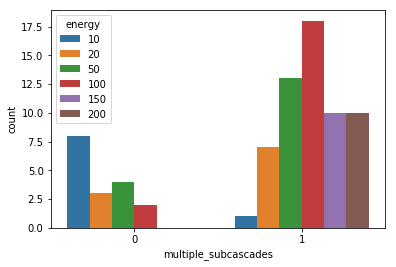

In [4]:
## Plots histogram for multiple subcascades (i.e. if subcascade_count > 1 - YES (1) else, NO (0) acc. to energy)
## You can customize the plot by changing 'x' and 'hue' values
import seaborn as sns
%matplotlib inline
sns.countplot(x='multiple_subcascades', hue='energy', data=data);

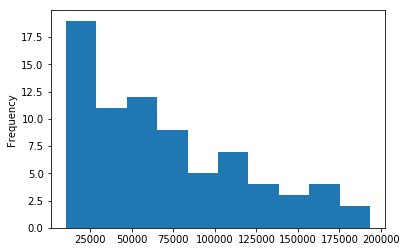

In [5]:
## Plots histogram of area (a column in csv file)
## You can customize the plot by changing the column name in data[] to any column name in the csv file. 
## Can also change the no. of bins for better visualization.
%matplotlib inline
data['area'].plot.hist(bins=10);

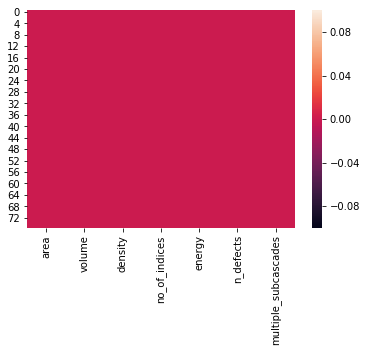

In [6]:
## Check for null values in the csv file
## Views the presence of null value with dark color from the color bar
%matplotlib inline
sns.heatmap(data.isnull());

#_Binary Logistic Regression_

***CLASSIFICATION REPORT***

              precision    recall  f1-score   support

           0       0.83      0.83      0.83         6
           1       0.94      0.94      0.94        17

   micro avg       0.91      0.91      0.91        23
   macro avg       0.89      0.89      0.89        23
weighted avg       0.91      0.91      0.91        23



***CONFUSION MATRIX***

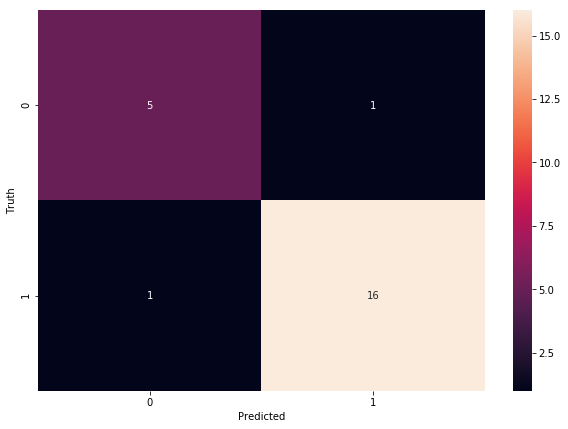

***ACCURACY***

91.30434782608695



***TRAINING ACCURACY***

92.45283018867924




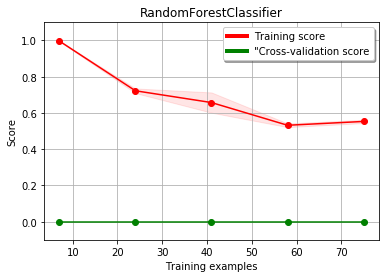

In [4]:
## Performs logistic regression with binary classification
## It predicts whether a cascade as multiple subcascades (> 1) or not with the following accuracy

## Input/s = data (data to perform BLR), test_size (preferably - 0.30 [i.e. 30%]), want_training_accuracy (1 - If YES & 0 - If NO)

## Knowing the training accuracy helps to know whether our model overfits, underfits or bestfits
## If the train accuracy is way more than testing accuracy (i.e. normal accuracy) => overfits
## If the train accuracy & the testing accuracy (i.e. normal accuracy) both are way less => underfits
## If the train accuracy is somewhat same (upto 1% - 5% diff.) as testing accuracy (i.e. normal accuracy) => bestfits

BLR(data, 0.30, 1)

#_Binary Logistic Regression with PCA_

Shape of Independent variable
(76, 6)

Explained Variance Ratio
[0.68238084 0.12602696]

Components of PCA
[[ 0.45998138  0.44366199 -0.32413717  0.41074027  0.43983782  0.35263492]
 [-0.07450007 -0.04346835  0.71217395 -0.09716709  0.21064695  0.6569284 ]]

Shape of Scaled Independent variable
(76, 6)

Shape of PCA Independent variable
(76, 2)



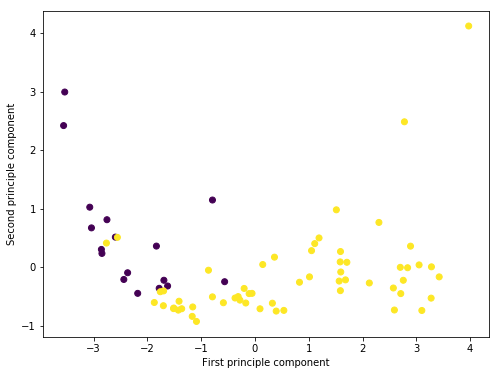

***CLASSIFICATION REPORT***

              precision    recall  f1-score   support

           0       0.83      0.83      0.83         6
           1       0.94      0.94      0.94        17

   micro avg       0.91      0.91      0.91        23
   macro avg       0.89      0.89      0.89        23
weighted avg       0.91      0.91      0.91        23



***CONFUSION MATRIX***

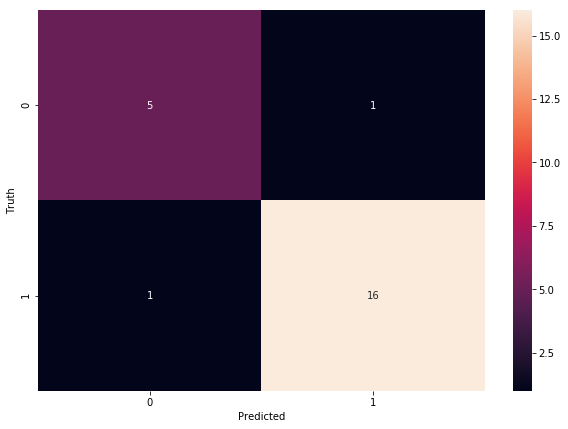

***ACCURACY***

91.30434782608695



***TRAINING ACCURACY***

92.45283018867924




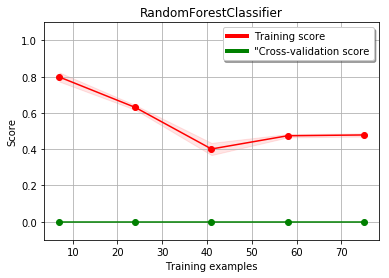

In [7]:
## Performs logistic regression with binary classification with PCA
## It predicts whether a cascade as multiple subcascades (> 1) or not with the following accuracy

## Input/s = data(data to perform BLR_PCA), no. of pca_components(preferably - 2), test_size (preferably - 0.30 [i.e. 30%]), want_training_accuracy (1 - If YES & 0 - If NO)

## Knowing the training accuracy helps to know whether our model overfits, underfits or bestfits
## If the train accuracy is way more than testing accuracy (i.e. normal accuracy) => overfits
## If the train accuracy & the testing accuracy (i.e. normal accuracy) both are way less => underfits
## If the train accuracy is somewhat same (upto 1% - 5% diff.) as testing accuracy (i.e. normal accuracy) => bestfits

BLR_PCA(data, 2, 0.30, 1)

#_Binary Logistic Regression with only single subcascades (i.e. subcascades__count == 1)_

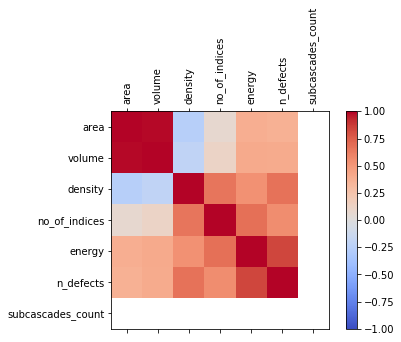

,area,volume,density,no_of_indices,energy,n_defects,subcascades_count
area,1.000000,0.990309,-0.254879,0.070414,0.387103,0.373532,NaN
volume,0.990309,1.000000,-0.202325,0.124764,0.411854,0.405607,NaN
density,-0.254879,-0.202325,1.000000,0.656294,0.539001,0.676671,NaN
no_of_indices,0.070414,0.124764,0.656294,1.000000,0.680932,0.557014,NaN
energy,0.387103,0.411854,0.539001,0.680932,1.000000,0.843242,NaN
n_defects,0.373532,0.405607,0.676671,0.557014,0.843242,1.000000,NaN
subcascades_count,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [6]:
## Generates a correlation graph and table for data (cascades) who has only single subcascade i.e. subcascade_count=1. 
## For better understanding of correlations.
## Input/s = data file
BLR_SSC_data = BLR_single_subcascade_corr("cascades-data-full.json")
## For correlation table
BLR_SSC_data.corr()

#_Binary Logistic Regression TRAINING ON FILE-1 & TESTING ON FILE-2_

###_Generates and reads training file's csv file_

In [9]:
## The training file should be such that it contains same "SUBSTRATE / ELEMENT" for all its cascades
## Input/s = data file
train_data = training_file_data_generation("cascades (to check - 300c 5, 10 & 20keV).json")
## Displays first 5 rows of the already read csv file
## You can see more no. of rows by placing the desired no. in the round brackets of the below head function
train_data.head()

Training data file contains only one substrate i.e. 'Fe'
cascades (to check - 300c 5, 10 & 20keV).json


,area,volume,density,no_of_indices,energy,n_defects,multiple_subcascades
0,3910.622997,13121.783092,0.001600,12,10,21,0
1,1948.106645,4786.330661,0.003343,9,10,16,0
2,1603.531865,4532.556643,0.002427,8,10,11,0
3,2885.939272,8339.334747,0.001919,6,10,16,0
4,1700.557866,4227.087278,0.003075,12,10,13,0


###_Understanding & visualizing the data in the training file_

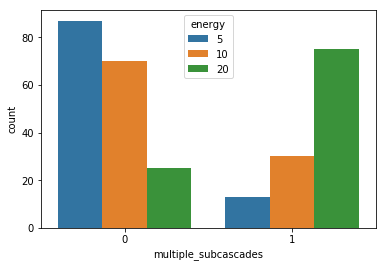

In [19]:
## Plots histogram for multiple subcascades (i.e. if subcascade_count > 1 - YES (1) else, NO (0) acc. to energy)
## You can customize the plot by changing 'x' and 'hue' values
import seaborn as sns
%matplotlib inline
sns.countplot(x='multiple_subcascades', hue='energy', data=train_data);

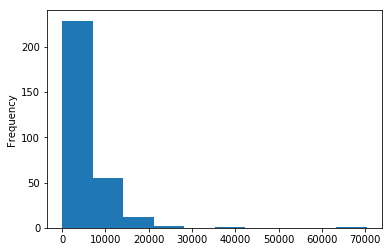

In [20]:
## Plots histogram of area (a column in csv file)
## You can customize the plot by changing the column name in data[] to any column name in the csv file. 
## Can also change the no. of bins for better visualization.
%matplotlib inline
train_data['area'].plot.hist(bins=10);

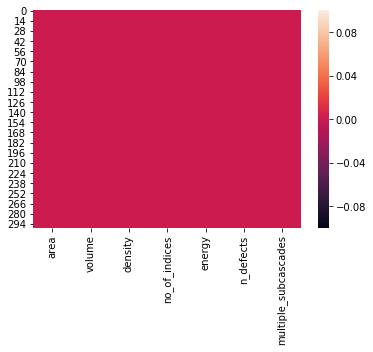

In [22]:
## Check for null values in the csv file
## Views the presence of null value with dark color from the color bar
%matplotlib inline
sns.heatmap(train_data.isnull());

###Generates and reads testing file's csv file

In [4]:
## The testing file should be such that it contains minimum no. of same "SUBSTRATE / ELEMENT" as that of training file 
## Input/s = data file
test_data = testing_file_data_generation("cascades-data-full.json")
## Displays first 5 rows of the already read csv file
## You can see more no. of rows by placing the desired no. in the round brackets of the below head function
test_data.head()

,area,volume,density,no_of_indices,energy,n_defects,multiple_subcascades
0,5212.784439,23576.863259,0.001060,14,10,25,0
1,2236.095863,5287.458304,0.003404,12,10,18,0
2,2878.218978,8675.844401,0.002190,10,10,19,0
3,2143.896493,6465.513471,0.002784,10,10,18,0
4,3518.941546,8289.725985,0.002413,12,10,20,1


###_Understanding & visualizing the data in the testing file_

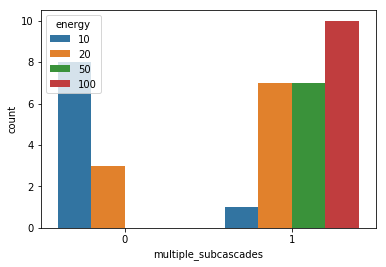

In [5]:
## Plots histogram for multiple subcascades (i.e. if subcascade_count > 1 - YES (1) else, NO (0) acc. to energy)
## You can customize the plot by changing 'x' and 'hue' values
import seaborn as sns
%matplotlib inline
sns.countplot(x='multiple_subcascades', hue='energy', data=test_data);

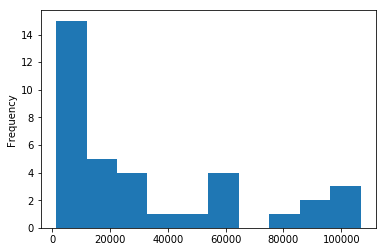

In [6]:
## Plots histogram of area (a column in csv file)
## You can customize the plot by changing the column name in data[] to any column name in the csv file. 
## Can also change the no. of bins for better visualization.
%matplotlib inline
test_data['area'].plot.hist(bins=10);

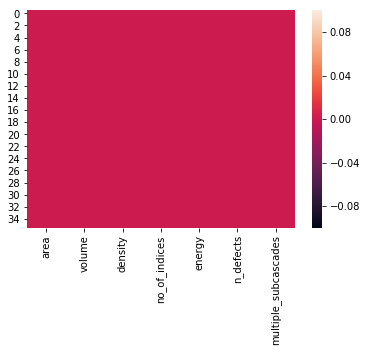

In [7]:
## Check for null values in the csv file
## Views the presence of null value with dark color from the color bar
%matplotlib inline
sns.heatmap(test_data.isnull());

###_Binary Logistic Regression for train on F1 & test on F2_

***CLASSIFICATION REPORT***

              precision    recall  f1-score   support

           0       0.62      1.00      0.77         5
           1       1.00      0.86      0.92        21

   micro avg       0.88      0.88      0.88        26
   macro avg       0.81      0.93      0.85        26
weighted avg       0.93      0.88      0.89        26



***CONFUSION MATRIX***

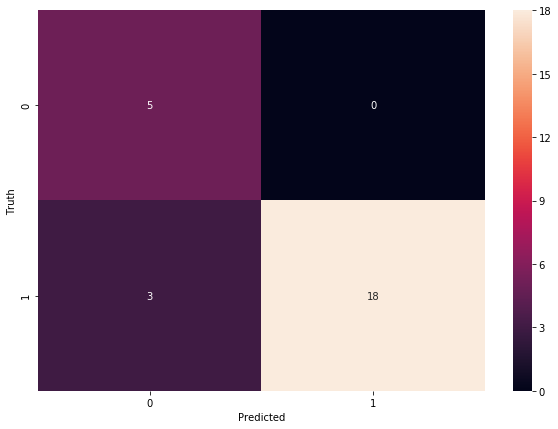

***ACCURACY***

88.46153846153845



***TRAINING ACCURACY***

87.03703703703704


In [23]:
## Trains on data-1 & tests on data-2 which were created in previous steps - Generates and reads training/testing file's csv file
## Input/s = train data, test_data, test size for testing test_data (preferably - 0.70 [i.e. 70%])
## The default test size for train_data is 0.10 => train size is 90% [We will be training the model with most of the given data]
## The test size for test_data is 0.70 [There will be very good no. of cases to predict]
BLR_train_on_file1_and_test_on_file2(train_data, test_data, 0.7)

###_Binary Logistic Regression with PCA for train on F1 & test on F2_

Shape of Independent variable
(300, 6)

Explained Variance Ratio
[0.6532116  0.16112413]

Components of PCA
[[ 0.44644103  0.43708781 -0.16642124  0.40831611  0.43935482  0.47137451]
 [ 0.27720735  0.30961598  0.89126739 -0.16936139 -0.0507288  -0.04098515]]

Shape of Scaled Independent variable
(300, 6)

Shape of PCA Independent variable
(300, 2)



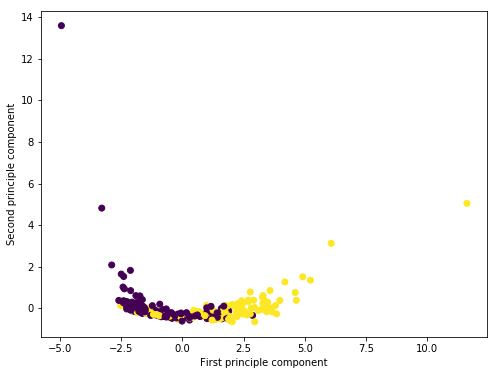

***CLASSIFICATION REPORT***

              precision    recall  f1-score   support

           0       0.50      1.00      0.67         2
           1       1.00      0.78      0.88         9

   micro avg       0.82      0.82      0.82        11
   macro avg       0.75      0.89      0.77        11
weighted avg       0.91      0.82      0.84        11



***CONFUSION MATRIX***

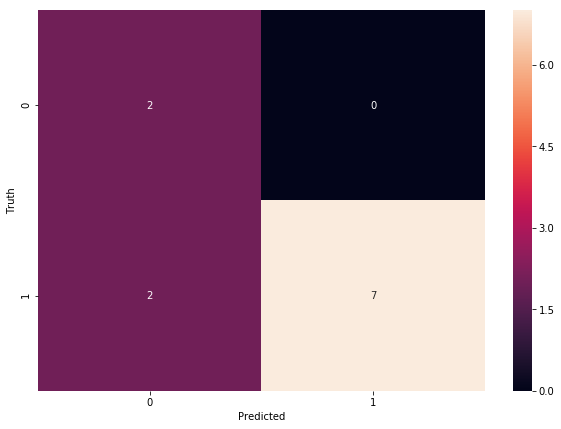

***ACCURACY***

81.81818181818183



***TRAINING ACCURACY***

81.48148148148148


In [28]:
## Trains on data-1 & tests on data-2 which were created in previous steps - Generates and reads training/testing file's csv file
## Input/s = train data, test_data, test size for testing test_data (preferably - 0.70 [i.e. 70%])
## The default test size for train_data is 0.10 => train size is 90% [We will be training the model with most of the given data]
## The test size for test_data is 0.70 [There will be very good no. of cases to predict]
BLR_PCA_train_on_file1_and_test_on_file2(train_data, test_data, 2, 0.7) #### Shows good result at 0.3 i.e. low test_size for test_data

### _Logistic Regression - Multi classification_ 

Function Definitions

In [1]:
def get_3d_coords(dict_name, only_vacancies):
    coords_3d = []
    for cascade in dict_name['data']:
        if(only_vacancies == 1):
            a = [[c[0],c[1],c[2]] for c in cascade['coords'] if (c[3]==0 and c[5]==1)]
            #a = [[c[0],c[1],c[2]] for c in cascade['coords'] if (c[3]==0)]
            #a = [[c[0],c[1],c[2]] for c in cascade['coords']]
        else:
            a = [[c[0],c[1],c[2]] for c in cascade['coords']]
        coords_3d.append(a)
    return coords_3d



def show_warning(message): ## Used in add_hull_and_extra_features_to_dict function
    import tkinter as tk
    root = tk.Tk()
    root.title("WARNING")
    root.geometry("700x100+370+100")
    w = tk.Label(root, text=message)
    w. place(relx=0.0, rely=1.0, anchor='sw')
    w.pack()
    root.mainloop()
    
    
    
def dclust_coords_exists_or_not(filename): ## Used in add_hull_and_extra_features_to_dict function
    import json
    with open(filename, 'r') as f:
        dict_name = json.loads(f.read())
    for key in dict_name['data'][0].keys():
        if(key == 'dclust_coords'):
            return 1
    return 0



def add_hull_and_extra_features_to_dict(filename): ##ALWAYS EXECUTE THIS FUNCTION (IMP. PREREQUISITE) - DEPENDENT ABOVE FUNCTION (hull_indices_generation)
    import json
    import numpy as np
    from scipy.spatial import ConvexHull
    
    with open(filename, 'r') as f:
        dict_name = json.loads(f.read()) #data becomes a dictionary

    ## Checks whether file data contains 'dclust_coords' as key or not for subcascades_count key generation
    subcascade=dclust_coords_exists_or_not(filename)
    if(subcascade == 0):
        show_warning("The given file doesn't contains 'dclust_coords' as key for subcascades_count key generation.\nOr in other terms, it is necessary for the given file (json file) to contain 'dclust_coords' key to predict the no of subcascades.")
    
    ## To get 3d coordinates of vacancies from dictionary
    coords_3d = get_3d_coords(dict_name,1)
    for i,cascade in enumerate(dict_name['data']):
        ## Points type-casting
        pts = np.array(coords_3d[i], np.float)
        if (len(pts) < 4):
            ## Shows warning if points in a cascade are < 4
            show_warning("Number of points in cascade "+str(i)+" is less than 4.\nSo, kindly don't run plotting function calls for this cascade as it will rise an error.")
            cascade['hull_vertices'] = 0
            cascade['hull_simplices'] = [ch.simplices.tolist()]
            cascade['hull_nvertices'] = 0
            cascade['hull_nsimplices'] = 0
            cascade['hull_neighbors'] = [ch.neighbors.tolist()]
            #cascade['hull_max_bound'] = ch.max_bound.tolist()
            #cascade['hull_min_bound'] = ch.min_bound.tolist()
            cascade['hull_area'] = 0.0
            cascade['hull_volume'] = 0.0
            cascade['hull_density'] = 0.0
            cascade['hull_no_of_indices']=0
            ## Checks whether file data contains 'dclust_coords' as key or not for subcascades_count key generation
            if(subcascade==1):
                cascade['subcascades_count']=len(dict_name['data'][i]['dclust_coords'].keys())
            
        else:
            ## Convex hull generation
            ch = ConvexHull(pts)
            cascade['hull_vertices'] = ch.vertices.tolist()
            cascade['hull_simplices'] = ch.simplices.tolist()
            cascade['hull_nvertices'] = len(ch.vertices)
            cascade['hull_nsimplices'] = ch.nsimplex
            cascade['hull_neighbors'] = ch.neighbors.tolist()
            #cascade['hull_max_bound'] = ch.max_bound.tolist()
            #cascade['hull_min_bound'] = ch.min_bound.tolist()
            cascade['hull_area'] =ch.area
            cascade['hull_volume'] = ch.volume
            cascade['hull_density'] = dict_name['data'][i]['n_defects']/ch.volume
            cascade['hull_no_of_indices']=len(ch.vertices)
            ## Checks whether file data contains 'dclust_coords' as key or not for subcascades_count key generation
            if(subcascade==1):
                cascade['subcascades_count']=len(dict_name['data'][i]['dclust_coords'].keys())
                
    ## To make changes to original file
    with open(filename, 'w') as f:
        f.write(json.dumps(dict_name, indent=4, separators=(',', ': ')))
    
    
    
def get_data(filename): 
    ## Adds extra features to file for more flexibility in coding
    ## Input/s = data file
    add_hull_and_extra_features_to_dict(filename)
    
    import json
    from pathlib import Path
    
    fname = filename
    out_fname = Path(fname).stem + ".js"
    f = open(fname, "r+")
    cascades = json.load(f)
    f.close()
    return cascades
    
    
    
def csv_file_generation_from_the_given_data_file_for_MLR(file_name): ## Used by generate_and_read_csv_file function
    ## To get data from json file and store as dictionary  'cascades'
    ## Input/s = data file
    cascades = get_data(file_name)

    ## List generation of all necessary columns & and its corresponding data for csv file generation
    list=[]
    headings=["area","volume","density","no_of_indices","energy","n_defects","subcascades_count"]
    list.append(headings)
    for i in range(0,len(cascades["data"])):
        row=[cascades["data"][i]["hull_area"], cascades["data"][i]["hull_volume"], cascades["data"][i]["hull_density"], cascades["data"][i]["hull_no_of_indices"], cascades["data"][i]["energy"], cascades["data"][i]["n_defects"], cascades["data"][i]["subcascades_count"]]
        list.append(row)
    #print(len(list))

    ## Creates csv file from given file
    import csv
    from pathlib import Path
    csv_file_MLR = Path(file_name).stem + " (MLR).csv"
    with open(csv_file_MLR, 'w') as csvFile:
        writer = csv.writer(csvFile)
        for i in range(0, len(list)):
            writer.writerow(list[i])
    csvFile.close()
    return csv_file_MLR



def generate_and_read_csv_file(file_name):   
    import pandas as pd

    ## Generates csv file from given file (json) for Binary Logistic Regression
    csv_file_MLR = csv_file_generation_from_the_given_data_file_for_MLR(file_name)

    ## Read & display the first 5 lines of the csv file generated from the given file
    data=pd.read_csv(csv_file_MLR)
    return data



def plot_curve(X, y):
    import sklearn
    from sklearn.model_selection import StratifiedKFold, cross_val_score
    from sklearn.model_selection import train_test_split
    from sklearn.linear_model import LinearRegression
    from sklearn.model_selection import learning_curve, GridSearchCV, KFold
    %matplotlib inline
    import matplotlib.pyplot as plt
    from sklearn.metrics import explained_variance_score, make_scorer
    import numpy as np
    from matplotlib.lines import Line2D

    size = len(X)
    cv = KFold(size, shuffle=True)
    
    # instantiate
    lg = LinearRegression()

    # fit
    lg.fit(X, y)
    
    train_sizes, train_scores, test_scores = learning_curve(lg, X, y, n_jobs=-1, cv=cv, train_sizes=np.linspace(.1, 1.0, 5), verbose=0)

    train_scores_mean = np.mean(train_scores, axis=1)
    train_scores_std = np.std(train_scores, axis=1)
    test_scores_mean = np.mean(test_scores, axis=1)
    test_scores_std = np.std(test_scores, axis=1)
    
    legend_elements = [Line2D([0], [0], color='r', lw=4, label='Training score'), 
                       Line2D([0], [0], color='g', lw=4, label='"Cross-validation score')]
    
    plt.figure()
    plt.title("RandomForestClassifier")
    plt.legend(handles = legend_elements, loc="upper right", shadow=True)
    plt.xlabel("Training examples")
    plt.ylabel("Score")
    plt.gca().invert_yaxis()
    
    # box-like grid
    plt.grid()
    
    # plot the std deviation as a transparent range at each training set size
    plt.fill_between(train_sizes, train_scores_mean - train_scores_std, train_scores_mean + train_scores_std, alpha=0.1, color="r")
    plt.fill_between(train_sizes, test_scores_mean - test_scores_std, test_scores_mean + test_scores_std, alpha=0.1, color="g")
    
    # plot the average training and test score lines at each training set size
    plt.plot(train_sizes, train_scores_mean, 'o-', color="r");
    plt.plot(train_sizes, test_scores_mean, 'o-', color="g");
        
    # sizes the window for readability and displays the plot
    # shows error from 0 to 1.1
    plt.ylim(-.1,1.1)
    plt.show()



def MLR(data, test_size, want_training_accuracy):    
    ## Allocation of Independent variable (X - The feature/s or column/s from which we want to predict) & Dependent variable (y - feature/s or column/s we want to predict from X)
    X=data.drop('subcascades_count',axis=1)
    y=data['subcascades_count']

    ## Splits the data (i.e. Independent and Dependent data) inturn into Training and Testing data
    from sklearn.model_selection import train_test_split
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_size, random_state=1)

    ## Hides all warnings
    import warnings
    warnings.filterwarnings('ignore')

    ## Increases accuracy by standardizing the value
    from sklearn.preprocessing import StandardScaler
    sc= StandardScaler()
    X_train=sc.fit_transform(X_train)
    X_test=sc.transform(X_test)

    ## Fits our data to a model
    from sklearn.linear_model import LogisticRegression
    logmodel = LogisticRegression()
    logmodel.fit(X_train,y_train)

    ## Model predicts
    predictions = logmodel.predict(X_test)

    ## Prints classification Report for actual values and our model's predicted values
    from IPython.display import Markdown, display
    display(Markdown('***CLASSIFICATION REPORT***'))
    from sklearn.metrics import classification_report
    print(classification_report(y_test,predictions))

    ## Plots Confusion Matrix
    from IPython.display import Markdown, display
    display(Markdown('***CONFUSION MATRIX***'))
    from sklearn.metrics import confusion_matrix
    cm=confusion_matrix(y_test,predictions)
    import seaborn as sn
    %matplotlib inline
    import matplotlib.pyplot as plt
    plt.figure(figsize = (10,7));
    sn.heatmap(cm, annot=True)
    plt.xlabel('Predicted')
    plt.ylabel('Truth')
    plt.show()

    ## Accuracy
    from IPython.display import Markdown, display
    display(Markdown('***ACCURACY***'))
    from sklearn.metrics import accuracy_score
    print(accuracy_score(y_test,predictions)*100)
    
    ## Training accuracy
    if(want_training_accuracy == 1):
        predictions = logmodel.predict(X_train)
        from IPython.display import Markdown, display
        print()
        display(Markdown('***TRAINING ACCURACY***'))
        from sklearn.metrics import accuracy_score
        print(accuracy_score(y_train,predictions)*100)
        
    print()
    print()
    ## Plots training & testing error curves
    plot_curve(X, y)
        
        

def MLR_PCA(data, pca_components, test_size, want_training_accuracy):    
    ## Allocation of Independent variable (X - The feature/s or column/s from which we want to predict) & Dependent variable (y - feature/s or column/s we want to predict from X)
    xdata=data.drop('subcascades_count',axis=1)
    ydata=data['subcascades_count']

    print("Shape of Independent variable")
    print(xdata.shape)
    
    ## Hides all warnings
    import warnings
    warnings.filterwarnings('ignore')

    ## Increases accuracy by standardizing the value
    from sklearn.preprocessing import StandardScaler
    scaler=StandardScaler()
    scaler.fit(xdata)
    scaled_data=scaler.transform(xdata)

    ## Performs PCA
    from sklearn.decomposition import PCA
    pca=PCA(n_components=pca_components)

    pca.fit(scaled_data)
    print()
    print("Explained Variance Ratio")
    print(pca.explained_variance_ratio_)
    x_pca=pca.transform(scaled_data)

    print()
    print("Components of PCA")
    print(pca.components_)

    print()
    print("Shape of Scaled Independent variable")
    print(scaled_data.shape)

    print()
    print("Shape of PCA Independent variable")
    print(x_pca.shape)
    
    if(pca_components == 2):
        print()
        %matplotlib inline
        import matplotlib.pyplot as plt
        plt.figure(figsize=(8,6))
        plt.scatter(x_pca[:,0],x_pca[:,1],c=ydata)
        plt.xlabel('First principle component')
        plt.ylabel('Second principle component')
        plt.show()

    
    ## Allocation of Independent variable & Dependent variable after PCA
    X=x_pca
    y=ydata

    ## Splits the data (i.e. Independent and Dependent data) inturn into Training and Testing data
    from sklearn.model_selection import train_test_split
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_size, random_state=1)

    ## Fits our data to a model
    from sklearn.linear_model import LogisticRegression
    logmodel = LogisticRegression()
    logmodel.fit(X_train,y_train)

    ## Model predicts
    predictions = logmodel.predict(X_test)

    ## Prints classification Report for actual values and our model's predicted values
    from IPython.display import Markdown, display
    print()
    print()
    display(Markdown('***CLASSIFICATION REPORT***'))
    from sklearn.metrics import classification_report
    print(classification_report(y_test,predictions))

    ## Plots Confusion Matrix
    from IPython.display import Markdown, display
    display(Markdown('***CONFUSION MATRIX***'))
    from sklearn.metrics import confusion_matrix
    cm=confusion_matrix(y_test,predictions)
    import seaborn as sn
    %matplotlib inline
    import matplotlib.pyplot as plt
    plt.figure(figsize = (10,7));
    sn.heatmap(cm, annot=True)
    plt.xlabel('Predicted')
    plt.ylabel('Truth')
    plt.show()

    ## Accuracy
    from IPython.display import Markdown, display
    display(Markdown('***ACCURACY***'))
    from sklearn.metrics import accuracy_score
    print(accuracy_score(y_test,predictions)*100)
    
    ## Training accuracy
    if(want_training_accuracy == 1):
        predictions = logmodel.predict(X_train)
        from IPython.display import Markdown, display
        print()
        display(Markdown('***TRAINING ACCURACY***'))
        from sklearn.metrics import accuracy_score
        print(accuracy_score(y_train,predictions)*100)
    
    print()
    print()
    ## Plots training & testing error curves
    plot_curve(X, y)



def MLR_multiple_subcascade_corr(file_name):
    ## Must execute this function call as it is necessary for other calls (indirect interdependency) - COMPULSORY EXECUTION
    ## To get data from json file and store as dictionary  'cascades'
    ## Input/s = data file
    cascades = get_data(file_name)

    ## Creates a new json file. So as to make changes to the file i.e. delete few data.
    import json
    from pathlib import Path
    new_file_name =Path(file_name).stem + ' (MLR - MSC).json'
    with open(new_file_name, 'w') as fp:
        json.dump(cascades, fp)

    ## Must execute this function call as it is necessary for other calls (indirect interdependency) - COMPULSORY EXECUTION
    ## To get data from json file and store as dictionary  'cascades_MSC'
    ## Input/s = data file
    ## Creates a new dict.
    cascades_MSC = get_data(new_file_name)

    ## Gathers indices of all cascades whose subcascades_count is equal to 1/0 i.e. cascades with single subcascades
    index_MSC=[]
    for i in range(0, len(cascades_MSC["data"])):
        if(cascades_MSC["data"][i]["subcascades_count"]==1):
            index_MSC.append(i)
    for i in range(0, len(cascades_MSC["data"])):
        if(cascades_MSC["data"][i]["subcascades_count"]==0):
            show_warning("The given file also contains '0' subcascades for cascade "+str(i)+".\nWe will be deleting such cascades too!\nAs we need only multiple subcascades data. For any changes, kindly change your requirement in the code")
            index_MSC.append(i)
            
    #print(len(index_MSC))
    #print(len(cascades_MSC['data']))

    ## Deletes all the cascades who has single subcascades with the help of the above step
    import json
    with open(new_file_name, 'r') as f:
        cascades_MSC = json.loads(f.read()) #data becomes a dictionary
    for i in sorted(index_MSC, reverse=True): 
        del cascades_MSC['data'][i]
    ## Writes the data back on to the file
    with open(new_file_name, 'w') as f:
        f.write(json.dumps(cascades_MSC, indent=4, separators=(',', ': ')))

    #print(len(cascades_MSC['data']))

    ## Gathers imp. columns and their corr. data to create a new csv file
    list=[]
    headings=["area","volume","density","no_of_indices","energy","n_defects","subcascades_count"]
    list.append(headings)
    for i in range(0,len(cascades_MSC["data"])):
        row=[cascades_MSC["data"][i]["hull_area"], cascades_MSC["data"][i]["hull_volume"], cascades_MSC["data"][i]["hull_density"], cascades_MSC["data"][i]["hull_no_of_indices"], cascades_MSC["data"][i]["energy"], cascades_MSC["data"][i]["n_defects"], cascades_MSC["data"][i]["subcascades_count"]]
        list.append(row)
    #print(len(list))

    ## Create a new csv file for new data
    import csv
    from pathlib import Path
    csv_file_MLR_MSC = Path(new_file_name).stem + ".csv"
    with open(csv_file_MLR_MSC, 'w') as csvFile:
        writer = csv.writer(csvFile)
        for i in range(0, len(list)):
            writer.writerow(list[i])
    csvFile.close()

    ## Plots corr. graph
    import numpy as np
    import pandas as pd
    %matplotlib inline
    import matplotlib.pyplot as plt
    data = pd.read_csv(csv_file_MLR_MSC)
    ## For plotting correlation matrix graph
    #print(data.head()) ## To print first 5 rows
    corr = data.corr()
    fig = plt.figure()
    ax = fig.add_subplot(111)
    cax = ax.matshow(corr,cmap='coolwarm', vmin=-1, vmax=1)
    fig.colorbar(cax)
    ticks = np.arange(0,len(data.columns),1)
    ax.set_xticks(ticks)
    plt.xticks(rotation=90)
    ax.set_yticks(ticks)
    ax.set_xticklabels(data.columns)
    ax.set_yticklabels(data.columns)
    plt.show()

    return data



train_file_element = None
def training_file_data_generation(train_file_name):
    ## To get data from train json file and store as dictionary 
    ## Input/s = data file
    train_data_dict = get_data(train_file_name)
    
    ## Check whether given file' data contains same substrate for all its cascades
    elem=train_data_dict['data'][0]['substrate']
    for i in range(0, len(train_data_dict['data'])):
        if(train_data_dict['data'][i]['substrate'] != elem):
            show_warning("The training file given contains more than one substrate.\nHence it is not feasible to train the model on given data to predict for another data.\nThis model is only for training the model with specific substrate.\nAnd then, testing it on another file with  contains training data's specific substrate as one of its substrates.\nKindly give another file which contains single substrate.")
            return
    
    global train_file_element 
    train_file_element = elem
    ## If all cascades' substrates are same
    ## Generates csv file from given file and reads then, stores it in data variable
    train_data = generate_and_read_csv_file(train_file_name)
    print("Training data file contains only one substrate i.e. '"+train_file_element+"'")
    print()
    
    return train_data



def MSC_training_file_data_generation(train_file_name):
    ## To get data from train json file and store as dictionary 
    ## Input/s = data file
    train_data_dict = get_data(train_file_name)
    
    ## Check whether given file' data contains same substrate for all its cascades
    elem=train_data_dict['data'][0]['substrate']
    for i in range(0, len(train_data_dict['data'])):
        if(train_data_dict['data'][i]['substrate'] != elem):
            show_warning("The training file given contains more than one substrate.\nHence it is not feasible to train the model on given data to predict for another data.\nThis model is only for training the model with specific substrate.\nAnd then, testing it on another file with  contains training data's specific substrate as one of its substrates.\nKindly give another file which contains single substrate.")
            return
    
    global train_file_element 
    train_file_element = elem
    
    ## Creates a new test json file. So as to make changes to the file i.e. delete few data.
    import json
    from pathlib import Path
    new_train_file_name =Path(train_file_name).stem + ' - MSC (only '+train_file_element+').json'
    with open(new_train_file_name, 'w') as fp:
        json.dump(train_data_dict, fp)
        
    ## To get data from duplicate train json file and store as dictionary 
    ## Input/s = data file
    train_data_dict = get_data(new_train_file_name)
    
    ## Gathers indices of all cascades whose substrate is not "train_file_name_element" & subcascades_count = 1/0
    index=[]
    for i in range(0, len(train_data_dict["data"])):
        if(train_data_dict["data"][i]["subcascades_count"]==1):
            index.append(i)
    for i in range(0, len(train_data_dict["data"])):
        if(train_data_dict["data"][i]["subcascades_count"]==0):
            show_warning("The given file also contains '0' subcascades for cascade "+str(i)+".\nWe will be deleting such cascades too!\nAs we need only multiple subcascades data. For any changes, kindly change your requirement in the code")
            index.append(i)
    #print(len(index))
    #print(len(train_data_dict['data']))
    
    ## Deletes all the cascades whose subcascades_count is 1 with the help of the above step
    import json
    with open(new_train_file_name, 'r') as f:
        cascades = json.loads(f.read()) #data becomes a dictionary
    for i in sorted(index, reverse=True): 
        del cascades['data'][i]
    ## Writes the data back on to the file
    with open(new_train_file_name, 'w') as f:
        f.write(json.dumps(cascades, indent=4, separators=(',', ': ')))
    #print(len(cascades['data']))
    
    ## If all cascades' substrates are same
    ## Generates csv file from given file and reads then, stores it in data variable
    train_data = generate_and_read_csv_file(new_train_file_name)
    print("Training data file contains only one substrate i.e. '"+train_file_element+"'")
    print()
    
    return train_data



def testing_file_data_generation(test_file_name):
    ## To get data from test json file and store as dictionary 
    ## Input/s = data file
    test_data_dict = get_data(test_file_name)

    ## Creates a new test json file. So as to make changes to the file i.e. delete few data.
    import json
    from pathlib import Path
    new_test_file_name =Path(test_file_name).stem + ' (only '+train_file_element+').json'
    with open(new_test_file_name, 'w') as fp:
        json.dump(test_data_dict, fp)
        
    ## To get data from duplicate test json file and store as dictionary 
    ## Input/s = data file
    test_data_dict = get_data(new_test_file_name)
    
    ## Gathers indices of all cascades whose substrate is not "train_file_name_element"
    index=[]
    for i in range(0, len(test_data_dict["data"])):
        if(test_data_dict["data"][i]["substrate"]!=train_file_element):
            index.append(i)
    #print(len(index))
    #print(len(test_data_dict['data']))
    
    ## Deletes all the cascades whose substrate is not "train_file_name_element" with the help of the above step
    import json
    with open(new_test_file_name, 'r') as f:
        cascades = json.loads(f.read()) #data becomes a dictionary
    for i in sorted(index, reverse=True): 
        del cascades['data'][i]
    ## Writes the data back on to the file
    with open(new_test_file_name, 'w') as f:
        f.write(json.dumps(cascades, indent=4, separators=(',', ': ')))
    #print(len(cascades['data']))
    
    if(len(cascades['data']) == 0):
        show_warning("The testing file given contains no cascades with substrate '"+train_file_element+"' which is training file's only substrate.\nKindly give another file with '"+train_file_element+"' as one of its substrate")
        return
    
    ## Generates csv file from new test file and reads then, stores it in data variable
    test_data = generate_and_read_csv_file(new_test_file_name)
    return test_data



def MSC_testing_file_data_generation(test_file_name):
    ## To get data from test json file and store as dictionary 
    ## Input/s = data file
    test_data_dict = get_data(test_file_name)

    ## Creates a new test json file. So as to make changes to the file i.e. delete few data.
    import json
    from pathlib import Path
    new_test_file_name =Path(test_file_name).stem + '- MSC (only '+train_file_element+').json'
    with open(new_test_file_name, 'w') as fp:
        json.dump(test_data_dict, fp)
        
    ## To get data from duplicate test json file and store as dictionary 
    ## Input/s = data file
    test_data_dict = get_data(new_test_file_name)
    
    ## Gathers indices of all cascades whose substrate is not "train_file_name_element"
    index=[]
    for i in range(0, len(test_data_dict["data"])):
        if(test_data_dict["data"][i]["substrate"]!=train_file_element or test_data_dict["data"][i]["subcascades_count"]==1):
            index.append(i)
    for i in range(0, len(test_data_dict["data"])):
        if(test_data_dict["data"][i]["subcascades_count"]==0):
            show_warning("The given file also contains '0' subcascades for cascade "+str(i)+".\nWe will be deleting such cascades too!\nAs we need only multiple subcascades data. For any changes, kindly change your requirement in the code")
            index.append(i)
            
    #print(len(index))
    #print(len(test_data_dict['data']))
    
    ## Deletes all the cascades whose substrate is not "train_file_name_element" with the help of the above step
    import json
    with open(new_test_file_name, 'r') as f:
        cascades = json.loads(f.read()) #data becomes a dictionary
    for i in sorted(index, reverse=True): 
        del cascades['data'][i]
    ## Writes the data back on to the file
    with open(new_test_file_name, 'w') as f:
        f.write(json.dumps(cascades, indent=4, separators=(',', ': ')))
    #print(len(cascades['data']))
    
    if(len(cascades['data']) == 0):
        show_warning("The testing file given contains no cascades with substrate '"+train_file_element+"' which is training file's only substrate.\nKindly give another file with '"+train_file_element+"' as one of its substrate")
        return
    
    ## Generates csv file from new test file and reads then, stores it in data variable
    test_data = generate_and_read_csv_file(new_test_file_name)
    return test_data
    
    

def MLR_train_on_file1_and_test_on_file2(train_data, test_data, test_size_for_test_data):
    #### TRAINING ON TRAIN FILE i.e. FILE 1
    ## Allocation of Independent variable (X - The feature/s or column/s from which we want to predict) & Dependent variable (y - feature/s or column/s we want to predict from X)
    train_data_X = train_data.drop('subcascades_count',axis=1)
    train_data_y = train_data['subcascades_count']

    ## Splits the training file data (i.e. Independent and Dependent data) inturn into Training and Testing data
    from sklearn.model_selection import train_test_split
    X_train_train, X_test_train, y_train_train, y_test_train = train_test_split(train_data_X, train_data_y, test_size=0.1, random_state=1)

    ## Hides all warnings
    import warnings
    warnings.filterwarnings('ignore')

    ## Increases accuracy by standardizing the value
    from sklearn.preprocessing import StandardScaler
    sc= StandardScaler()
    X_train_train=sc.fit_transform(X_train_train)
    X_test_train=sc.transform(X_test_train)

    ## Fits our training file train data to a model
    from sklearn.linear_model import LogisticRegression
    logmodel = LogisticRegression()
    logmodel.fit(X_train_train,y_train_train)


    #### TESTING ON TEST FILE i.e. FILE 2
    ## Allocation of Independent variable (X - The feature/s or column/s from which we want to predict) & Dependent variable (y - feature/s or column/s we want to predict from X)
    test_data_X = test_data.drop('subcascades_count',axis=1)
    test_data_y = test_data['subcascades_count']

    ## Splits the testing file data (i.e. Independent and Dependent data) inturn into Training and Testing data
    from sklearn.model_selection import train_test_split
    X_train_test, X_test_test, y_train_test, y_test_test = train_test_split(test_data_X, test_data_y, test_size=test_size_for_test_data, random_state=1)

    ## Increases accuracy by standardizing the value
    from sklearn.preprocessing import StandardScaler
    sc= StandardScaler()
    X_train_test=sc.fit_transform(X_train_test)
    X_test_test=sc.transform(X_test_test)


    ## Model predicts for testing file data
    predictions = logmodel.predict(X_test_test)

    ## Prints classification Report for actual values and our model's predicted values
    from IPython.display import Markdown, display
    display(Markdown('***CLASSIFICATION REPORT***'))
    from sklearn.metrics import classification_report
    print(classification_report(y_test_test,predictions))

    ## Plots Confusion Matrix
    from IPython.display import Markdown, display
    display(Markdown('***CONFUSION MATRIX***'))
    from sklearn.metrics import confusion_matrix
    cm=confusion_matrix(y_test_test,predictions)
    import seaborn as sn
    %matplotlib inline
    import matplotlib.pyplot as plt
    plt.figure(figsize = (10,7));
    sn.heatmap(cm, annot=True)
    plt.xlabel('Predicted')
    plt.ylabel('Truth')
    plt.show()

    ## Accuracy
    from IPython.display import Markdown, display
    display(Markdown('***ACCURACY***'))
    from sklearn.metrics import accuracy_score
    print(accuracy_score(y_test_test,predictions)*100)

    ## Training accuracy i.e train file training acc.
    predictions = logmodel.predict(X_train_train)
    from IPython.display import Markdown, display
    print()
    display(Markdown('***TRAINING ACCURACY***'))
    from sklearn.metrics import accuracy_score
    print(accuracy_score(y_train_train,predictions)*100)



def MLR_PCA_train_on_file1_and_test_on_file2(train_data, test_data, pca_components, test_size_for_test_data):
    #### TRAINING ON TRAIN FILE i.e. FILE 1
    ## Allocation of Independent variable (X - The feature/s or column/s from which we want to predict) & Dependent variable (y - feature/s or column/s we want to predict from X)
    train_data_X = train_data.drop('subcascades_count',axis=1)
    train_data_y = train_data['subcascades_count']

    print("Shape of Training_data Independent variable")
    print(train_data_X.shape)
    
    ## Hides all warnings
    import warnings
    warnings.filterwarnings('ignore')

    ## Increases accuracy by standardizing the value
    from sklearn.preprocessing import StandardScaler
    scaler=StandardScaler()
    scaler.fit(train_data_X)
    scaled_data=scaler.transform(train_data_X)

    ## Performs PCA for train_data data
    from sklearn.decomposition import PCA
    pca=PCA(n_components=pca_components)

    pca.fit(scaled_data)
    print()
    print("Explained Variance Ratio of Training_data ")
    print(pca.explained_variance_ratio_)
    x_pca_tr=pca.transform(scaled_data)

    print()
    print("Training_data Components of PCA")
    print(pca.components_)

    print()
    print("Shape of Training_data Scaled Independent variable")
    print(scaled_data.shape)

    print()
    print("Shape of Training_data PCA Independent variable")
    print(x_pca_tr.shape)
    
    if(pca_components == 2):
        print()
        %matplotlib inline
        import matplotlib.pyplot as plt
        plt.figure(figsize=(8,6))
        plt.scatter(x_pca_tr[:,0],x_pca_tr[:,1],c=train_data_y)
        plt.xlabel('First principle component')
        plt.ylabel('Second principle component')
        plt.show()
    
    ## Allocation of Independent variable & Dependent variable after PCA
    X_tr=x_pca_tr
    y_tr=train_data_y

    ## Splits the training_data's data (i.e. Independent and Dependent data) inturn into Training and Testing data
    from sklearn.model_selection import train_test_split
    X_train_train, X_test_train, y_train_train, y_test_train = train_test_split(X_tr, y_tr, test_size=0.10, random_state=1)

    ## Fits our training file train data to a model
    from sklearn.linear_model import LogisticRegression
    logmodel = LogisticRegression()
    logmodel.fit(X_train_train,y_train_train)

   
    #### TESTING ON TEST FILE i.e. FILE 2
    ## Allocation of Independent variable (X - The feature/s or column/s from which we want to predict) & Dependent variable (y - feature/s or column/s we want to predict from X)
    test_data_X = test_data.drop('subcascades_count',axis=1)
    test_data_y = test_data['subcascades_count']

    ## Increases accuracy by standardizing the value
    from sklearn.preprocessing import StandardScaler
    scaler=StandardScaler()
    scaler.fit(test_data_X)
    scaled_data=scaler.transform(test_data_X)

    ## Performs PCA testing_data's data
    from sklearn.decomposition import PCA
    pca=PCA(n_components=pca_components)
    pca.fit(scaled_data)
    x_pca_te=pca.transform(scaled_data)
    
    ## Allocation of Independent variable & Dependent variable after PCA
    X_te=x_pca_te
    y_te=test_data_y

    ## Splits the testing_data's data (i.e. Independent and Dependent data) inturn into Training and Testing data
    from sklearn.model_selection import train_test_split
    X_train_test, X_test_test, y_train_test, y_test_test = train_test_split(X_te, y_te, test_size=test_size_for_test_data, random_state=1)
    
    ## Model predicts for testing file data
    predictions = logmodel.predict(X_test_test)
    
    ## Prints classification Report for actual values and our model's predicted values
    from IPython.display import Markdown, display
    display(Markdown('***CLASSIFICATION REPORT***'))
    from sklearn.metrics import classification_report
    print(classification_report(y_test_test,predictions))

    ## Plots Confusion Matrix
    from IPython.display import Markdown, display
    display(Markdown('***CONFUSION MATRIX***'))
    from sklearn.metrics import confusion_matrix
    cm=confusion_matrix(y_test_test,predictions)
    import seaborn as sn
    %matplotlib inline
    import matplotlib.pyplot as plt
    plt.figure(figsize = (10,7));
    sn.heatmap(cm, annot=True)
    plt.xlabel('Predicted')
    plt.ylabel('Truth')
    plt.show()

    ## Accuracy
    from IPython.display import Markdown, display
    display(Markdown('***ACCURACY***'))
    from sklearn.metrics import accuracy_score
    print(accuracy_score(y_test_test,predictions)*100)

    ## Training accuracy i.e train file training acc.
    predictions = logmodel.predict(X_train_train)
    from IPython.display import Markdown, display
    print()
    display(Markdown('***TRAINING ACCURACY***'))
    from sklearn.metrics import accuracy_score
    print(accuracy_score(y_train_train,predictions)*100)




Function Calls / User Code

#_To read file and get data_

In [9]:
## Must execute this function call as it is necessary for other calls (indirect interdependency) - COMPULSORY EXECUTION
## To get data from json file and store as dictionary  'cascades'
## Input/s = data file
cascades = get_data("cascades-data-full.json")


#_Generates and reads csv file_

In [10]:
## Generates csv file from given file and reads then, stores it in data variable
data = generate_and_read_csv_file("cascades-data-full.json")
## Displays first 5 rows of the already read csv file
## You can see more no. of rows by placing the desired no. in the round brackets of the below head function
data.head()

,area,volume,density,no_of_indices,energy,n_defects,subcascades_count
0,6888.092302,40124.387893,0.000897,14,50,36,1
1,10922.625164,58135.967706,0.000636,17,50,37,2
2,17841.964350,125930.554156,0.000222,18,50,28,2
3,12162.530623,92444.116285,0.000379,14,50,35,2
4,8723.703896,44320.747744,0.001060,15,50,47,1


#_Understanding & visualizing the data in the csv file_

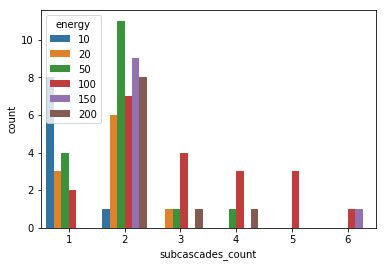

In [5]:
## Plots histogram for multiple no. of subcascades acc. to energy
## You can customize the plot by changing 'x' and 'hue' values
import seaborn as sns
%matplotlib inline
sns.countplot(x='subcascades_count', hue='energy', data=data);

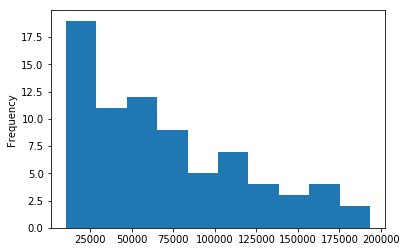

In [6]:
## Plots histogram of area (a column in csv file)
## You can customize the plot by changing the column name in data[] to any column name in the csv file. 
## Can also change the no. of bins for better visualization.
%matplotlib inline
data['area'].plot.hist(bins=10);

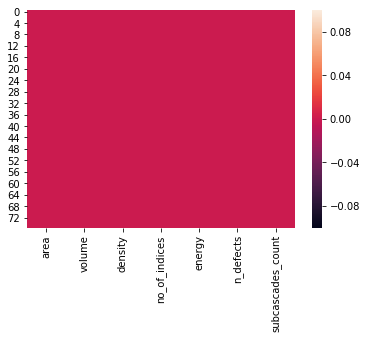

In [7]:
## Check for null values in the csv file
## Views the presence of null value with dark color from the color bar
%matplotlib inline
sns.heatmap(data.isnull());

#_Multi Logistic Regression_

***CLASSIFICATION REPORT***

              precision    recall  f1-score   support

           1       0.80      0.67      0.73         6
           2       0.80      0.92      0.86        13
           3       0.00      0.00      0.00         1
           4       0.00      0.00      0.00         1
           5       0.33      1.00      0.50         1
           6       0.00      0.00      0.00         1

   micro avg       0.74      0.74      0.74        23
   macro avg       0.32      0.43      0.35        23
weighted avg       0.68      0.74      0.70        23



***CONFUSION MATRIX***

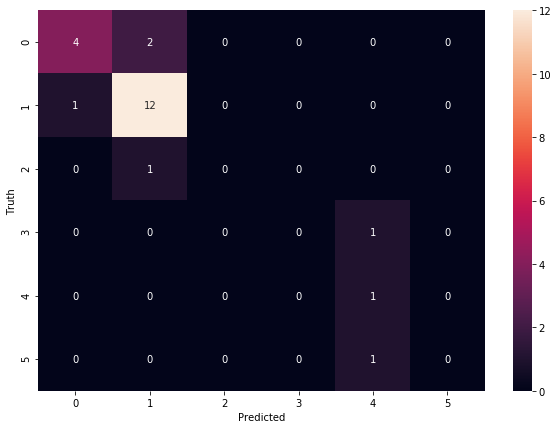

***ACCURACY***

73.91304347826086



***TRAINING ACCURACY***

69.81132075471697




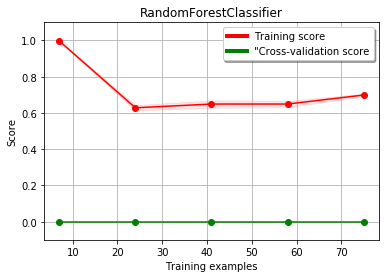

In [11]:
## Performs logistic regression with multi classification
## It predicts the no. of subcascades present with the following accuracy

## Input/s = data (data to perform MLR), test_size (preferably - 0.30 [i.e. 30%]), want_training_accuracy (1 - If YES & 0 - If NO)

## Knowing the training accuracy helps to know whether our model overfits, underfits or bestfits
## If the train accuracy is way more than testing accuracy (i.e. normal accuracy) => overfits
## If the train accuracy & the testing accuracy (i.e. normal accuracy) both are way less => underfits
## If the train accuracy is somewhat same (upto 1% - 5% diff.) as testing accuracy (i.e. normal accuracy) => bestfits

MLR(data, 0.30, 1)

#_Multi Logistic Regression with PCA_

Shape of Independent variable
(76, 6)

Explained Variance Ratio
[0.68238084 0.12602696]

Components of PCA
[[ 0.45998138  0.44366199 -0.32413717  0.41074027  0.43983782  0.35263492]
 [-0.07450007 -0.04346835  0.71217395 -0.09716709  0.21064695  0.6569284 ]]

Shape of Scaled Independent variable
(76, 6)

Shape of PCA Independent variable
(76, 2)



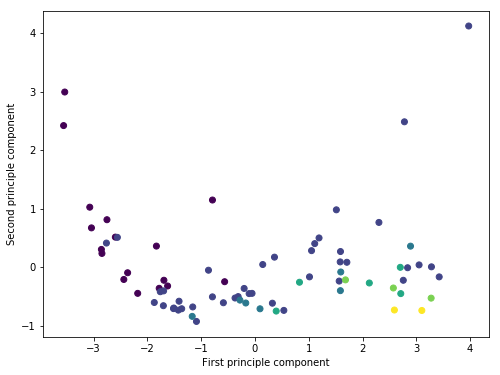

***CLASSIFICATION REPORT***

              precision    recall  f1-score   support

           1       0.83      0.83      0.83         6
           2       0.71      0.92      0.80        13
           3       0.00      0.00      0.00         1
           4       0.00      0.00      0.00         1
           5       0.00      0.00      0.00         1
           6       0.00      0.00      0.00         1

   micro avg       0.74      0.74      0.74        23
   macro avg       0.26      0.29      0.27        23
weighted avg       0.62      0.74      0.67        23



***CONFUSION MATRIX***

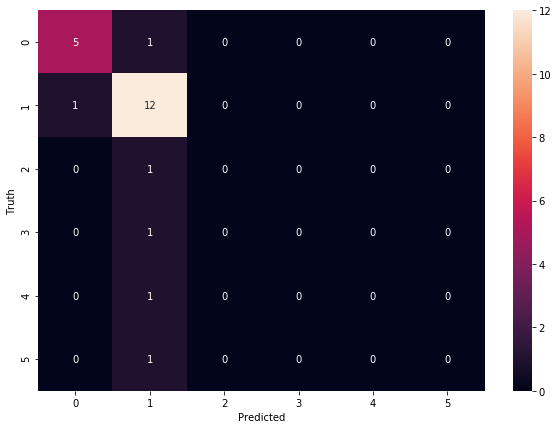

***ACCURACY***

73.91304347826086



***TRAINING ACCURACY***

67.9245283018868




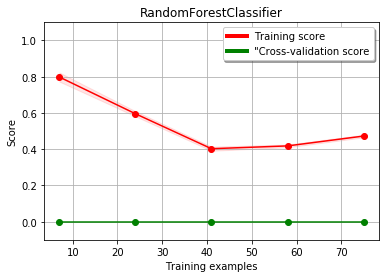

In [12]:
## Performs logistic regression with multi classification
## It predicts the no. of subcascades present with the following accuracy

## Input/s = data (data to perform MLR_PCA), no. of pca_components(preferably - 2), test_size (preferably - 0.30 [i.e. 30%]), want_training_accuracy (1 - If YES & 0 - If NO)

## Knowing the training accuracy helps to know whether our model overfits, underfits or bestfits
## If the train accuracy is way more than testing accuracy (i.e. normal accuracy) => overfits
## If the train accuracy & the testing accuracy (i.e. normal accuracy) both are way less => underfits
## If the train accuracy is somewhat same (upto 1% - 5% diff.) as testing accuracy (i.e. normal accuracy) => bestfits

MLR_PCA(data, 2, 0.30, 1)

#_Multi Logistic Regression with only multiple subcascades (i.e. subcascades__count > 1)_

###_MLR__MSC correlation data_

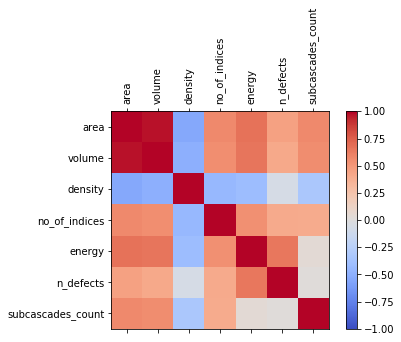

,area,volume,density,no_of_indices,energy,n_defects,subcascades_count
area,1.000000,0.975621,-0.540672,0.575295,0.673061,0.453780,0.576091
volume,0.975621,1.000000,-0.497519,0.547718,0.661323,0.419290,0.558304
density,-0.540672,-0.497519,1.000000,-0.439419,-0.405401,-0.058125,-0.327996
no_of_indices,0.575295,0.547718,-0.439419,1.000000,0.541972,0.408883,0.399993
energy,0.673061,0.661323,-0.405401,0.541972,1.000000,0.649375,0.041466
n_defects,0.453780,0.419290,-0.058125,0.408883,0.649375,1.000000,0.020970
subcascades_count,0.576091,0.558304,-0.327996,0.399993,0.041466,0.020970,1.000000


In [13]:
## Generates data & stores it in MLR_MSC_data variable for data (cascades) who has only multiple subcascade i.e. subcascade_count > 1 from given data file. 
## Generates a correlation graph and table from the abv. data var. MLR_MSC_data
## For better understanding of correlations and also for better prediction
## Input/s = data file
MLR_MSC_data = MLR_multiple_subcascade_corr("cascades-data-full.json")
## For correlation table
MLR_MSC_data.corr()


###_Understanding & visualizing the MLR__MSC data_

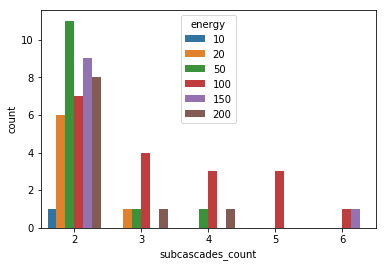

In [13]:
## Plots histogram for multiple no. of subcascades (where subcascades_count > 1) acc. to energy
## You can customize the plot by changing 'x' and 'hue' values
import seaborn as sns
%matplotlib inline
sns.countplot(x='subcascades_count', hue='energy', data=MLR_MSC_data);


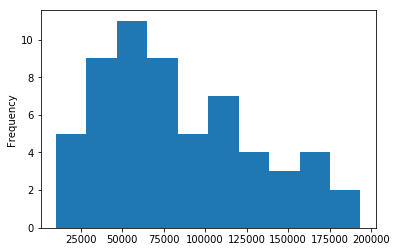

In [25]:
## Plots histogram of area (a column in csv file)
## You can customize the plot by changing the column name in data[] to any column name in the csv file. 
## Can also change the no. of bins for better visualization.
%matplotlib inline
MLR_MSC_data['area'].plot.hist(bins=10);

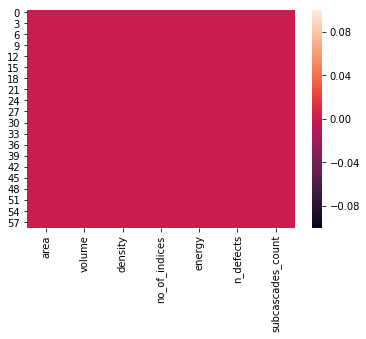

In [31]:
## Check for null values in the csv file
## Views the presence of null value with dark color from the color bar
%matplotlib inline
sns.heatmap(MLR_MSC_data.isnull());

###_Multi Logistic Regression for MLR__MSC data_

***CLASSIFICATION REPORT***

              precision    recall  f1-score   support

           2       0.82      1.00      0.90        14
           3       0.00      0.00      0.00         3
           4       0.00      0.00      0.00         0
           6       0.00      0.00      0.00         1

   micro avg       0.78      0.78      0.78        18
   macro avg       0.21      0.25      0.23        18
weighted avg       0.64      0.78      0.70        18



***CONFUSION MATRIX***

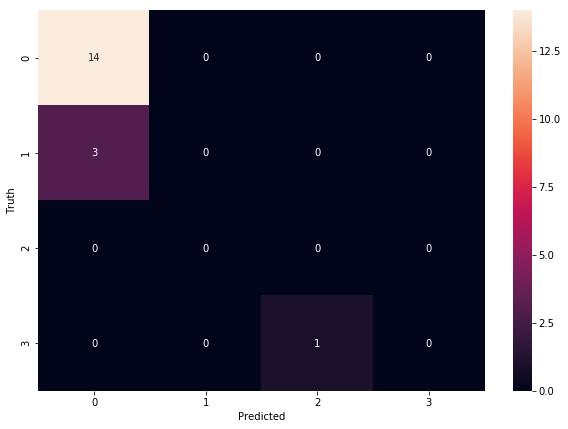

***ACCURACY***

77.77777777777779



***TRAINING ACCURACY***

80.48780487804879




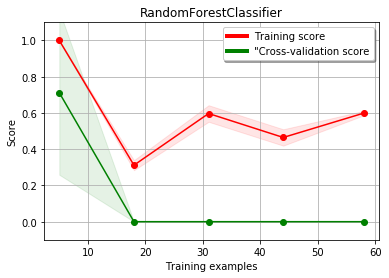

In [14]:
## Performs logistic regression with multi classification
## It predicts the no. of subcascades for only multiple subcascades with the following accuracy

## Input/s = test_size (preferably - 0.30 [i.e. 30%]), want_training_accuracy (1 - If YES & 0 - If NO)

## Knowing the training accuracy helps to know whether our model overfits, underfits or bestfits
## If the train accuracy is way more than testing accuracy (i.e. normal accuracy) => overfits
## If the train accuracy & the testing accuracy (i.e. normal accuracy) both are way less => underfits
## If the train accuracy is somewhat same (upto 1% - 5% diff.) as testing accuracy (i.e. normal accuracy) => bestfits
#data = MLR_MSC_data
MLR(MLR_MSC_data, 0.30, 1)

###_Multi Logistic Regression with PCA for MLR__MSC data_

Shape of Independent variable
(59, 6)

Explained Variance Ratio
[0.61623414 0.16766667]

Components of PCA
[[-0.48020897 -0.46910644  0.31875188 -0.38698355 -0.43869714 -0.32484502]
 [-0.1297196  -0.12814874  0.64099355 -0.03627692  0.26005549  0.69780594]]

Shape of Scaled Independent variable
(59, 6)

Shape of PCA Independent variable
(59, 2)



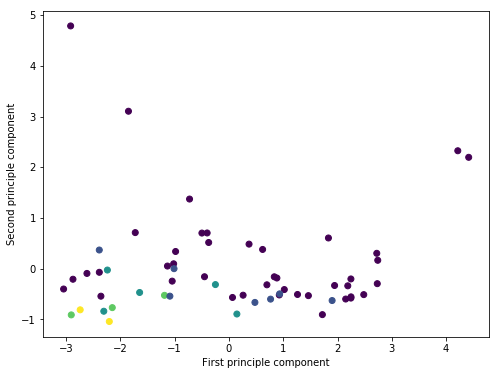

***CLASSIFICATION REPORT***

              precision    recall  f1-score   support

           2       0.93      1.00      0.96        13
           3       0.00      0.00      0.00         1
           4       0.00      0.00      0.00         0
           6       0.00      0.00      0.00         1

   micro avg       0.87      0.87      0.87        15
   macro avg       0.23      0.25      0.24        15
weighted avg       0.80      0.87      0.83        15



***CONFUSION MATRIX***

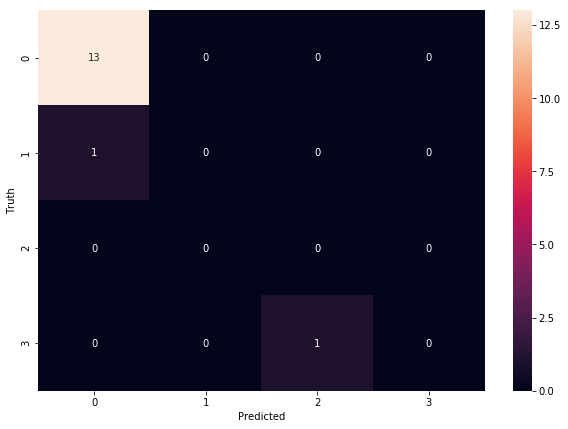

***ACCURACY***

86.66666666666667



***TRAINING ACCURACY***

65.9090909090909




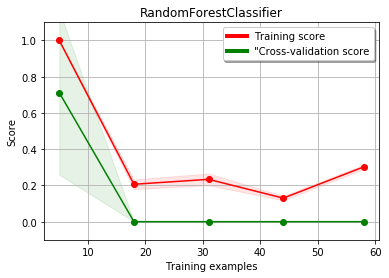

In [15]:
## Performs logistic regression with multi classification
## It predicts the no. of subcascades present with the following accuracy

## Input/s = data (data to perform MLR_PCA), no. of pca_components(preferably - 2), test_size (preferably - 0.30 [i.e. 30%]), want_training_accuracy (1 - If YES & 0 - If NO)

## Knowing the training accuracy helps to know whether our model overfits, underfits or bestfits
## If the train accuracy is way more than testing accuracy (i.e. normal accuracy) => overfits
## If the train accuracy & the testing accuracy (i.e. normal accuracy) both are way less => underfits
## If the train accuracy is somewhat same (upto 1% - 5% diff.) as testing accuracy (i.e. normal accuracy) => bestfits

MLR_PCA(MLR_MSC_data, 2, 0.25, 1)

#_Multi Logistic Regression TRAINING ON FILE-1 & TESTING ON FILE-2_

###_Generates and reads training file's csv file_

In [2]:
## The training file should be such that it contains same "SUBSTRATE / ELEMENT" for all its cascades
## Input/s = data file
train_data = training_file_data_generation("cascades (to check - 300c 5, 10 & 20keV).json")
## Displays first 5 rows of the already read csv file
## You can see more no. of rows by placing the desired no. in the round brackets of the below head function
train_data.head()

Training data file contains only one substrate i.e. 'Fe'



,area,volume,density,no_of_indices,energy,n_defects,subcascades_count
0,3910.622997,13121.783092,0.001600,12,10,21,1
1,1948.106645,4786.330661,0.003343,9,10,16,1
2,1603.531865,4532.556643,0.002427,8,10,11,1
3,2885.939272,8339.334747,0.001919,6,10,16,1
4,1700.557866,4227.087278,0.003075,12,10,13,1


###_Understanding & visualizing the data in the training file_

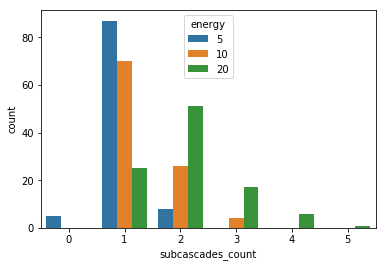

In [5]:
## Plots histogram for multiple no. of subcascades acc. to energy
## You can customize the plot by changing 'x' and 'hue' values
import seaborn as sns
%matplotlib inline
sns.countplot(x='subcascades_count', hue='energy', data=train_data);


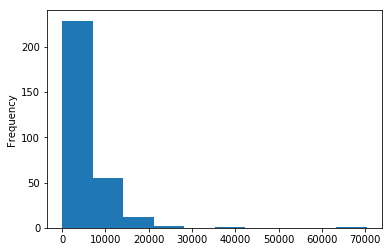

In [6]:
## Plots histogram of area (a column in csv file)
## You can customize the plot by changing the column name in data[] to any column name in the csv file. 
## Can also change the no. of bins for better visualization.
%matplotlib inline
train_data['area'].plot.hist(bins=10);

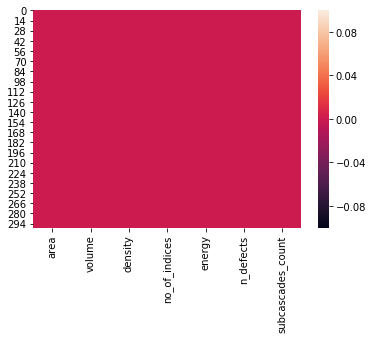

In [7]:
## Check for null values in the csv file
## Views the presence of null value with dark color from the color bar
%matplotlib inline
sns.heatmap(train_data.isnull());

###_Generates and reads testing file's csv file_

In [3]:
## The testing file should be such that it contains minimum no. of same "SUBSTRATE / ELEMENT" as that of training file 
## Input/s = data file
test_data = testing_file_data_generation("cascades-data-full.json")
## Displays first 5 rows of the already read csv file
## You can see more no. of rows by placing the desired no. in the round brackets of the below head function
test_data.head()

,area,volume,density,no_of_indices,energy,n_defects,subcascades_count
0,5212.784439,23576.863259,0.001060,14,10,25,1
1,2236.095863,5287.458304,0.003404,12,10,18,1
2,2878.218978,8675.844401,0.002190,10,10,19,1
3,2143.896493,6465.513471,0.002784,10,10,18,1
4,3518.941546,8289.725985,0.002413,12,10,20,2


###_Understanding & visualizing the data in the testing file_

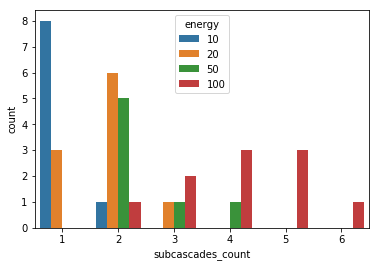

In [9]:
## Plots histogram for multiple no. of subcascades acc. to energy
## You can customize the plot by changing 'x' and 'hue' values
import seaborn as sns
%matplotlib inline
sns.countplot(x='subcascades_count', hue='energy', data=test_data);


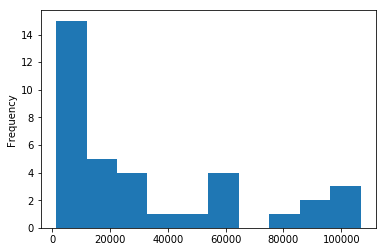

In [10]:
## Plots histogram of area (a column in csv file)
## You can customize the plot by changing the column name in data[] to any column name in the csv file. 
## Can also change the no. of bins for better visualization.
%matplotlib inline
test_data['area'].plot.hist(bins=10);

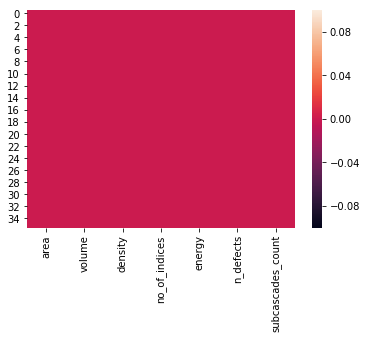

In [11]:
## Check for null values in the csv file
## Views the presence of null value with dark color from the color bar
%matplotlib inline
sns.heatmap(test_data.isnull());

###Multi Logistic Regression for train on F1 & test on F2_

***CLASSIFICATION REPORT***

              precision    recall  f1-score   support

           1       0.75      1.00      0.86         6
           2       0.88      0.64      0.74        11
           3       0.23      0.75      0.35         4
           4       0.00      0.00      0.00         4
           5       0.00      0.00      0.00         3
           6       0.00      0.00      0.00         1

   micro avg       0.55      0.55      0.55        29
   macro avg       0.31      0.40      0.32        29
weighted avg       0.52      0.55      0.51        29



***CONFUSION MATRIX***

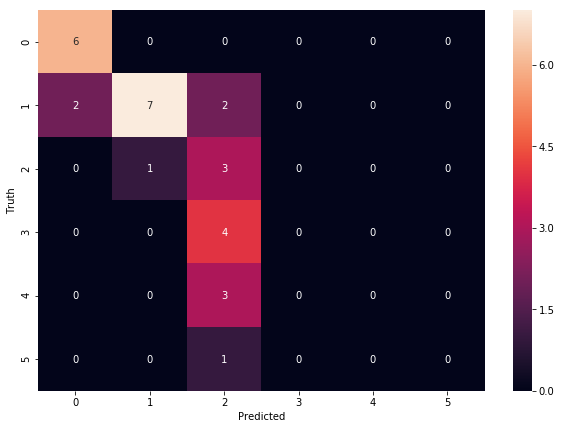

***ACCURACY***

55.172413793103445



***TRAINING ACCURACY***

78.14814814814814


In [29]:
## Trains on data-1 & tests on data-2 which were created in previous steps - Generates and reads training/testing file's csv file
## Input/s = train data, test_data, test size for testing test_data (preferably - 0.70 [i.e. 70%])
## The default test size for train_data is 0.10 => train size is 90% [We will be training the model with most of the given data]
## The test size for test_data is 0.70 [There will be very good no. of cases to predict]
MLR_train_on_file1_and_test_on_file2(train_data, test_data, 0.70) ## Best at 0.80

###_Multi Logistic Regression with PCA for train on F1 & test on F2_

Shape of Training_data Independent variable
(300, 6)

Explained Variance Ratio of Training_data 
[0.6532116  0.16112413]

Training_data Components of PCA
[[ 0.44644103  0.43708781 -0.16642124  0.40831611  0.43935482  0.47137451]
 [ 0.27720735  0.30961598  0.89126739 -0.16936139 -0.0507288  -0.04098515]]

Shape of Training_data Scaled Independent variable
(300, 6)

Shape of Training_data PCA Independent variable
(300, 2)



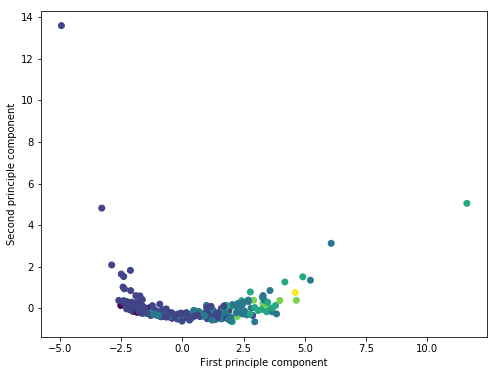

***CLASSIFICATION REPORT***

              precision    recall  f1-score   support

           1       0.50      1.00      0.67         2
           2       0.29      0.50      0.36         4
           3       0.00      0.00      0.00         1
           4       0.00      0.00      0.00         2
           5       0.00      0.00      0.00         1
           6       0.00      0.00      0.00         1

   micro avg       0.36      0.36      0.36        11
   macro avg       0.13      0.25      0.17        11
weighted avg       0.19      0.36      0.25        11



***CONFUSION MATRIX***

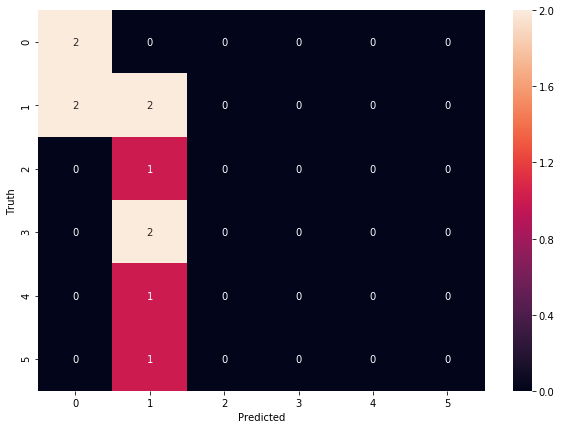

***ACCURACY***

36.36363636363637



***TRAINING ACCURACY***

74.07407407407408


In [41]:
## Trains on data-1 & tests on data-2 which were created in previous steps - Generates and reads training/testing file's csv file
## Input/s = train data, test_data, test size for testing test_data (preferably - 0.70 [i.e. 70%])
## The default test size for train_data is 0.10 => train size is 90% [We will be training the model with most of the given data]
## The test size for test_data is 0.70 [There will be very good no. of cases to predict]
MLR_PCA_train_on_file1_and_test_on_file2(train_data, test_data, 2, 0.3) #### Shows good result at 0.2 i.e. low test_size for test_data

#_Multi Logistic Regression with only multiple subcascades (i.e. subcascades__count > 1) TRAINING ON FILE-1 & TESTING ON FILE-2_

###_Generates and reads training file's csv file_

In [4]:
## The training file should be such that it contains same "SUBSTRATE / ELEMENT" for all its cascades
## Input/s = data file
MSC_train_data = MSC_training_file_data_generation("cascades (to check - 300c 5, 10 & 20keV).json")
## Displays first 5 rows of the already read csv file
## You can see more no. of rows by placing the desired no. in the round brackets of the below head function
MSC_train_data.head()

Training data file contains only one substrate i.e. 'Fe'



,area,volume,density,no_of_indices,energy,n_defects,subcascades_count
0,8153.139194,23416.943270,0.001495,14,10,35,3
1,2143.200524,3080.373627,0.003571,9,10,11,2
2,7107.047280,29046.409466,0.000895,13,10,26,3
3,3698.507988,12851.450088,0.001712,11,10,22,2
4,2908.543603,9934.904423,0.002013,14,10,20,2


###_Understanding & visualizing the data in the training file_

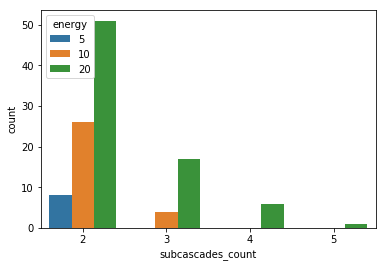

In [57]:
## Plots histogram for multiple no. of subcascades acc. to energy
## You can customize the plot by changing 'x' and 'hue' values
import seaborn as sns
%matplotlib inline
sns.countplot(x='subcascades_count', hue='energy', data=MSC_train_data);


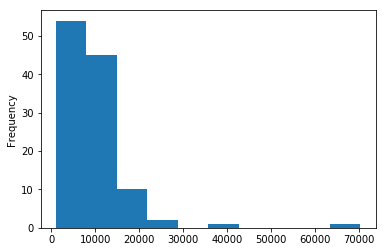

In [58]:
## Plots histogram of area (a column in csv file)
## You can customize the plot by changing the column name in data[] to any column name in the csv file. 
## Can also change the no. of bins for better visualization.
%matplotlib inline
MSC_train_data['area'].plot.hist(bins=10);

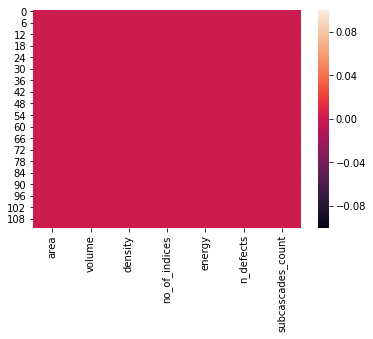

In [59]:
## Check for null values in the csv file
## Views the presence of null value with dark color from the color bar
%matplotlib inline
sns.heatmap(MSC_train_data.isnull());

###_Generates and reads testing file's csv file_

In [5]:
## The testing file should be such that it contains minimum no. of same "SUBSTRATE / ELEMENT" as that of training file 
## Input/s = data file
MSC_test_data = MSC_testing_file_data_generation("cascades-data-full.json")
## Displays first 5 rows of the already read csv file
## You can see more no. of rows by placing the desired no. in the round brackets of the below head function
MSC_test_data

,area,volume,density,no_of_indices,energy,n_defects,subcascades_count
0,3518.941546,8.289726e+03,0.002413,12,10,20,2
1,4980.049849,1.398694e+04,0.002431,13,20,34,2
2,8763.278571,4.103887e+04,0.001048,18,20,43,2
3,15496.516564,1.155243e+05,0.000459,13,20,53,2
4,10230.390906,5.282139e+04,0.000928,16,20,49,2
5,12180.462848,6.806716e+04,0.000632,20,20,43,2
6,12939.132044,6.264180e+04,0.000639,13,20,40,2
7,14169.550050,1.050183e+05,0.000438,21,20,46,3
8,33397.810163,3.420632e+05,0.000286,14,50,98,2
9,24838.176314,2.663194e+05,0.000330,20,50,88,2


###_Understanding & visualizing the data in the testing file_

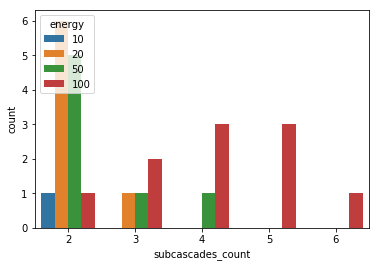

In [7]:
## Plots histogram for multiple no. of subcascades acc. to energy
## You can customize the plot by changing 'x' and 'hue' values
import seaborn as sns
%matplotlib inline
sns.countplot(x='subcascades_count', hue='energy', data=MSC_test_data);

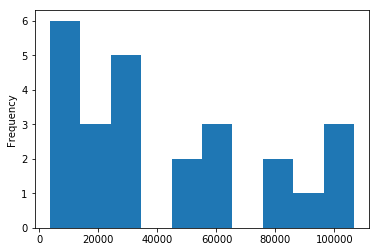

In [8]:
## Plots histogram of area (a column in csv file)
## You can customize the plot by changing the column name in data[] to any column name in the csv file. 
## Can also change the no. of bins for better visualization.
%matplotlib inline
MSC_test_data['area'].plot.hist(bins=10);

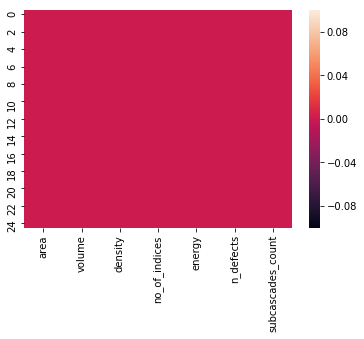

In [9]:
## Check for null values in the csv file
## Views the presence of null value with dark color from the color bar
%matplotlib inline
sns.heatmap(MSC_test_data.isnull());

###_Multi Logistic Regression (MSC) for train on F1 & test on F2_

***CLASSIFICATION REPORT***

              precision    recall  f1-score   support

           2       0.44      1.00      0.62         8
           3       0.00      0.00      0.00         4
           4       0.00      0.00      0.00         3
           5       0.00      0.00      0.00         2
           6       0.00      0.00      0.00         1

   micro avg       0.44      0.44      0.44        18
   macro avg       0.09      0.20      0.12        18
weighted avg       0.20      0.44      0.27        18



***CONFUSION MATRIX***

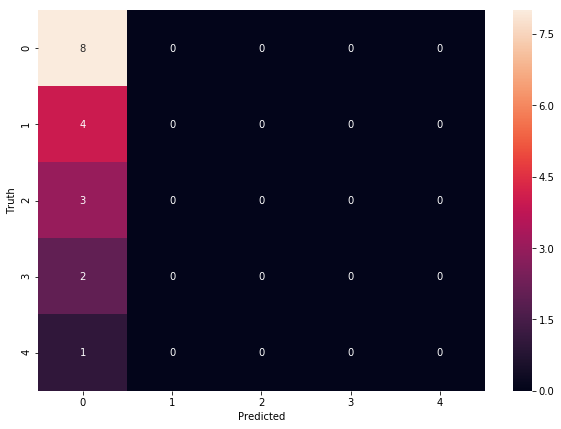

***ACCURACY***

44.44444444444444



***TRAINING ACCURACY***

77.22772277227723


In [20]:
## Trains on data-1 & tests on data-2 which were created in previous steps - Generates and reads training/testing file's csv file
## Input/s = train data, test_data, test size for testing test_data (preferably - 0.70 [i.e. 70%])
## The default test size for train_data is 0.10 => train size is 90% [We will be training the model with most of the given data]
## The test size for test_data is 0.70 [There will be very good no. of cases to predict]
MLR_train_on_file1_and_test_on_file2(MSC_train_data, MSC_test_data, 0.7) ## Best at 0.90

###_Multi Logistic Regression (MSC) with PCA for train on F1 & test on F2_

Shape of Training_data Independent variable
(113, 6)

Explained Variance Ratio of Training_data 
[0.63404482 0.17691795]

Training_data Components of PCA
[[ 0.42132359  0.42466704 -0.40794028  0.30501003  0.42303968  0.45137056]
 [ 0.51145408  0.51546373  0.08324074 -0.57272487 -0.29907119 -0.21983062]]

Shape of Training_data Scaled Independent variable
(113, 6)

Shape of Training_data PCA Independent variable
(113, 2)



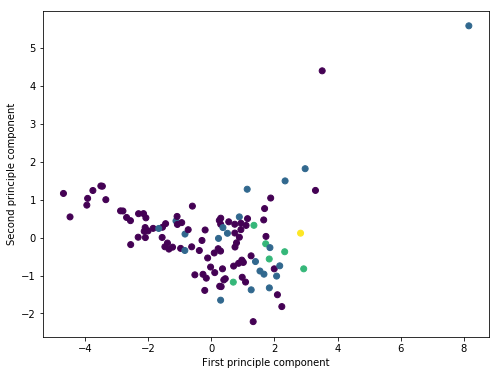

***CLASSIFICATION REPORT***

              precision    recall  f1-score   support

           2       0.38      0.75      0.50         8
           3       0.00      0.00      0.00         4
           4       0.00      0.00      0.00         3
           5       0.00      0.00      0.00         2
           6       0.00      0.00      0.00         1

   micro avg       0.33      0.33      0.33        18
   macro avg       0.07      0.15      0.10        18
weighted avg       0.17      0.33      0.22        18



***CONFUSION MATRIX***

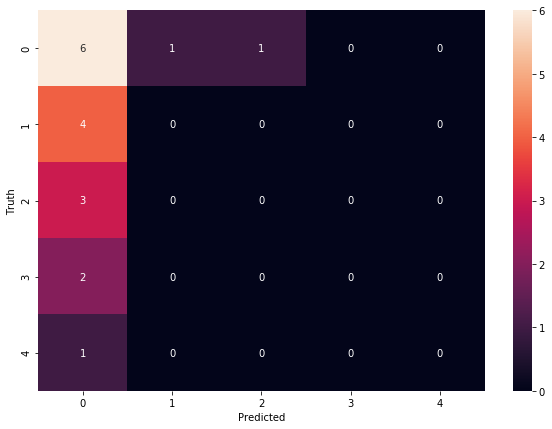

***ACCURACY***

33.33333333333333



***TRAINING ACCURACY***

76.23762376237624


In [34]:
## Trains on data-1 & tests on data-2 which were created in previous steps - Generates and reads training/testing file's csv file
## Input/s = train data, test_data, test size for testing test_data (preferably - 0.70 [i.e. 70%])
## The default test size for train_data is 0.10 => train size is 90% [We will be training the model with most of the given data]
## The test size for test_data is 0.70 [There will be very good no. of cases to predict]
MLR_PCA_train_on_file1_and_test_on_file2(MSC_train_data, MSC_test_data, 2, 0.7) #### Shows good result at 0.95 i.e. low test_size for test_data
